<a href="https://colab.research.google.com/github/tianrengao/Cropping-Script/blob/master/new_Bon_Skyon_Vol_1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


# import packages and set directory



In [0]:
# acqure the authorization of the google drive, so that we could read from it and save cropped images to it
import os
from google.colab import drive
drive.mount('/content/gdrive')
os.chdir("/content/gdrive/My Drive/Kurt's/Tibetan-Cropping/Bon-Skyon-Vol-1") #Change the path to the directory that contains all code and data

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


In [0]:
# Create a diretory to save cropped images
!mkdir  ../../Tibetan-Cropped/Bon-Skyon-Vol-1
# Create list.txt that contains the list of images to be cropped
!touch list.txt
!ls *.jpg > list.txt

mkdir: cannot create directory ‘../../Tibetan-Cropped/Bon-Skyon-Vol-1’: File exists


In [0]:
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image
from scipy.cluster.vq import whiten
import cv2 as cv

## Input your image information

In [0]:
# output path
path = "../../Tibetan-Cropped/Bon-Skyon-Vol-1"
image_list = [] # all the images to be cropped
failed_list = [] # if any cropping fails, add it to failed_list for later cropping
# add all the cropping images to the image_list
with open("list.txt","r") as f:
  for image_name in f:
    name = image_name[:-1]
    image_list.append(name)

image_list = sorted(image_list)
print(image_list)


# hyperparameters
threshold = 1.5
rows = 30
tol = 150 # the cropped image should has height larger than tol, 
          # otherwise, we decline this cropping and move on to the next cropping
mean_height = 550


  # img = cv.imread(image_name)
  # # dst = cv.fastNlMeansDenoisingColored(img,None,10,10,7,21)
  # im = Image.fromarray(img)
  # print(im.size)

['10.jpg', '100 (2).jpg', '102(2).jpg', '102.jpg', '103.jpg', '104 (2).jpg', '105.jpg', '106 (2).jpg', '107.jpg', '108 (2).jpg', '109.jpg', '11.jpg', '110 (2).jpg', '111.jpg', '112 (2).jpg', '113.jpg', '114 (2).jpg', '115.jpg', '116 (2).jpg', '117.jpg', '118 (2).jpg', '119.jpg', '12.jpg', '120 (2).jpg', '121.jpg', '122 (2).jpg', '123.jpg', '124 (2).jpg', '125.jpg', '126 (2).jpg', '127.jpg', '128 (2).jpg', '129.jpg', '13.jpg', '130 (2).jpg', '131.jpg', '132 (2).jpg', '133.jpg', '134 (2).jpg', '135.jpg', '136 (2).jpg', '137.jpg', '138 (2).jpg', '139.jpg', '14.jpg', '140 (2).jpg', '141.jpg', '142 (2).jpg', '143.jpg', '144 (2).jpg', '145.jpg', '146 (2).jpg', '147.jpg', '148 (2).jpg', '149.jpg', '15.jpg', '150 (2).jpg', '151.jpg', '152 (2).jpg', '153.jpg', '154 (2).jpg', '155.jpg', '156.jpg', '157.jpg', '16.jpg', '17.jpg', '18.jpg', '19.jpg', '20.jpg', '21.jpg', '22.jpg', '23.jpg', '24.jpg', '25.jpg', '26.jpg', '27.jpg', '28.jpg', '29.jpg', '30.jpg', '31.jpg', '32.jpg', '33.jpg', '34 .jpg',

## crop funcion

In [0]:
def cut_image(im, bound, image_name, image_index):
  # crop and print the cropped image
  print(bound)
  new_image = im.crop(bound)
  plt.imshow(new_image)
  plt.title("cut")
  plt.show()
  # save the image
  try:
    if not os.path.exists(path):
      os.mkdir(path)
      print("Created directory", path)
    output_path = os.path.join(path, image_name+"-%s.jpg" % image_index)
    new_image.save(output_path)
    print("Saved Image as", output_path, "!!!")
    return True
  except:
    if image_name not in failed_list:
      failed_list.append(image_name)
    print("ERROR: check your path")
    return False

def find_bound(image, img, threshold):
  bound_list = []
  height = len(image) 
  width = len(image[0]) 
  # border of next cutting
  left, upper, right, lower = 0, 0, width, 0 
  start = False # This indicates if we have started a new cropping. 

  # Compute the mean of each row
  mean_list = []
  plt.imshow(image)
  plt.title("before")
  plt.show()
  img_1 = img.crop((200, 0, width-200, height)) 
  img_1 = np.array(img_1)

  thresh_num_list = {}
  thresh_total_list = {}
  for i in range(len(image)):
    mean_temp = 255 - np.mean(img_1[i][0:-20], axis=0)
    mean_list.append(mean_temp)
    if np.logical_and(1 < mean_temp, mean_temp < 5):
      if int(mean_temp) not in thresh_num_list:
        thresh_num_list[int(mean_temp)] = 1
        thresh_total_list[int(mean_temp)] = mean_temp
      else: 
        thresh_num_list[int(mean_temp)] += 1
        thresh_total_list[int(mean_temp)] += mean_temp

  print(thresh_num_list)
  mean_key = min(thresh_num_list, key = thresh_num_list.get) 
  if not threshold:
    threshold = thresh_total_list[mean_key] / thresh_num_list[mean_key]
    print("threshold", threshold)

  # mean_avg = np.mean(mean_list)
  # mean_std = np.std(mean_list)
  # print(mean_avg, mean_std)
  
  # Computer the average of i-th to (i + rows)-th rows
  # if the average is greater than the threshold, then they are characters; otherwise, white space
  for i in range(len(image))[rows:-rows]:
    avg = np.mean(mean_list[i-rows:i+rows]) # compute the average of rows
    # print(i, avg)
    if avg > threshold and not start:
      # We find characters, so we start a new cutting here
      # initalize the upper and lower, and set start to True
      upper, lower = i, i
      start = True
    elif (avg <= threshold or i + rows == height - 1) and start:
      # If we find a white space, we crop the image. If we reach the bottom of the image, we also crop the image.
      # Cut the image using left, upper, right and lower, and also set the start to False
      start = False
      if lower - upper < tol or lower < 10:  
        continue
      bound = [left, upper, right, lower]
      print(bound)
      bound_list.append(bound)
    elif avg > threshold and start:
      # We find characters, and the cropping has started, then we increase the lower, we move to the next row
      lower += 1
  # TODO: compute mean and replace 50.0 
  return adjust_bound(bound_list, height)

def adjust_bound(bound_list, height):
  if len(bound_list) <= 1:
    return bound_list

  border_total = 0
  num = 0
  for i in range(len(bound_list) - 1):
    diff = bound_list[i + 1][1] - bound_list[i][3]
    if diff < 150:
      border_total += diff
      num += 1
  if num > 0:
    border = border_total / num
  else:
    border = 100.0

  border = border * 2 / 3

  for i in range(len(bound_list) - 1):
    prev = bound_list[i]
    curr = bound_list[i + 1]
    prev[3] = prev[3] + border
    curr[1] = curr[1] - border
  bound_list[-1][3] = min(bound_list[-1][3] + border, float(height - 1))
  
  if bound_list[0] !=0 and (bound_list[0][3] - bound_list[0][1]) < mean_height:
    bound_list[0][1] -= (mean_height - (bound_list[0][3] - bound_list[0][1]))
    bound_list[0][1] = max(0, bound_list[0][1])

  return bound_list

def crop(im, image_name, hard_code):
  # check input
  print("Processing", image_name)
  if im == None:
    print("ERROR: image cannot be None")
    return
  image_index = 0 

  # preprocessing of input images
  image = np.array(im)
  whiten(image)
  # find the bound of each piece
  bound_list = find_bound(image, im, hard_code)
  # cut and save
  for bound in bound_list:
    if cut_image(im, bound, image_name, image_index):
      image_index += 1
    
  # fail detect: if an image is cut into less than 3 images,
  # we think something went wrong with the cropping,
  # this condition could be changed according to your demand
  if image_index < 3 and image_name not in failed_list:
    print(image_name, "Failed")
    failed_list.append(image_name)

10.jpg
(3517, 2521)
Processing 10


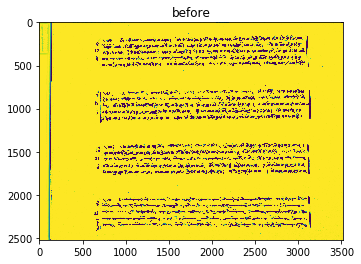

{4: 35, 1: 52, 2: 42, 3: 41}
threshold 4.436062549010562
[0, 147, 3517, 531]
[0, 766, 3517, 1153]
[0, 1385, 3517, 1778]
[0, 2006, 3517, 2392]
[0, 47.66666666666663, 3517, 597.6666666666666]


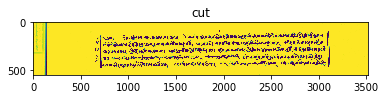

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/10-0.jpg !!!
[0, 699.3333333333334, 3517, 1219.6666666666667]


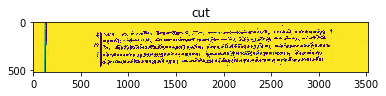

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/10-1.jpg !!!
[0, 1318.3333333333333, 3517, 1844.6666666666667]


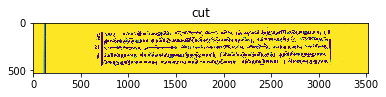

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/10-2.jpg !!!
[0, 1939.3333333333333, 3517, 2458.6666666666665]


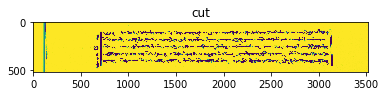

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/10-3.jpg !!!
100 (2).jpg
(3456, 2633)
Processing 100 (2)


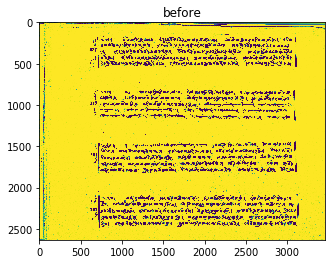

{3: 44, 2: 66, 1: 323, 4: 11}
threshold 4.382231404958676
[0, 163, 3456, 554]
[0, 798, 3456, 1189]
[0, 1438, 3456, 1839]
[0, 2071, 3456, 2492]
[0, 70.66666666666663, 3456, 620.6666666666666]


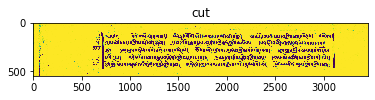

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/100 (2)-0.jpg !!!
[0, 731.3333333333334, 3456, 1255.6666666666667]


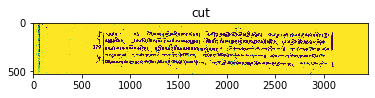

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/100 (2)-1.jpg !!!
[0, 1371.3333333333333, 3456, 1905.6666666666667]


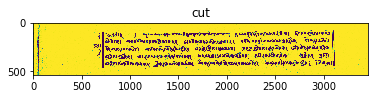

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/100 (2)-2.jpg !!!
[0, 2004.3333333333333, 3456, 2558.6666666666665]


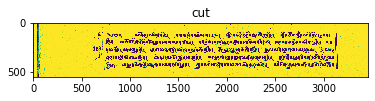

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/100 (2)-3.jpg !!!
102(2).jpg
(3414, 2582)
Processing 102(2)


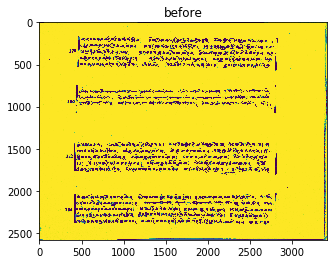

{4: 40, 1: 59, 2: 125, 3: 34}
threshold 3.3966069393689358
[0, 158, 3414, 561]
[0, 771, 3414, 1015]
[0, 1399, 3414, 1803]
[0, 2020, 3414, 2413]
[0, 77.66666666666663, 3414, 627.6666666666666]


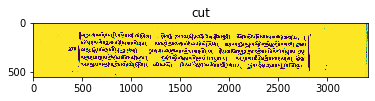

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/102(2)-0.jpg !!!
[0, 704.3333333333334, 3414, 1081.6666666666667]


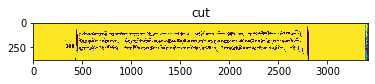

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/102(2)-1.jpg !!!
[0, 1332.3333333333333, 3414, 1869.6666666666667]


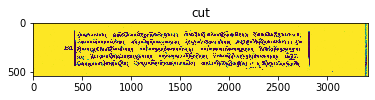

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/102(2)-2.jpg !!!
[0, 1953.3333333333333, 3414, 2479.6666666666665]


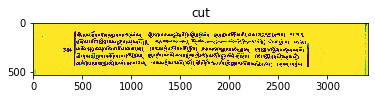

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/102(2)-3.jpg !!!
102.jpg
(3474, 2644)
Processing 102


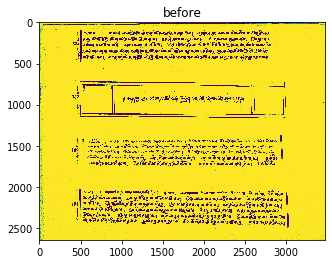

{1: 210, 2: 49, 3: 33, 4: 15}
threshold 4.4891944990176835
[0, 82, 3474, 480]
[0, 696, 3474, 1188]
[0, 1402, 3474, 1767]
[0, 2025, 3474, 2480]
[0, 0, 3474, 546.6666666666666]


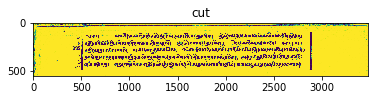

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/102-0.jpg !!!
[0, 629.3333333333334, 3474, 1254.6666666666667]


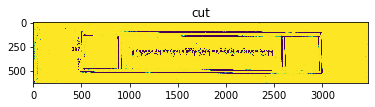

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/102-1.jpg !!!
[0, 1335.3333333333333, 3474, 1833.6666666666667]


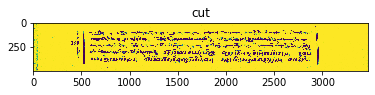

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/102-2.jpg !!!
[0, 1958.3333333333333, 3474, 2546.6666666666665]


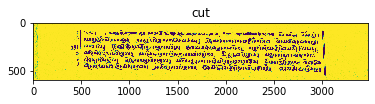

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/102-3.jpg !!!
103.jpg
(3411, 2603)
Processing 103


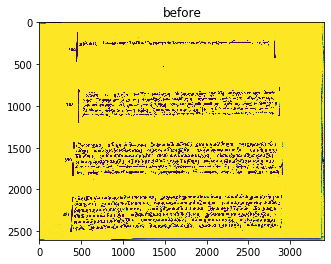

{4: 13, 2: 119, 1: 261, 3: 14}
threshold 4.5918010441581165
[0, 805, 3411, 1141]
[0, 1414, 3411, 1839]
[0, 2045, 3411, 2494]
[0, 657.6666666666667, 3411, 1207.6666666666667]


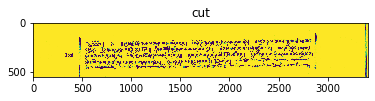

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/103-0.jpg !!!
[0, 1347.3333333333333, 3411, 1905.6666666666667]


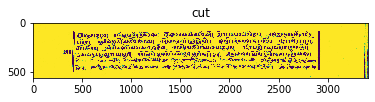

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/103-1.jpg !!!
[0, 1978.3333333333333, 3411, 2560.6666666666665]


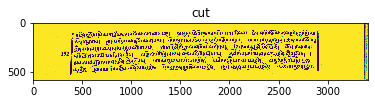

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/103-2.jpg !!!
104 (2).jpg
(3527, 2636)
Processing 104 (2)


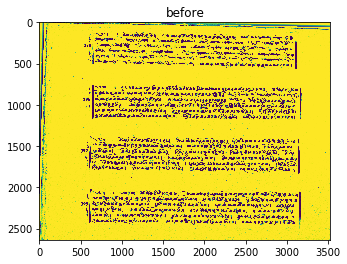

{4: 18, 2: 81, 1: 215, 3: 29}
threshold 4.50219933483532
[0, 113, 3527, 558]
[0, 754, 3527, 1192]
[0, 1381, 3527, 1828]
[0, 2023, 3527, 2469]
[0, 74.66666666666663, 3527, 624.6666666666666]


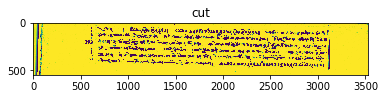

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/104 (2)-0.jpg !!!
[0, 687.3333333333334, 3527, 1258.6666666666667]


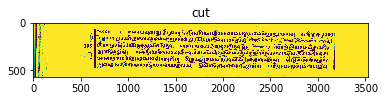

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/104 (2)-1.jpg !!!
[0, 1314.3333333333333, 3527, 1894.6666666666667]


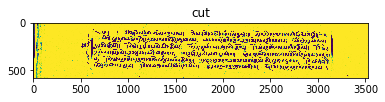

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/104 (2)-2.jpg !!!
[0, 1956.3333333333333, 3527, 2535.6666666666665]


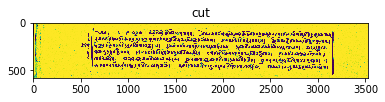

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/104 (2)-3.jpg !!!
105.jpg
(3409, 2601)
Processing 105


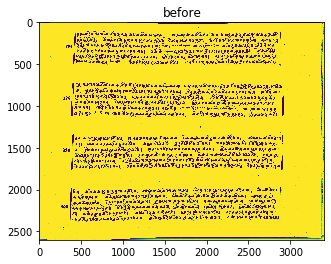

{2: 11, 3: 7, 1: 15, 4: 7}
threshold 3.474358361611625
[0, 99, 3409, 528]
[0, 705, 3409, 1153]
[0, 1333, 3409, 1769]
[0, 1963, 3409, 2394]
[0, 44.66666666666663, 3409, 594.6666666666666]


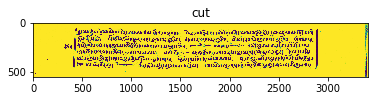

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/105-0.jpg !!!
[0, 638.3333333333334, 3409, 1219.6666666666667]


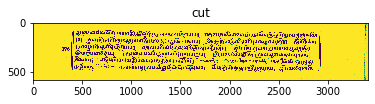

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/105-1.jpg !!!
[0, 1266.3333333333333, 3409, 1835.6666666666667]


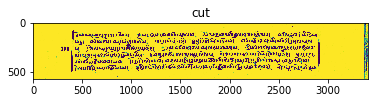

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/105-2.jpg !!!
[0, 1896.3333333333333, 3409, 2460.6666666666665]


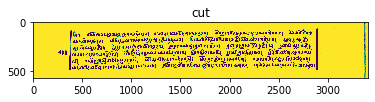

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/105-3.jpg !!!
106 (2).jpg
(3571, 2700)
Processing 106 (2)


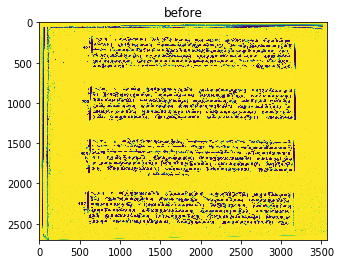

{1: 158, 3: 50, 2: 131, 4: 21}
threshold 4.528600142056187
[0, 174, 3571, 590]
[0, 793, 3571, 1226]
[0, 1436, 3571, 1916]
[0, 2077, 3571, 2530]
[0, 106.66666666666663, 3571, 656.6666666666666]


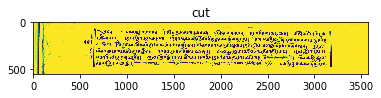

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/106 (2)-0.jpg !!!
[0, 726.3333333333334, 3571, 1292.6666666666667]


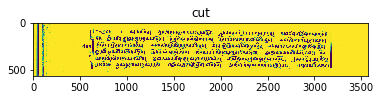

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/106 (2)-1.jpg !!!
[0, 1369.3333333333333, 3571, 1982.6666666666667]


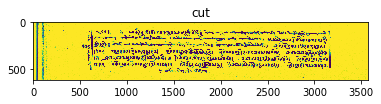

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/106 (2)-2.jpg !!!
[0, 2010.3333333333333, 3571, 2596.6666666666665]


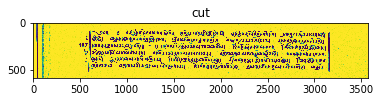

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/106 (2)-3.jpg !!!
107.jpg
(3407, 2621)
Processing 107


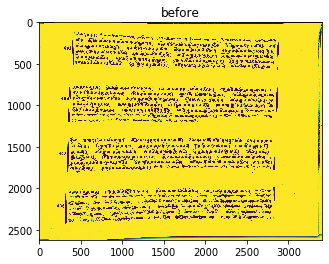

{1: 63, 2: 25, 3: 12, 4: 23}
threshold 3.5482647026001572
[0, 121, 3407, 574]
[0, 748, 3407, 1222]
[0, 1372, 3407, 1806]
[0, 1983, 3407, 2415]
[0, 90.66666666666663, 3407, 640.6666666666666]


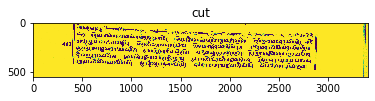

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/107-0.jpg !!!
[0, 681.3333333333334, 3407, 1288.6666666666667]


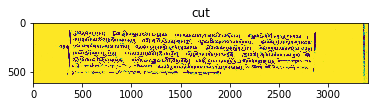

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/107-1.jpg !!!
[0, 1305.3333333333333, 3407, 1872.6666666666667]


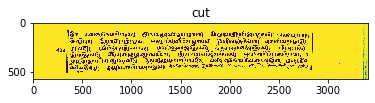

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/107-2.jpg !!!
[0, 1916.3333333333333, 3407, 2481.6666666666665]


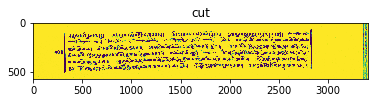

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/107-3.jpg !!!
108 (2).jpg
(3519, 2635)
Processing 108 (2)


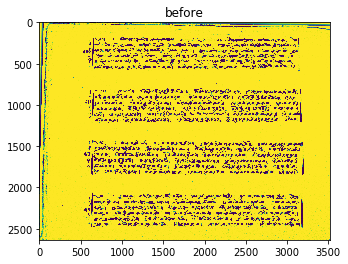

{4: 16, 3: 25, 2: 23, 1: 207}
threshold 4.545740561471444
[0, 172, 3519, 590]
[0, 791, 3519, 1233]
[0, 1420, 3519, 1860]
[0, 2060, 3519, 2493]
[0, 106.66666666666663, 3519, 656.6666666666666]


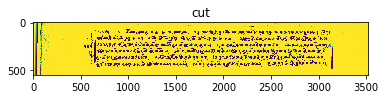

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/108 (2)-0.jpg !!!
[0, 724.3333333333334, 3519, 1299.6666666666667]


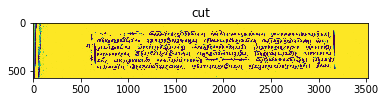

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/108 (2)-1.jpg !!!
[0, 1353.3333333333333, 3519, 1926.6666666666667]


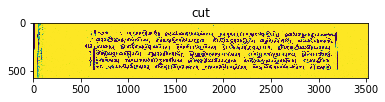

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/108 (2)-2.jpg !!!
[0, 1993.3333333333333, 3519, 2559.6666666666665]


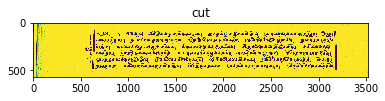

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/108 (2)-3.jpg !!!
109.jpg
(3432, 2555)
Processing 109


/usr/local/lib/python3.6/dist-packages/scipy/cluster/vq.py:139: RuntimeWarning: Some columns have standard deviation zero. The values of these columns will not change.
  RuntimeWarning)


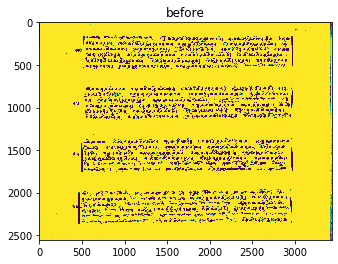

{1: 47, 4: 12, 2: 13, 3: 8}
threshold 3.4077855245683963
[0, 141, 3432, 567]
[0, 729, 3432, 1155]
[0, 1350, 3432, 1771]
[0, 1950, 3432, 2374]
[0, 83.66666666666663, 3432, 633.6666666666666]


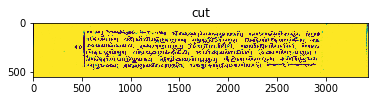

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/109-0.jpg !!!
[0, 662.3333333333334, 3432, 1221.6666666666667]


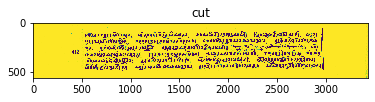

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/109-1.jpg !!!
[0, 1283.3333333333333, 3432, 1837.6666666666667]


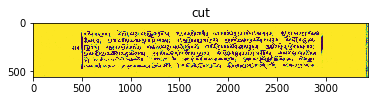

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/109-2.jpg !!!
[0, 1883.3333333333333, 3432, 2440.6666666666665]


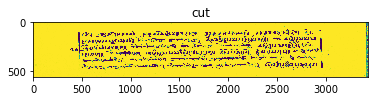

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/109-3.jpg !!!
11.jpg
(3492, 2657)
Processing 11


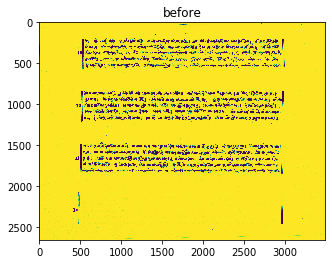

{1: 83, 2: 352, 3: 84, 4: 44}
threshold 4.548021721117424
[0, 185, 3492, 575]
[0, 821, 3492, 1217]
[0, 1469, 3492, 1855]
[0, 91.66666666666663, 3492, 641.6666666666666]


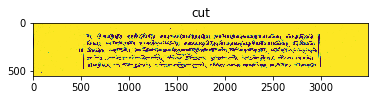

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/11-0.jpg !!!
[0, 754.3333333333334, 3492, 1283.6666666666667]


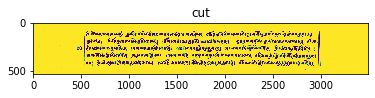

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/11-1.jpg !!!
[0, 1402.3333333333333, 3492, 1921.6666666666667]


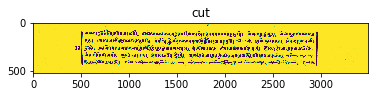

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/11-2.jpg !!!
110 (2).jpg
(3518, 2648)
Processing 110 (2)


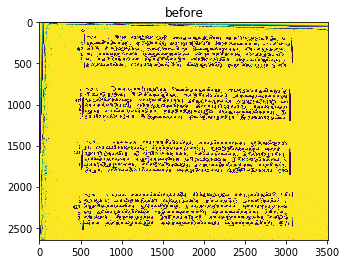

{1: 117, 2: 34, 3: 22, 4: 11}
threshold 4.489758788661305
[0, 145, 3518, 573]
[0, 774, 3518, 1206]
[0, 1418, 3518, 1851]
[0, 2054, 3518, 2498]
[0, 89.66666666666663, 3518, 639.6666666666666]


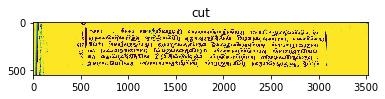

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/110 (2)-0.jpg !!!
[0, 707.3333333333334, 3518, 1272.6666666666667]


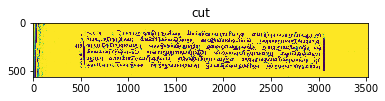

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/110 (2)-1.jpg !!!
[0, 1351.3333333333333, 3518, 1917.6666666666667]


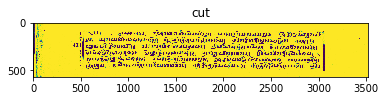

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/110 (2)-2.jpg !!!
[0, 1987.3333333333333, 3518, 2564.6666666666665]


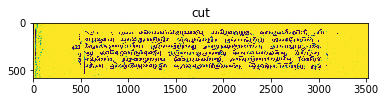

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/110 (2)-3.jpg !!!
111.jpg
(3417, 2607)
Processing 111


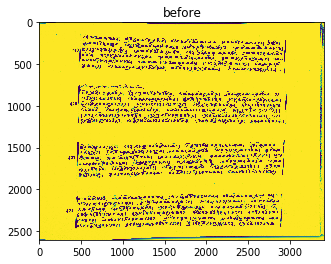

{2: 25, 1: 49, 3: 17, 4: 12}
threshold 4.570681792904016
[0, 157, 3417, 606]
[0, 742, 3417, 1231]
[0, 1429, 3417, 1866]
[0, 2040, 3417, 2473]
[0, 146.66666666666663, 3417, 696.6666666666666]


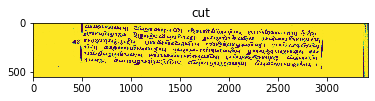

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/111-0.jpg !!!
[0, 651.3333333333334, 3417, 1321.6666666666667]


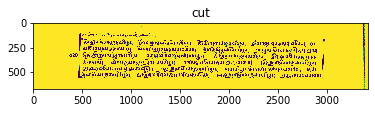

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/111-1.jpg !!!
[0, 1338.3333333333333, 3417, 1956.6666666666667]


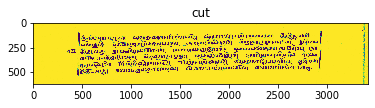

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/111-2.jpg !!!
[0, 1949.3333333333333, 3417, 2563.6666666666665]


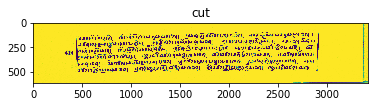

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/111-3.jpg !!!
112 (2).jpg
(3534, 2649)
Processing 112 (2)


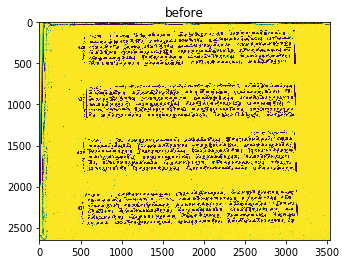

{2: 52, 3: 24, 1: 201, 4: 16}
threshold 4.602581085420681
[0, 93, 3534, 543]
[0, 729, 3534, 1183]
[0, 1318, 3534, 1829]
[0, 2027, 3534, 2486]
[0, 83.0, 3534, 633.0]


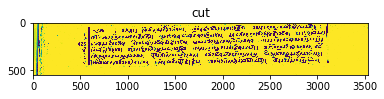

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/112 (2)-0.jpg !!!
[0, 639.0, 3534, 1273.0]


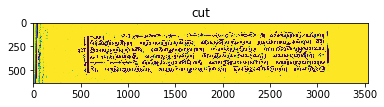

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/112 (2)-1.jpg !!!
[0, 1228.0, 3534, 1919.0]


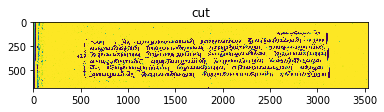

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/112 (2)-2.jpg !!!
[0, 1937.0, 3534, 2576.0]


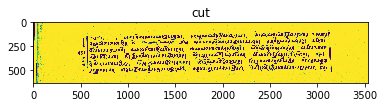

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/112 (2)-3.jpg !!!
113.jpg
(3463, 2573)
Processing 113


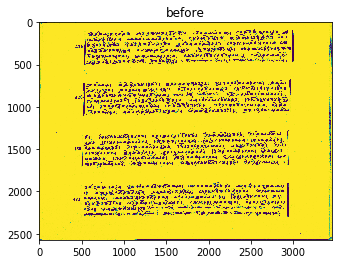

{2: 26, 1: 28, 3: 17, 4: 23}
threshold 3.4349229668863974
[0, 80, 3463, 517]
[0, 679, 3463, 1107]
[0, 1279, 3463, 1717]
[0, 1891, 3463, 2308]
[0, 33.66666666666663, 3463, 583.6666666666666]


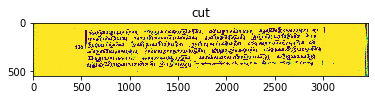

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/113-0.jpg !!!
[0, 612.3333333333334, 3463, 1173.6666666666667]


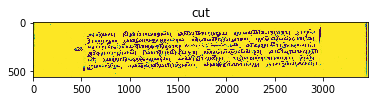

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/113-1.jpg !!!
[0, 1212.3333333333333, 3463, 1783.6666666666667]


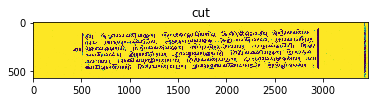

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/113-2.jpg !!!
[0, 1824.3333333333333, 3463, 2374.6666666666665]


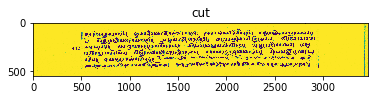

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/113-3.jpg !!!
114 (2).jpg
(3456, 2635)
Processing 114 (2)


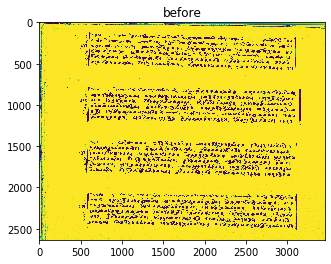

{4: 12, 1: 132, 2: 38, 3: 20}
threshold 4.497611989459813
[0, 131, 3456, 583]
[0, 784, 3456, 1231]
[0, 1421, 3456, 1878]
[0, 2058, 3456, 2504]
[0, 99.66666666666663, 3456, 649.6666666666666]


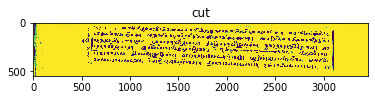

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/114 (2)-0.jpg !!!
[0, 717.3333333333334, 3456, 1297.6666666666667]


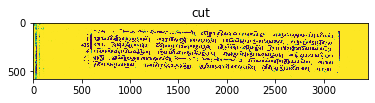

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/114 (2)-1.jpg !!!
[0, 1354.3333333333333, 3456, 1944.6666666666667]


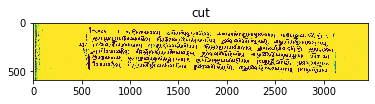

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/114 (2)-2.jpg !!!
[0, 1991.3333333333333, 3456, 2570.6666666666665]


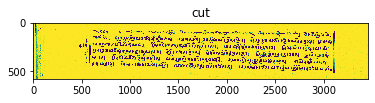

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/114 (2)-3.jpg !!!
115.jpg
(3500, 2641)
Processing 115


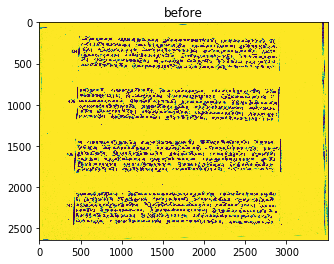

{1: 105, 4: 16, 3: 9, 2: 17}
threshold 3.504581529581527
[0, 165, 3500, 589]
[0, 782, 3500, 1213]
[0, 1407, 3500, 1836]
[0, 2032, 3500, 2468]
[0, 105.66666666666663, 3500, 655.6666666666666]


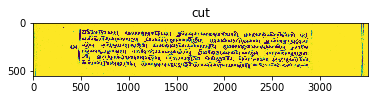

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/115-0.jpg !!!
[0, 715.3333333333334, 3500, 1279.6666666666667]


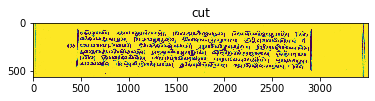

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/115-1.jpg !!!
[0, 1340.3333333333333, 3500, 1902.6666666666667]


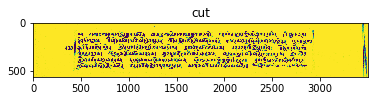

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/115-2.jpg !!!
[0, 1965.3333333333333, 3500, 2534.6666666666665]


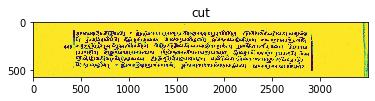

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/115-3.jpg !!!
116 (2).jpg
(3509, 2642)
Processing 116 (2)


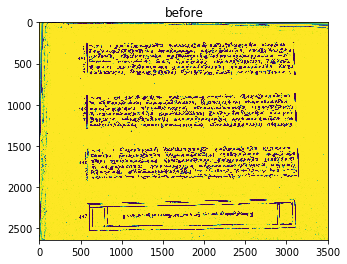

{3: 15, 2: 41, 1: 174, 4: 11}
threshold 4.599546778892845
[0, 233, 3509, 665]
[0, 859, 3509, 1296]
[0, 1492, 3509, 1919]
[0, 2124, 3509, 2552]
[0, 181.66666666666663, 3509, 731.6666666666666]


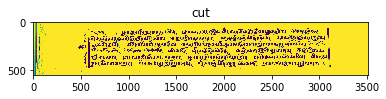

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/116 (2)-0.jpg !!!
[0, 792.3333333333334, 3509, 1362.6666666666667]


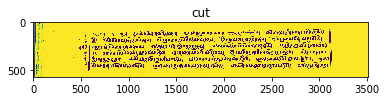

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/116 (2)-1.jpg !!!
[0, 1425.3333333333333, 3509, 1985.6666666666667]


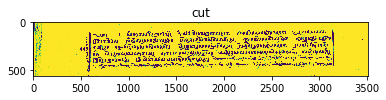

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/116 (2)-2.jpg !!!
[0, 2057.3333333333335, 3509, 2618.6666666666665]


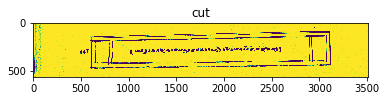

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/116 (2)-3.jpg !!!
117.jpg
(3448, 2580)
Processing 117


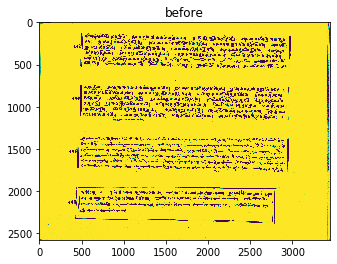

{1: 20, 2: 69, 4: 15, 3: 28}
threshold 4.5915015411712865
[0, 130, 3448, 563]
[0, 736, 3448, 1177]
[0, 1344, 3448, 1772]
[0, 1926, 3448, 2270]
[0, 79.66666666666663, 3448, 629.6666666666666]


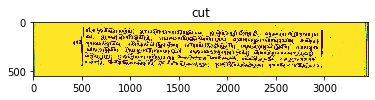

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/117-0.jpg !!!
[0, 669.3333333333334, 3448, 1243.6666666666667]


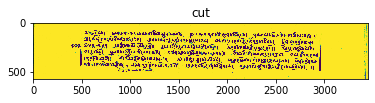

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/117-1.jpg !!!
[0, 1277.3333333333333, 3448, 1838.6666666666667]


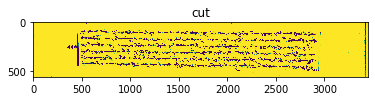

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/117-2.jpg !!!
[0, 1859.3333333333333, 3448, 2336.6666666666665]


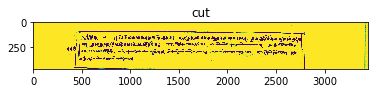

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/117-3.jpg !!!
118 (2).jpg
(3490, 2640)
Processing 118 (2)


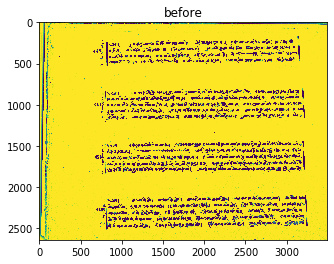

{3: 30, 2: 48, 1: 255, 4: 25}
threshold 4.473342019543975
[0, 199, 3490, 518]
[0, 800, 3490, 1197]
[0, 1434, 3490, 1835]
[0, 2088, 3490, 2513]
[0, 34.66666666666663, 3490, 584.6666666666666]


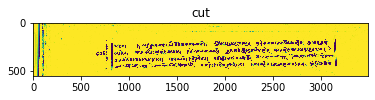

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/118 (2)-0.jpg !!!
[0, 733.3333333333334, 3490, 1263.6666666666667]


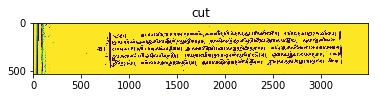

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/118 (2)-1.jpg !!!
[0, 1367.3333333333333, 3490, 1901.6666666666667]


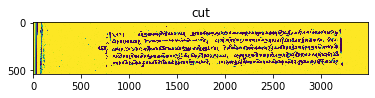

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/118 (2)-2.jpg !!!
[0, 2021.3333333333333, 3490, 2579.6666666666665]


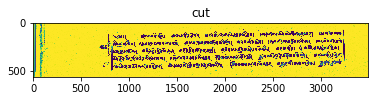

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/118 (2)-3.jpg !!!
119.jpg
(3458, 2602)
Processing 119


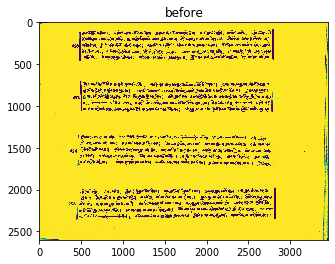

{1: 46, 2: 51, 3: 29, 4: 31}
threshold 3.4729972077818867
[0, 79, 3458, 470]
[0, 693, 3458, 1091]
[0, 1329, 3458, 1731]
[0, 1970, 3458, 2363]
[0, 0, 3458, 536.6666666666666]


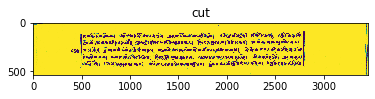

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/119-0.jpg !!!
[0, 626.3333333333334, 3458, 1157.6666666666667]


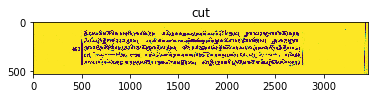

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/119-1.jpg !!!
[0, 1262.3333333333333, 3458, 1797.6666666666667]


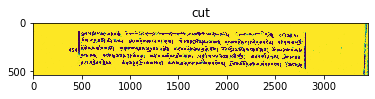

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/119-2.jpg !!!
[0, 1903.3333333333333, 3458, 2429.6666666666665]


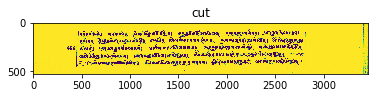

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/119-3.jpg !!!
12.jpg
(3513, 2598)
Processing 12


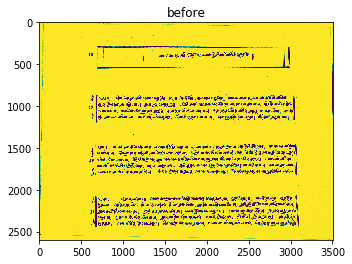

{1: 50, 2: 91, 3: 132, 4: 42}
threshold 4.441403784274781
[0, 264, 3513, 465]
[0, 858, 3513, 1186]
[0, 1441, 3513, 1830]
[0, 2059, 3513, 2451]
[0, 0, 3513, 531.6666666666666]


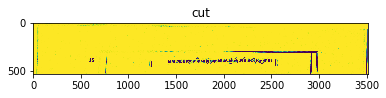

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/12-0.jpg !!!
[0, 791.3333333333334, 3513, 1252.6666666666667]


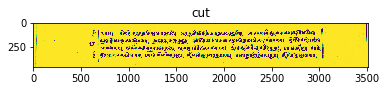

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/12-1.jpg !!!
[0, 1374.3333333333333, 3513, 1896.6666666666667]


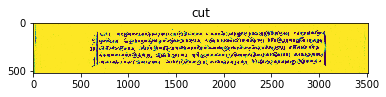

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/12-2.jpg !!!
[0, 1992.3333333333333, 3513, 2517.6666666666665]


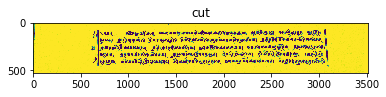

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/12-3.jpg !!!
120 (2).jpg
(3479, 2643)
Processing 120 (2)


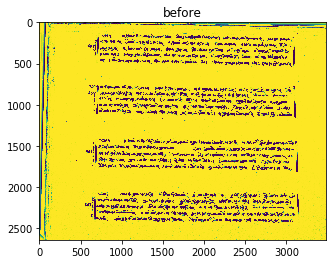

{4: 6, 2: 28, 3: 17, 1: 200}
threshold 4.531437288874358
[0, 131, 3479, 544]
[0, 753, 3479, 1162]
[0, 1401, 3479, 1812]
[0, 2045, 3479, 2448]
[0, 60.66666666666663, 3479, 610.6666666666666]


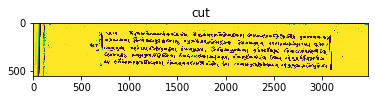

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/120 (2)-0.jpg !!!
[0, 686.3333333333334, 3479, 1228.6666666666667]


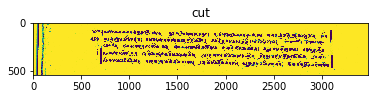

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/120 (2)-1.jpg !!!
[0, 1334.3333333333333, 3479, 1878.6666666666667]


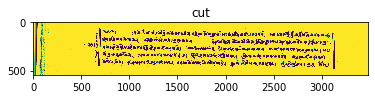

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/120 (2)-2.jpg !!!
[0, 1978.3333333333333, 3479, 2514.6666666666665]


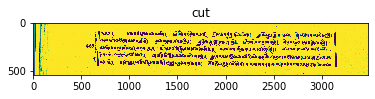

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/120 (2)-3.jpg !!!
121.jpg
(3453, 2592)
Processing 121


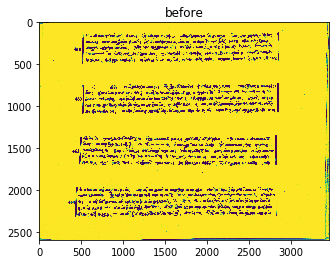

{3: 24, 1: 29, 2: 20, 4: 23}
threshold 2.5341575997362353
[0, 114, 3453, 498]
[0, 718, 3453, 1107]
[0, 1338, 3453, 1725]
[0, 1941, 3453, 2334]
[0, 14.666666666666629, 3453, 564.6666666666666]


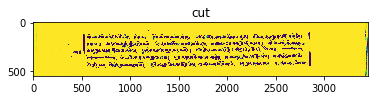

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/121-0.jpg !!!
[0, 651.3333333333334, 3453, 1173.6666666666667]


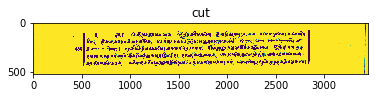

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/121-1.jpg !!!
[0, 1271.3333333333333, 3453, 1791.6666666666667]


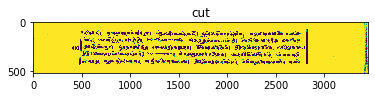

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/121-2.jpg !!!
[0, 1874.3333333333333, 3453, 2400.6666666666665]


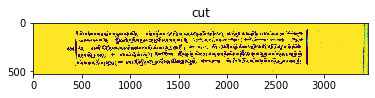

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/121-3.jpg !!!
122 (2).jpg
(3525, 2637)
Processing 122 (2)


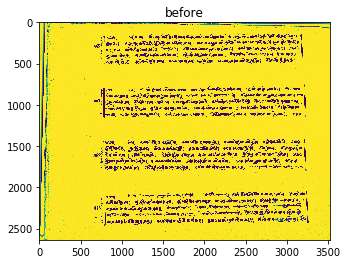

{3: 29, 2: 43, 4: 31, 1: 209}
threshold 3.443122883002943
[0, 125, 3525, 527]
[0, 764, 3525, 1165]
[0, 1400, 3525, 1817]
[0, 2037, 3525, 2465]
[0, 43.66666666666663, 3525, 593.6666666666666]


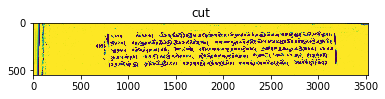

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/122 (2)-0.jpg !!!
[0, 697.3333333333334, 3525, 1231.6666666666667]


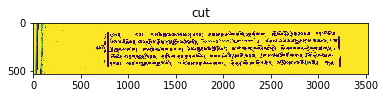

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/122 (2)-1.jpg !!!
[0, 1333.3333333333333, 3525, 1883.6666666666667]


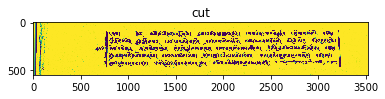

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/122 (2)-2.jpg !!!
[0, 1970.3333333333333, 3525, 2531.6666666666665]


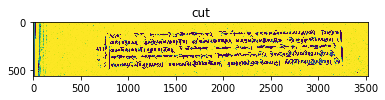

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/122 (2)-3.jpg !!!
123.jpg
(3436, 2578)
Processing 123


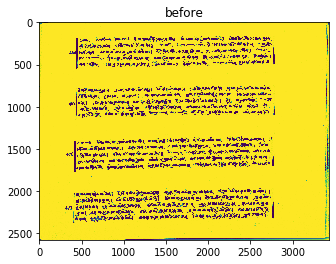

{3: 10, 2: 10, 1: 81, 4: 9}
threshold 4.542035072207489
[0, 154, 3436, 546]
[0, 743, 3436, 1135]
[0, 1345, 3436, 1759]
[0, 1960, 3436, 2367]
[0, 62.66666666666663, 3436, 612.6666666666666]


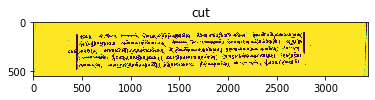

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/123-0.jpg !!!
[0, 676.3333333333334, 3436, 1201.6666666666667]


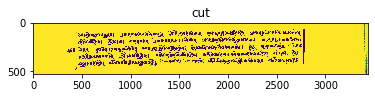

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/123-1.jpg !!!
[0, 1278.3333333333333, 3436, 1825.6666666666667]


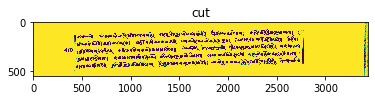

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/123-2.jpg !!!
[0, 1893.3333333333333, 3436, 2433.6666666666665]


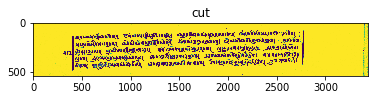

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/123-3.jpg !!!
124 (2).jpg
(3528, 2647)
Processing 124 (2)


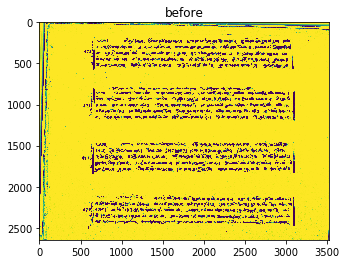

{4: 48, 2: 62, 3: 57, 1: 193}
threshold 4.474085692835694
[0, 182, 3528, 577]
[0, 772, 3528, 1203]
[0, 1444, 3528, 1838]
[0, 2091, 3528, 2474]
[0, 93.66666666666663, 3528, 643.6666666666666]


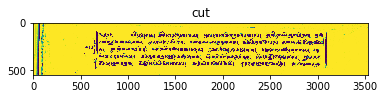

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/124 (2)-0.jpg !!!
[0, 705.3333333333334, 3528, 1269.6666666666667]


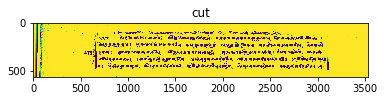

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/124 (2)-1.jpg !!!
[0, 1377.3333333333333, 3528, 1904.6666666666667]


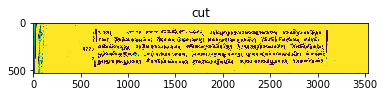

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/124 (2)-2.jpg !!!
[0, 2024.3333333333333, 3528, 2540.6666666666665]


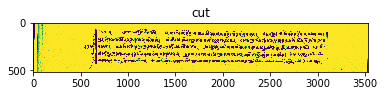

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/124 (2)-3.jpg !!!
125.jpg
(3427, 2589)
Processing 125


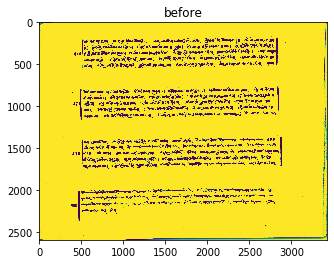

{3: 22, 1: 106, 2: 89, 4: 29}
threshold 3.5570335882939785
[0, 172, 3427, 562]
[0, 764, 3427, 1154]
[0, 1357, 3427, 1752]
[0, 1958, 3427, 2279]
[0, 78.66666666666663, 3427, 628.6666666666666]


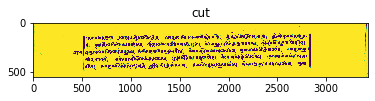

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/125-0.jpg !!!
[0, 697.3333333333334, 3427, 1220.6666666666667]


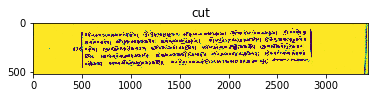

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/125-1.jpg !!!
[0, 1290.3333333333333, 3427, 1818.6666666666667]


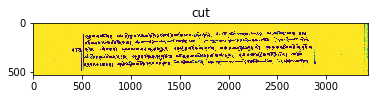

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/125-2.jpg !!!
[0, 1891.3333333333333, 3427, 2345.6666666666665]


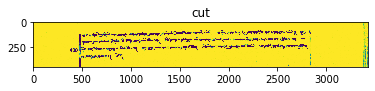

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/125-3.jpg !!!
126 (2).jpg
(3451, 2646)
Processing 126 (2)


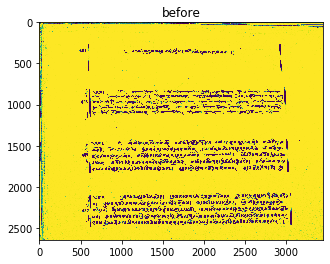

{3: 32, 1: 327, 2: 215, 4: 23}
threshold 4.3985196448295145
[0, 801, 3451, 1140]
[0, 1411, 3451, 1830]
[0, 2063, 3451, 2482]
[0, 656.6666666666667, 3451, 1206.6666666666667]


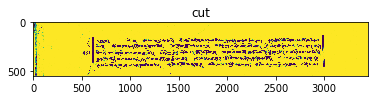

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/126 (2)-0.jpg !!!
[0, 1344.3333333333333, 3451, 1896.6666666666667]


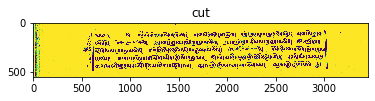

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/126 (2)-1.jpg !!!
[0, 1996.3333333333333, 3451, 2548.6666666666665]


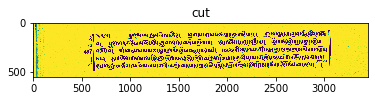

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/126 (2)-2.jpg !!!
127.jpg
(3425, 2593)
Processing 127


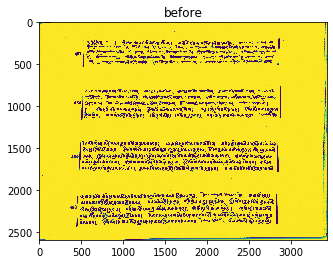

{1: 65, 2: 48, 3: 23, 4: 12}
threshold 4.440016638935108
[0, 198, 3425, 517]
[0, 779, 3425, 1161]
[0, 1391, 3425, 1795]
[0, 2017, 3425, 2425]
[0, 33.66666666666663, 3425, 583.6666666666666]


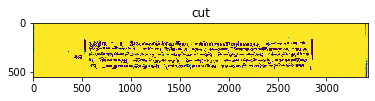

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/127-0.jpg !!!
[0, 712.3333333333334, 3425, 1227.6666666666667]


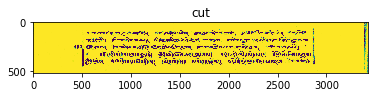

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/127-1.jpg !!!
[0, 1324.3333333333333, 3425, 1861.6666666666667]


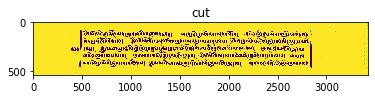

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/127-2.jpg !!!
[0, 1950.3333333333333, 3425, 2491.6666666666665]


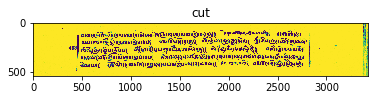

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/127-3.jpg !!!
128 (2).jpg
(3453, 2656)
Processing 128 (2)


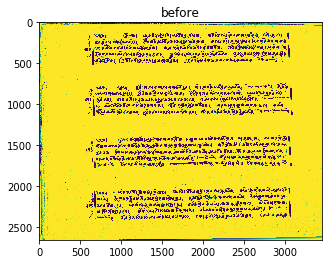

{4: 8, 1: 262, 2: 36, 3: 9}
threshold 4.637899769205404
[0, 111, 3453, 522]
[0, 739, 3453, 1149]
[0, 1375, 3453, 1780]
[0, 2004, 3453, 2423]
[0, 38.66666666666663, 3453, 588.6666666666666]


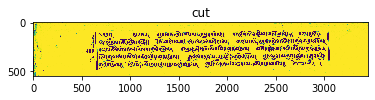

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/128 (2)-0.jpg !!!
[0, 672.3333333333334, 3453, 1215.6666666666667]


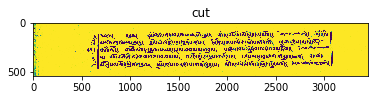

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/128 (2)-1.jpg !!!
[0, 1308.3333333333333, 3453, 1846.6666666666667]


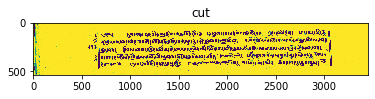

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/128 (2)-2.jpg !!!
[0, 1937.3333333333333, 3453, 2489.6666666666665]


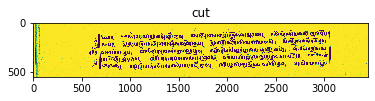

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/128 (2)-3.jpg !!!
129.jpg
(3437, 2560)
Processing 129


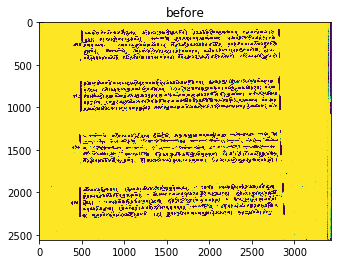

{4: 14, 1: 40, 2: 20, 3: 21}
threshold 4.3991429518443095
[0, 70, 3437, 462]
[0, 654, 3437, 1058]
[0, 1280, 3437, 1677]
[0, 1892, 3437, 2311]
[0, 0, 3437, 528.6666666666666]


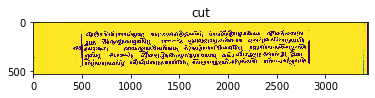

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/129-0.jpg !!!
[0, 587.3333333333334, 3437, 1124.6666666666667]


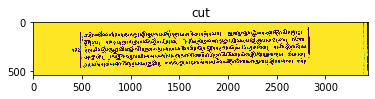

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/129-1.jpg !!!
[0, 1213.3333333333333, 3437, 1743.6666666666667]


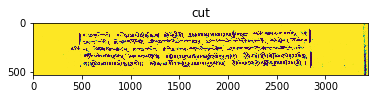

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/129-2.jpg !!!
[0, 1825.3333333333333, 3437, 2377.6666666666665]


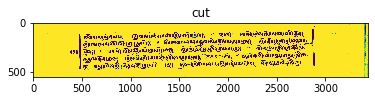

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/129-3.jpg !!!
13.jpg
(3449, 2599)
Processing 13


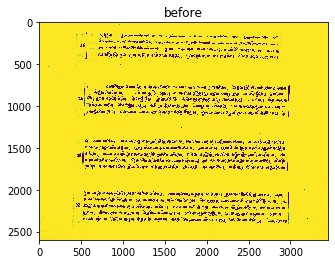

{1: 67, 2: 31, 3: 34, 4: 39}
threshold 2.3535287915739245
[0, 123, 3449, 462]
[0, 729, 3449, 1137]
[0, 1376, 3449, 1780]
[0, 1999, 3449, 2414]
[0, 0, 3449, 528.6666666666666]


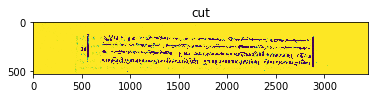

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/13-0.jpg !!!
[0, 662.3333333333334, 3449, 1203.6666666666667]


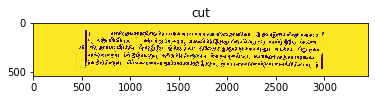

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/13-1.jpg !!!
[0, 1309.3333333333333, 3449, 1846.6666666666667]


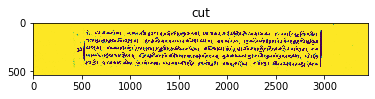

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/13-2.jpg !!!
[0, 1932.3333333333333, 3449, 2480.6666666666665]


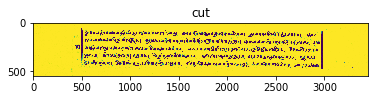

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/13-3.jpg !!!
130 (2).jpg
(3513, 2642)
Processing 130 (2)


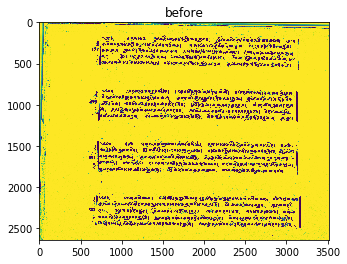

{2: 36, 1: 278, 3: 10, 4: 19}
threshold 3.666214031684447
[0, 155, 3513, 565]
[0, 794, 3513, 1210]
[0, 1428, 3513, 1850]
[0, 2085, 3513, 2504]
[0, 81.66666666666663, 3513, 631.6666666666666]


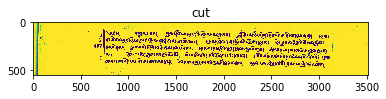

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/130 (2)-0.jpg !!!
[0, 727.3333333333334, 3513, 1276.6666666666667]


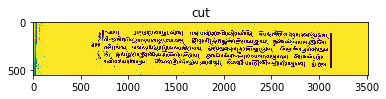

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/130 (2)-1.jpg !!!
[0, 1361.3333333333333, 3513, 1916.6666666666667]


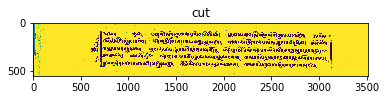

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/130 (2)-2.jpg !!!
[0, 2018.3333333333333, 3513, 2570.6666666666665]


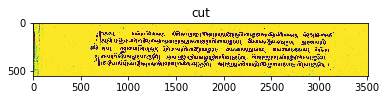

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/130 (2)-3.jpg !!!
131.jpg
(3410, 2564)
Processing 131


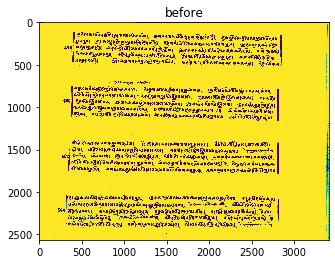

{1: 26, 2: 18, 3: 10, 4: 13}
threshold 3.489030100334449
[0, 108, 3410, 531]
[0, 684, 3410, 1165]
[0, 1379, 3410, 1795]
[0, 2022, 3410, 2437]
[0, 47.66666666666663, 3410, 597.6666666666666]


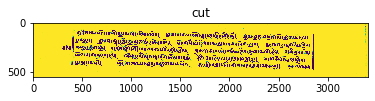

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/131-0.jpg !!!
[0, 617.3333333333334, 3410, 1231.6666666666667]


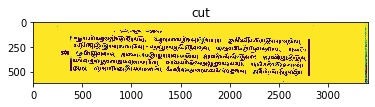

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/131-1.jpg !!!
[0, 1312.3333333333333, 3410, 1861.6666666666667]


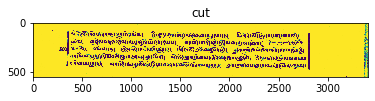

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/131-2.jpg !!!
[0, 1955.3333333333333, 3410, 2503.6666666666665]


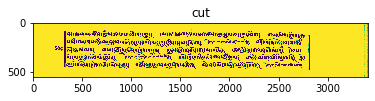

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/131-3.jpg !!!
132 (2).jpg
(3508, 2649)
Processing 132 (2)


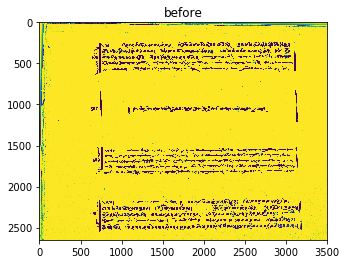

{2: 315, 1: 218, 3: 47, 4: 27}
threshold 4.427904912684705
[0, 221, 3508, 614]
[0, 1515, 3508, 1866]
[0, 2133, 3508, 2544]
[0, 130.66666666666663, 3508, 680.6666666666666]


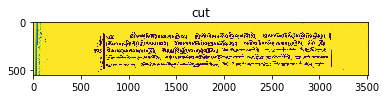

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/132 (2)-0.jpg !!!
[0, 1448.3333333333333, 3508, 1932.6666666666667]


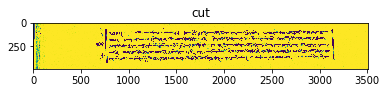

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/132 (2)-1.jpg !!!
[0, 2066.3333333333335, 3508, 2610.6666666666665]


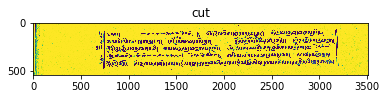

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/132 (2)-2.jpg !!!
133.jpg
(3399, 2570)
Processing 133


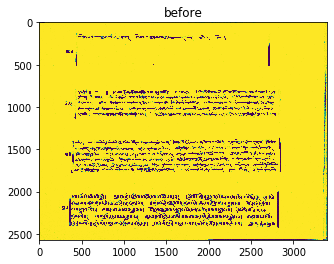

{2: 128, 1: 239, 3: 35, 4: 23}
threshold 4.54539749259308
[0, 780, 3399, 1132]
[0, 1370, 3399, 1786]
[0, 2004, 3399, 2428]
[0, 648.6666666666667, 3399, 1198.6666666666667]


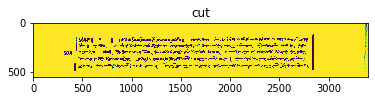

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/133-0.jpg !!!
[0, 1303.3333333333333, 3399, 1852.6666666666667]


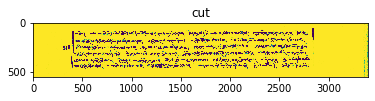

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/133-1.jpg !!!
[0, 1937.3333333333333, 3399, 2494.6666666666665]


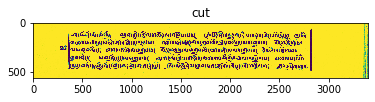

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/133-2.jpg !!!
134 (2).jpg
(3506, 2651)
Processing 134 (2)


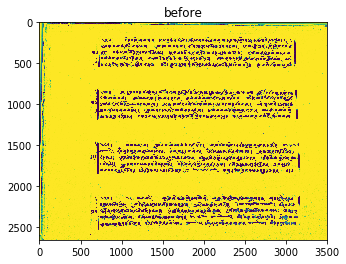

{3: 23, 1: 186, 2: 51, 4: 29}
threshold 3.5190481557665767
[0, 166, 3506, 575]
[0, 803, 3506, 1200]
[0, 1447, 3506, 1862]
[0, 2088, 3506, 2506]
[0, 91.66666666666663, 3506, 641.6666666666666]


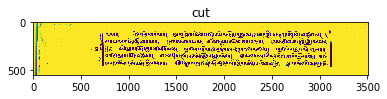

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/134 (2)-0.jpg !!!
[0, 736.3333333333334, 3506, 1266.6666666666667]


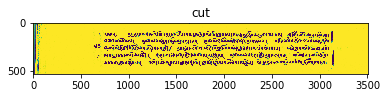

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/134 (2)-1.jpg !!!
[0, 1380.3333333333333, 3506, 1928.6666666666667]


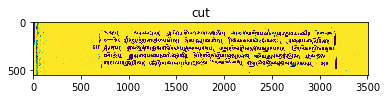

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/134 (2)-2.jpg !!!
[0, 2021.3333333333333, 3506, 2572.6666666666665]


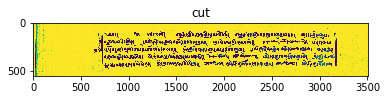

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/134 (2)-3.jpg !!!
135.jpg
(3400, 2581)
Processing 135


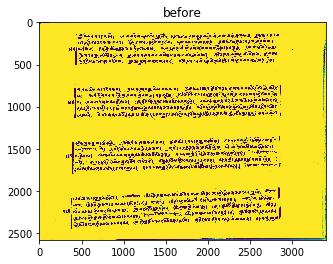

{3: 10, 1: 101, 2: 7, 4: 5}
threshold 4.567718120805369
[0, 115, 3400, 515]
[0, 738, 3400, 1148]
[0, 1358, 3400, 1779]
[0, 1970, 3400, 2434]
[0, 31.66666666666663, 3400, 581.6666666666666]


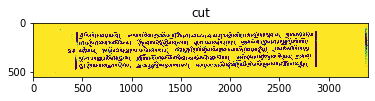

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/135-0.jpg !!!
[0, 671.3333333333334, 3400, 1214.6666666666667]


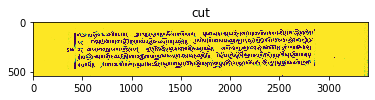

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/135-1.jpg !!!
[0, 1291.3333333333333, 3400, 1845.6666666666667]


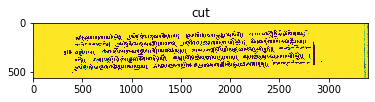

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/135-2.jpg !!!
[0, 1903.3333333333333, 3400, 2500.6666666666665]


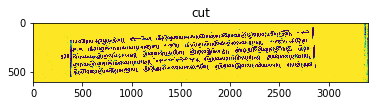

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/135-3.jpg !!!
136 (2).jpg
(3502, 2656)
Processing 136 (2)


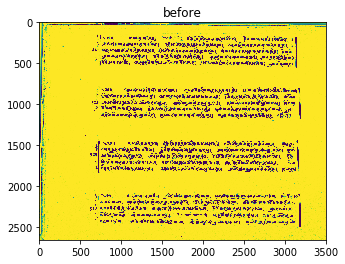

{1: 198, 2: 33, 3: 27, 4: 24}
threshold 4.6071409258057505
[0, 151, 3502, 551]
[0, 781, 3502, 1191]
[0, 1428, 3502, 1843]
[0, 2071, 3502, 2489]
[0, 67.66666666666663, 3502, 617.6666666666666]


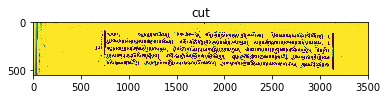

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/136 (2)-0.jpg !!!
[0, 714.3333333333334, 3502, 1257.6666666666667]


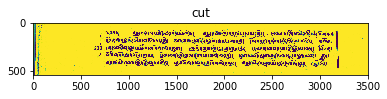

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/136 (2)-1.jpg !!!
[0, 1361.3333333333333, 3502, 1909.6666666666667]


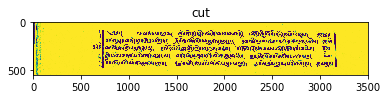

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/136 (2)-2.jpg !!!
[0, 2004.3333333333333, 3502, 2555.6666666666665]


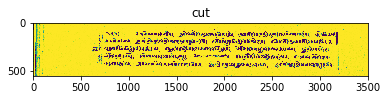

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/136 (2)-3.jpg !!!
137.jpg
(3400, 2581)
Processing 137


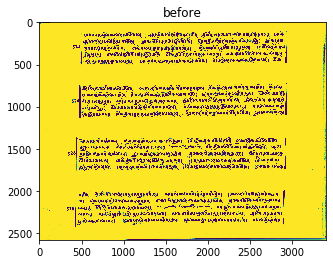

{4: 17, 2: 18, 3: 9, 1: 50}
threshold 3.5652870991797148
[0, 95, 3400, 517]
[0, 722, 3400, 1143]
[0, 1351, 3400, 1772]
[0, 1985, 3400, 2407]
[0, 33.66666666666663, 3400, 583.6666666666666]


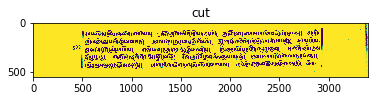

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/137-0.jpg !!!
[0, 655.3333333333334, 3400, 1209.6666666666667]


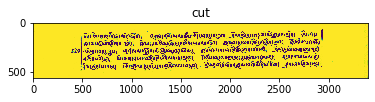

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/137-1.jpg !!!
[0, 1284.3333333333333, 3400, 1838.6666666666667]


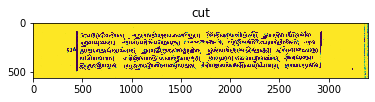

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/137-2.jpg !!!
[0, 1918.3333333333333, 3400, 2473.6666666666665]


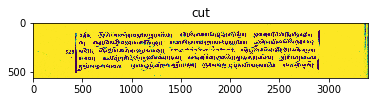

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/137-3.jpg !!!
138 (2).jpg
(3502, 2654)
Processing 138 (2)


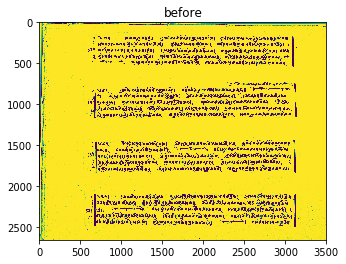

{4: 15, 1: 192, 2: 31, 3: 16}
threshold 4.4984858317110135
[0, 152, 3502, 541]
[0, 722, 3502, 1182]
[0, 1427, 3502, 1845]
[0, 2076, 3502, 2494]
[0, 57.66666666666663, 3502, 607.6666666666666]


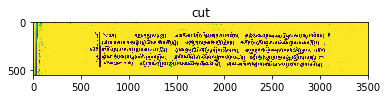

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/138 (2)-0.jpg !!!
[0, 655.3333333333334, 3502, 1248.6666666666667]


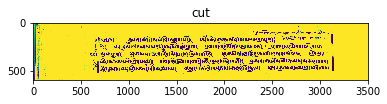

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/138 (2)-1.jpg !!!
[0, 1360.3333333333333, 3502, 1911.6666666666667]


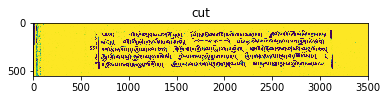

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/138 (2)-2.jpg !!!
[0, 2009.3333333333333, 3502, 2560.6666666666665]


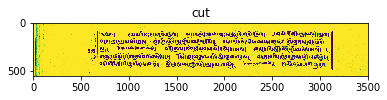

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/138 (2)-3.jpg !!!
139.jpg
(3398, 2586)
Processing 139


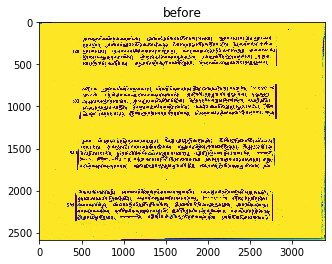

{2: 42, 1: 69, 3: 7, 4: 9}
threshold 3.47112155809268
[0, 147, 3398, 542]
[0, 738, 3398, 1139]
[0, 1355, 3398, 1764]
[0, 1964, 3398, 2371]
[0, 58.66666666666663, 3398, 608.6666666666666]


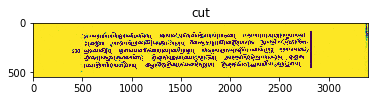

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/139-0.jpg !!!
[0, 671.3333333333334, 3398, 1205.6666666666667]


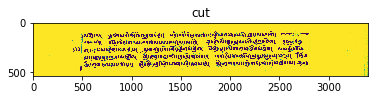

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/139-1.jpg !!!
[0, 1288.3333333333333, 3398, 1830.6666666666667]


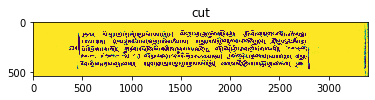

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/139-2.jpg !!!
[0, 1897.3333333333333, 3398, 2437.6666666666665]


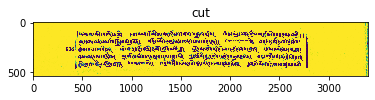

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/139-3.jpg !!!
14.jpg
(3452, 2535)
Processing 14


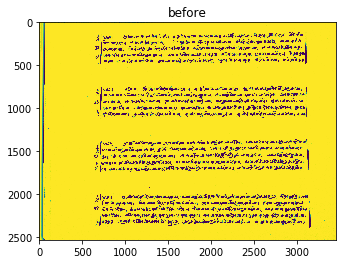

{1: 52, 4: 56, 2: 32, 3: 32}
threshold 2.4456629287598943
[0, 108, 3452, 496]
[0, 731, 3452, 1124]
[0, 1352, 3452, 1753]
[0, 1980, 3452, 2380]
[0, 12.666666666666629, 3452, 562.6666666666666]


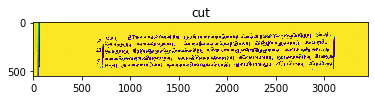

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/14-0.jpg !!!
[0, 664.3333333333334, 3452, 1190.6666666666667]


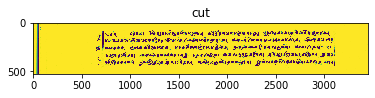

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/14-1.jpg !!!
[0, 1285.3333333333333, 3452, 1819.6666666666667]


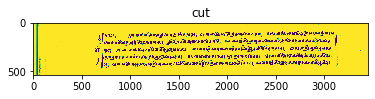

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/14-2.jpg !!!
[0, 1913.3333333333333, 3452, 2446.6666666666665]


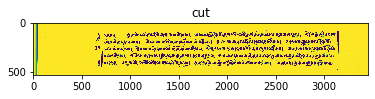

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/14-3.jpg !!!
140 (2).jpg
(3529, 2655)
Processing 140 (2)


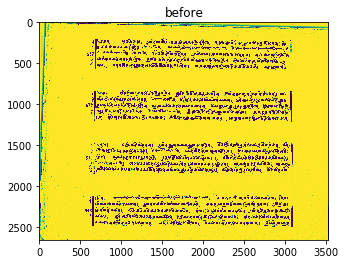

{3: 30, 4: 23, 1: 132, 2: 24}
threshold 4.442627994462083
[0, 196, 3529, 590]
[0, 820, 3529, 1218]
[0, 1445, 3529, 1855]
[0, 2091, 3529, 2503]
[0, 106.66666666666663, 3529, 656.6666666666666]


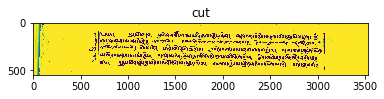

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/140 (2)-0.jpg !!!
[0, 753.3333333333334, 3529, 1284.6666666666667]


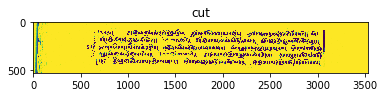

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/140 (2)-1.jpg !!!
[0, 1378.3333333333333, 3529, 1921.6666666666667]


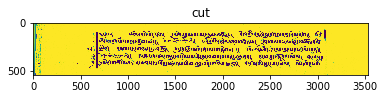

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/140 (2)-2.jpg !!!
[0, 2024.3333333333333, 3529, 2569.6666666666665]


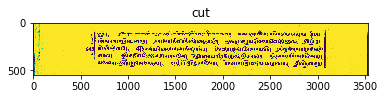

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/140 (2)-3.jpg !!!
141.jpg
(3400, 2590)
Processing 141


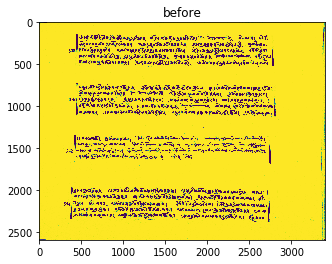

{3: 30, 2: 43, 1: 52, 4: 21}
threshold 4.502908277404925
[0, 133, 3400, 534]
[0, 728, 3400, 1128]
[0, 1335, 3400, 1648]
[0, 1955, 3400, 2363]
[0, 50.66666666666663, 3400, 600.6666666666666]


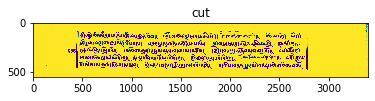

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/141-0.jpg !!!
[0, 661.3333333333334, 3400, 1194.6666666666667]


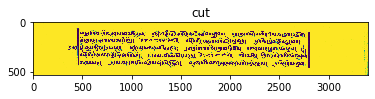

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/141-1.jpg !!!
[0, 1268.3333333333333, 3400, 1714.6666666666667]


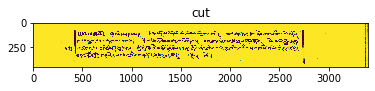

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/141-2.jpg !!!
[0, 1888.3333333333333, 3400, 2429.6666666666665]


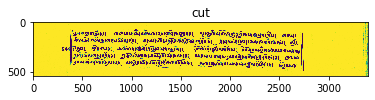

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/141-3.jpg !!!
142 (2).jpg
(3530, 2662)
Processing 142 (2)


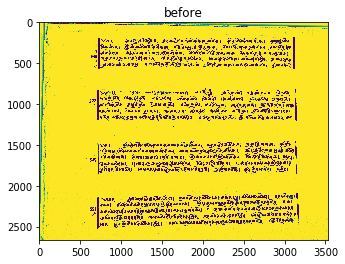

{3: 26, 1: 129, 2: 56, 4: 12}
threshold 4.558360128617366
[0, 176, 3530, 572]
[0, 814, 3530, 1219]
[0, 1444, 3530, 1857]
[0, 2086, 3530, 2515]
[0, 88.66666666666663, 3530, 638.6666666666666]


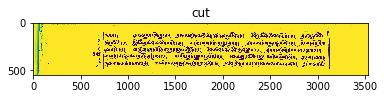

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/142 (2)-0.jpg !!!
[0, 747.3333333333334, 3530, 1285.6666666666667]


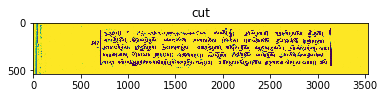

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/142 (2)-1.jpg !!!
[0, 1377.3333333333333, 3530, 1923.6666666666667]


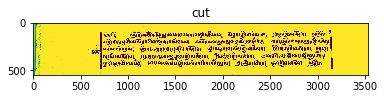

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/142 (2)-2.jpg !!!
[0, 2019.3333333333333, 3530, 2581.6666666666665]


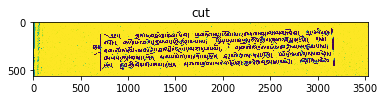

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/142 (2)-3.jpg !!!
143.jpg
(3396, 2581)
Processing 143


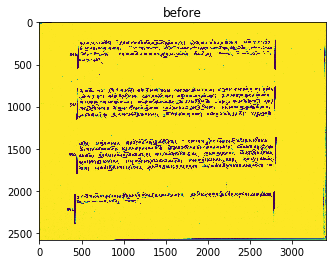

{3: 45, 1: 94, 2: 244, 4: 48}
threshold 3.3790919952210277
[0, 187, 3396, 490]
[0, 755, 3396, 1147]
[0, 1359, 3396, 1776]
[0, 1993, 3396, 2254]
[0, 6.666666666666629, 3396, 556.6666666666666]


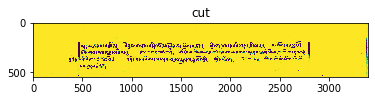

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/143-0.jpg !!!
[0, 688.3333333333334, 3396, 1213.6666666666667]


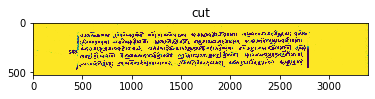

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/143-1.jpg !!!
[0, 1292.3333333333333, 3396, 1842.6666666666667]


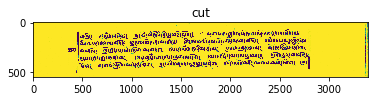

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/143-2.jpg !!!
[0, 1926.3333333333333, 3396, 2320.6666666666665]


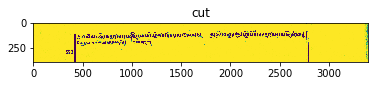

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/143-3.jpg !!!
144 (2).jpg
(3514, 2666)
Processing 144 (2)


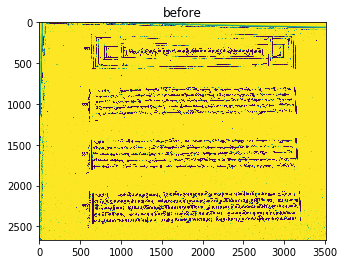

{4: 35, 3: 38, 2: 100, 1: 259}
threshold 4.544824083479545
[0, 115, 3514, 597]
[0, 778, 3514, 1153]
[0, 1412, 3514, 1811]
[0, 2052, 3514, 2477]
[0, 113.66666666666663, 3514, 663.6666666666666]


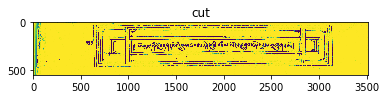

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/144 (2)-0.jpg !!!
[0, 711.3333333333334, 3514, 1219.6666666666667]


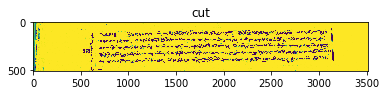

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/144 (2)-1.jpg !!!
[0, 1345.3333333333333, 3514, 1877.6666666666667]


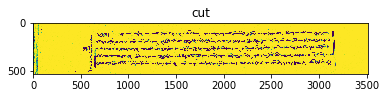

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/144 (2)-2.jpg !!!
[0, 1985.3333333333333, 3514, 2543.6666666666665]


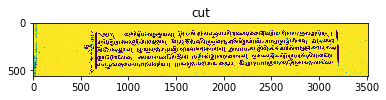

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/144 (2)-3.jpg !!!
145.jpg
(3398, 2582)
Processing 145


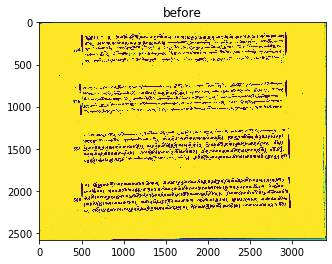

{4: 22, 1: 103, 2: 41, 3: 29}
threshold 4.36330056780023
[0, 127, 3398, 495]
[0, 698, 3398, 1091]
[0, 1253, 3398, 1677]
[0, 1833, 3398, 2269]
[0, 11.666666666666629, 3398, 561.6666666666666]


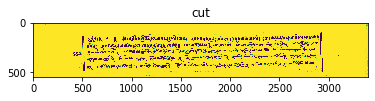

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/145-0.jpg !!!
[0, 631.3333333333334, 3398, 1157.6666666666667]


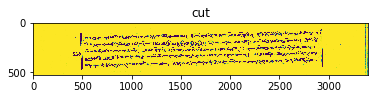

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/145-1.jpg !!!
[0, 1186.3333333333333, 3398, 1743.6666666666667]


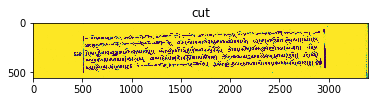

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/145-2.jpg !!!
[0, 1766.3333333333333, 3398, 2335.6666666666665]


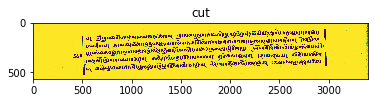

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/145-3.jpg !!!
146 (2).jpg
(3525, 2673)
Processing 146 (2)


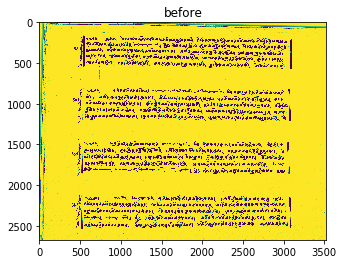

{3: 20, 4: 18, 1: 150, 2: 36}
threshold 4.443728752907496
[0, 164, 3525, 580]
[0, 801, 3525, 1226]
[0, 1449, 3525, 1876]
[0, 2115, 3525, 2542]
[0, 96.66666666666663, 3525, 646.6666666666666]


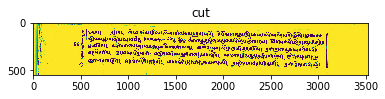

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/146 (2)-0.jpg !!!
[0, 734.3333333333334, 3525, 1292.6666666666667]


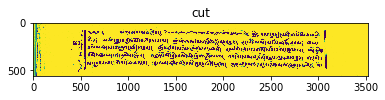

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/146 (2)-1.jpg !!!
[0, 1382.3333333333333, 3525, 1942.6666666666667]


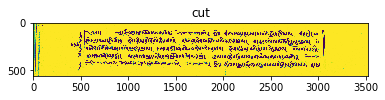

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/146 (2)-2.jpg !!!
[0, 2048.3333333333335, 3525, 2608.6666666666665]


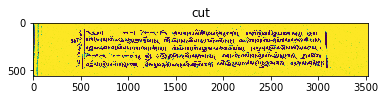

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/146 (2)-3.jpg !!!
147.jpg
(3396, 2587)
Processing 147


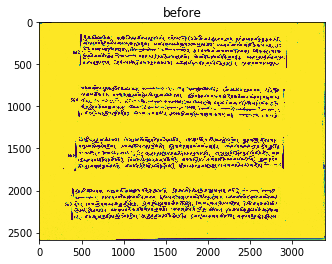

{4: 24, 2: 23, 1: 80, 3: 22}
threshold 3.428549608993158
[0, 137, 3396, 539]
[0, 743, 3396, 1150]
[0, 1343, 3396, 1762]
[0, 1947, 3396, 2364]
[0, 55.66666666666663, 3396, 605.6666666666666]


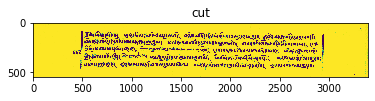

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/147-0.jpg !!!
[0, 676.3333333333334, 3396, 1216.6666666666667]


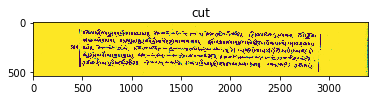

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/147-1.jpg !!!
[0, 1276.3333333333333, 3396, 1828.6666666666667]


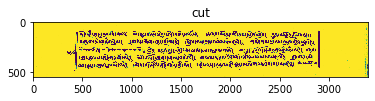

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/147-2.jpg !!!
[0, 1880.3333333333333, 3396, 2430.6666666666665]


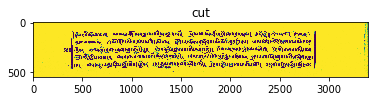

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/147-3.jpg !!!
148 (2).jpg
(3510, 2732)
Processing 148 (2)


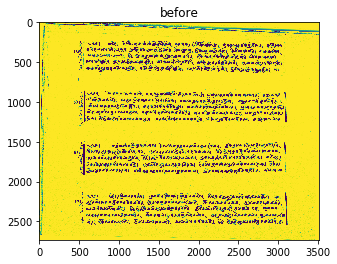

{3: 37, 1: 240, 2: 160, 4: 20}
threshold 4.488705501618123
[0, 224, 3510, 643]
[0, 856, 3510, 1268]
[0, 1499, 3510, 1918]
[0, 2127, 3510, 2561]
[0, 159.66666666666663, 3510, 709.6666666666666]


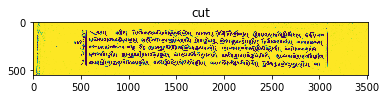

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/148 (2)-0.jpg !!!
[0, 789.3333333333334, 3510, 1334.6666666666667]


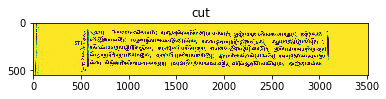

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/148 (2)-1.jpg !!!
[0, 1432.3333333333333, 3510, 1984.6666666666667]


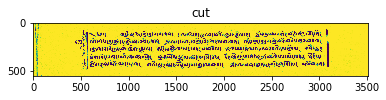

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/148 (2)-2.jpg !!!
[0, 2060.3333333333335, 3510, 2627.6666666666665]


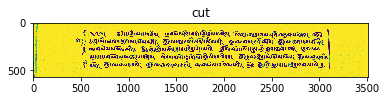

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/148 (2)-3.jpg !!!
149.jpg
(3439, 2640)
Processing 149


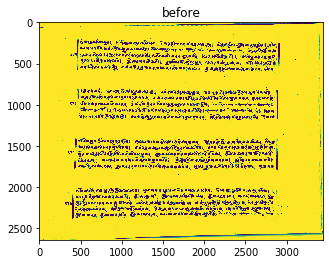

{3: 18, 1: 36, 2: 15, 4: 22}
threshold 2.525383681130616
[0, 201, 3439, 621]
[0, 791, 3439, 1205]
[0, 1391, 3439, 1805]
[0, 1988, 3439, 2387]
[0, 137.66666666666663, 3439, 687.6666666666666]


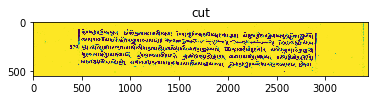

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/149-0.jpg !!!
[0, 724.3333333333334, 3439, 1271.6666666666667]


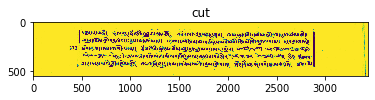

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/149-1.jpg !!!
[0, 1324.3333333333333, 3439, 1871.6666666666667]


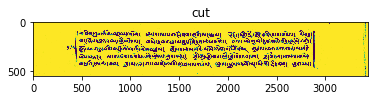

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/149-2.jpg !!!
[0, 1921.3333333333333, 3439, 2453.6666666666665]


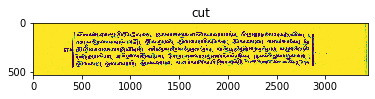

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/149-3.jpg !!!
15.jpg
(3441, 2594)
Processing 15


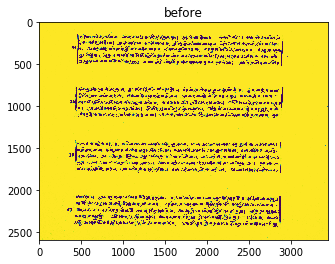

{1: 57, 2: 27, 4: 21, 3: 31}
threshold 4.491322646238236
[0, 134, 3441, 527]
[0, 757, 3441, 1154]
[0, 1411, 3441, 1801]
[0, 2045, 3441, 2450]
[0, 43.66666666666663, 3441, 593.6666666666666]


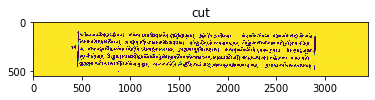

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/15-0.jpg !!!
[0, 690.3333333333334, 3441, 1220.6666666666667]


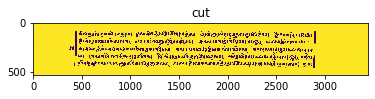

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/15-1.jpg !!!
[0, 1344.3333333333333, 3441, 1867.6666666666667]


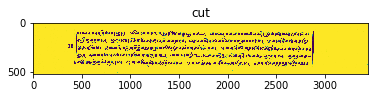

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/15-2.jpg !!!
[0, 1978.3333333333333, 3441, 2516.6666666666665]


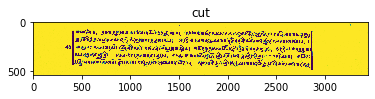

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/15-3.jpg !!!
150 (2).jpg
(3500, 2668)
Processing 150 (2)


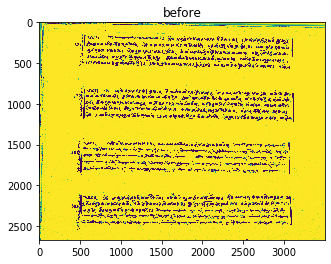

{4: 30, 2: 59, 1: 215, 3: 28}
threshold 3.586560760667903
[0, 149, 3500, 584]
[0, 801, 3500, 1219]
[0, 1446, 3500, 1863]
[0, 2092, 3500, 2507]
[0, 100.66666666666663, 3500, 650.6666666666666]


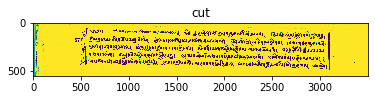

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/150 (2)-0.jpg !!!
[0, 734.3333333333334, 3500, 1285.6666666666667]


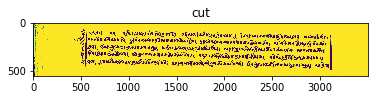

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/150 (2)-1.jpg !!!
[0, 1379.3333333333333, 3500, 1929.6666666666667]


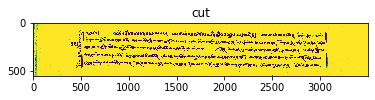

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/150 (2)-2.jpg !!!
[0, 2025.3333333333333, 3500, 2573.6666666666665]


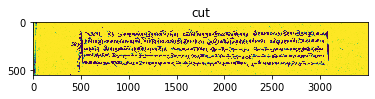

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/150 (2)-3.jpg !!!
151.jpg
(3399, 2572)
Processing 151


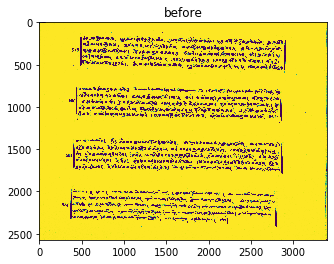

{3: 23, 1: 92, 2: 19, 4: 14}
threshold 4.576775523905433
[0, 156, 3399, 574]
[0, 754, 3399, 1153]
[0, 1365, 3399, 1771]
[0, 1968, 3399, 2367]
[0, 90.66666666666663, 3399, 640.6666666666666]


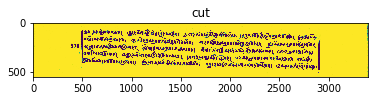

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/151-0.jpg !!!
[0, 687.3333333333334, 3399, 1219.6666666666667]


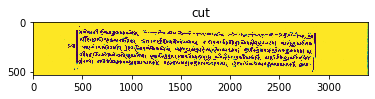

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/151-1.jpg !!!
[0, 1298.3333333333333, 3399, 1837.6666666666667]


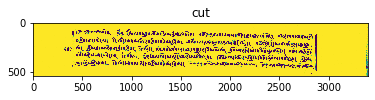

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/151-2.jpg !!!
[0, 1901.3333333333333, 3399, 2433.6666666666665]


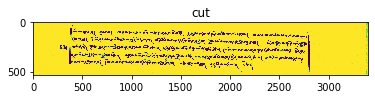

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/151-3.jpg !!!
152 (2).jpg
(3505, 2731)
Processing 152 (2)


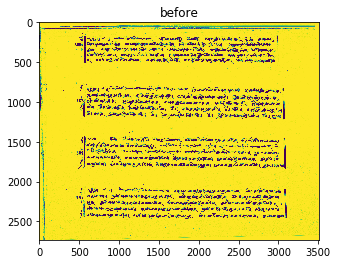

{1: 321, 2: 78, 3: 61, 4: 29}
threshold 4.468708433465601
[0, 162, 3505, 528]
[0, 792, 3505, 1222]
[0, 1424, 3505, 1843]
[0, 2063, 3505, 2478]
[0, 44.66666666666663, 3505, 594.6666666666666]


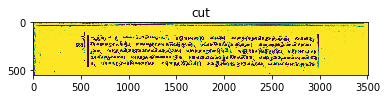

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/152 (2)-0.jpg !!!
[0, 725.3333333333334, 3505, 1288.6666666666667]


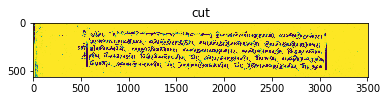

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/152 (2)-1.jpg !!!
[0, 1357.3333333333333, 3505, 1909.6666666666667]


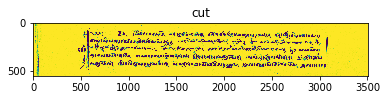

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/152 (2)-2.jpg !!!
[0, 1996.3333333333333, 3505, 2544.6666666666665]


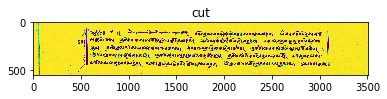

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/152 (2)-3.jpg !!!
153.jpg
(3400, 2580)
Processing 153


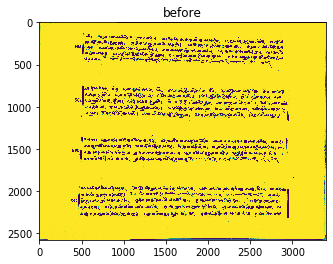

{2: 47, 1: 74, 3: 30, 4: 15}
threshold 4.4702684563758375
[0, 141, 3400, 507]
[0, 751, 3400, 1148]
[0, 1356, 3400, 1668]
[0, 1925, 3400, 2321]
[0, 23.66666666666663, 3400, 573.6666666666666]


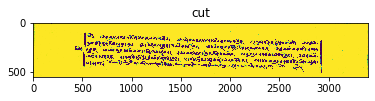

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/153-0.jpg !!!
[0, 684.3333333333334, 3400, 1214.6666666666667]


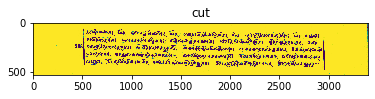

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/153-1.jpg !!!
[0, 1289.3333333333333, 3400, 1734.6666666666667]


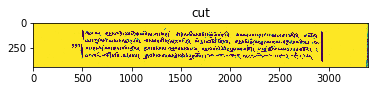

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/153-2.jpg !!!
[0, 1858.3333333333333, 3400, 2387.6666666666665]


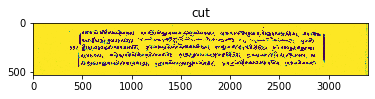

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/153-3.jpg !!!
154 (2).jpg
(3442, 2672)
Processing 154 (2)


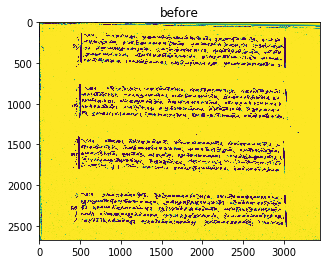

{2: 21, 1: 266, 3: 17, 4: 12}
threshold 4.439774983454669
[0, 132, 3442, 558]
[0, 773, 3442, 1195]
[0, 1421, 3442, 1848]
[0, 2077, 3442, 2507]
[0, 74.66666666666663, 3442, 624.6666666666666]


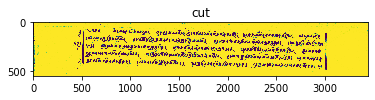

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/154 (2)-0.jpg !!!
[0, 706.3333333333334, 3442, 1261.6666666666667]


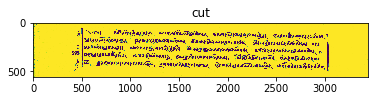

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/154 (2)-1.jpg !!!
[0, 1354.3333333333333, 3442, 1914.6666666666667]


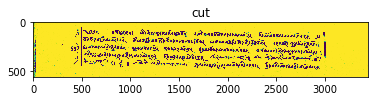

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/154 (2)-2.jpg !!!
[0, 2010.3333333333333, 3442, 2573.6666666666665]


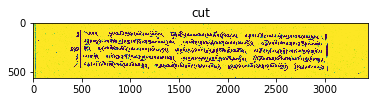

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/154 (2)-3.jpg !!!
155.jpg
(3398, 2588)
Processing 155


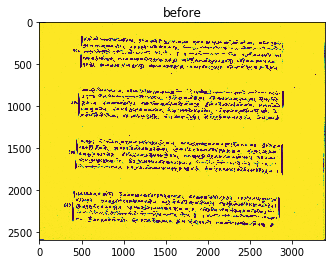

{1: 53, 2: 17, 3: 24, 4: 31}
threshold 2.3973452376249362
[0, 165, 3398, 588]
[0, 771, 3398, 1185]
[0, 1379, 3398, 1807]
[0, 1999, 3398, 2445]
[0, 104.66666666666663, 3398, 654.6666666666666]


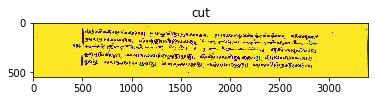

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/155-0.jpg !!!
[0, 704.3333333333334, 3398, 1251.6666666666667]


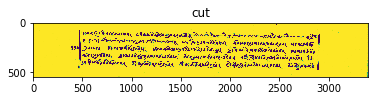

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/155-1.jpg !!!
[0, 1312.3333333333333, 3398, 1873.6666666666667]


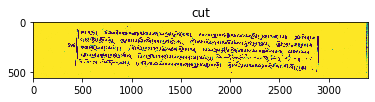

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/155-2.jpg !!!
[0, 1932.3333333333333, 3398, 2511.6666666666665]


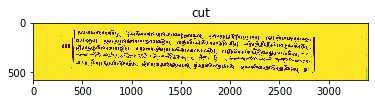

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/155-3.jpg !!!
156.jpg
(3439, 2675)
Processing 156


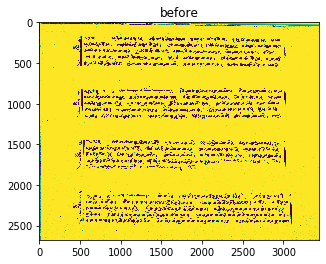

{4: 22, 2: 40, 1: 200, 3: 32}
threshold 4.482263844138637
[0, 161, 3439, 565]
[0, 795, 3439, 1205]
[0, 1429, 3439, 1819]
[0, 2083, 3439, 2493]
[0, 81.66666666666663, 3439, 631.6666666666666]


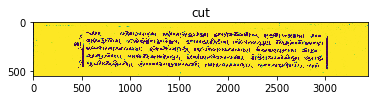

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/156-0.jpg !!!
[0, 728.3333333333334, 3439, 1271.6666666666667]


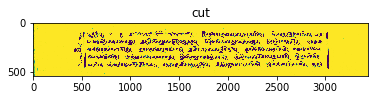

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/156-1.jpg !!!
[0, 1362.3333333333333, 3439, 1885.6666666666667]


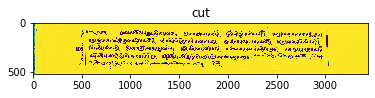

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/156-2.jpg !!!
[0, 2016.3333333333333, 3439, 2559.6666666666665]


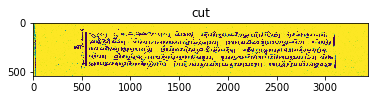

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/156-3.jpg !!!
157.jpg
(3587, 2566)
Processing 157


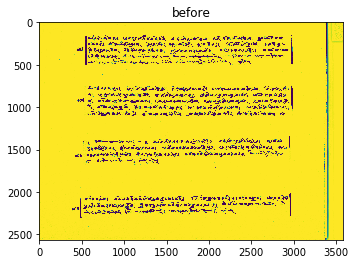

{1: 75, 2: 54, 3: 41, 4: 26}
threshold 4.509618420733037
[0, 146, 3587, 512]
[0, 736, 3587, 1125]
[0, 1360, 3587, 1668]
[0, 2027, 3587, 2278]
[0, 28.66666666666663, 3587, 578.6666666666666]


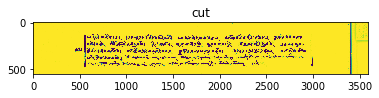

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/157-0.jpg !!!
[0, 669.3333333333334, 3587, 1191.6666666666667]


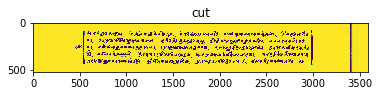

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/157-1.jpg !!!
[0, 1293.3333333333333, 3587, 1734.6666666666667]


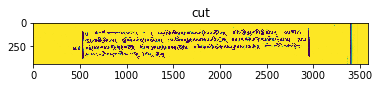

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/157-2.jpg !!!
[0, 1960.3333333333333, 3587, 2344.6666666666665]


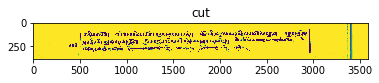

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/157-3.jpg !!!
16.jpg
(3452, 2551)
Processing 16


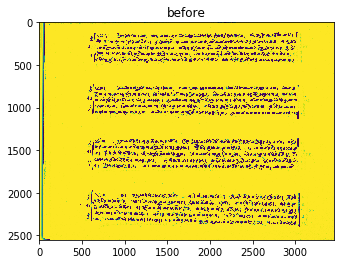

{2: 31, 1: 79, 3: 28, 4: 24}
threshold 4.602641270888302
[0, 113, 3452, 490]
[0, 730, 3452, 1110]
[0, 1349, 3452, 1738]
[0, 1986, 3452, 2387]
[0, 6.666666666666629, 3452, 556.6666666666666]


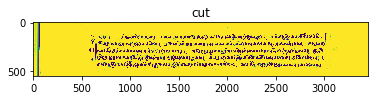

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/16-0.jpg !!!
[0, 663.3333333333334, 3452, 1176.6666666666667]


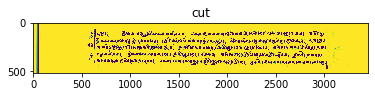

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/16-1.jpg !!!
[0, 1282.3333333333333, 3452, 1804.6666666666667]


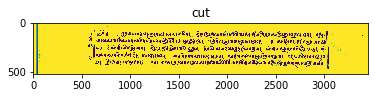

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/16-2.jpg !!!
[0, 1919.3333333333333, 3452, 2453.6666666666665]


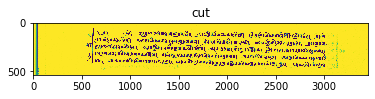

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/16-3.jpg !!!
17.jpg
(3443, 2601)
Processing 17


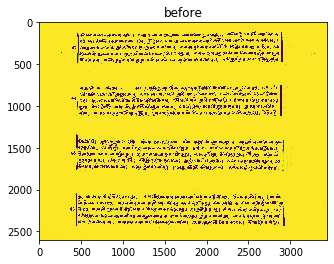

{1: 25, 2: 29, 3: 39, 4: 45}
threshold 1.4725239827985446
[0, 99, 3443, 511]
[0, 736, 3443, 1144]
[0, 1373, 3443, 1794]
[0, 2030, 3443, 2446]
[0, 27.66666666666663, 3443, 577.6666666666666]


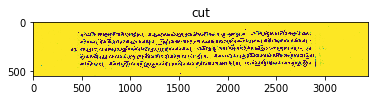

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/17-0.jpg !!!
[0, 669.3333333333334, 3443, 1210.6666666666667]


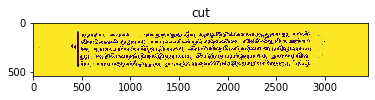

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/17-1.jpg !!!
[0, 1306.3333333333333, 3443, 1860.6666666666667]


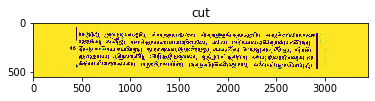

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/17-2.jpg !!!
[0, 1963.3333333333333, 3443, 2512.6666666666665]


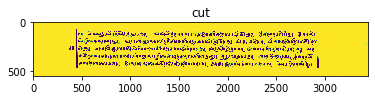

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/17-3.jpg !!!
18.jpg
(3436, 2555)
Processing 18


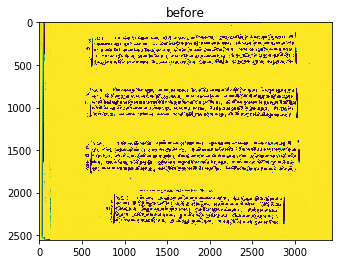

{1: 32, 2: 27, 3: 29, 4: 36}
threshold 2.550397877984084
[0, 131, 3436, 522]
[0, 748, 3436, 1136]
[0, 1373, 3436, 1773]
[0, 1943, 3436, 2390]
[0, 38.66666666666663, 3436, 588.6666666666666]


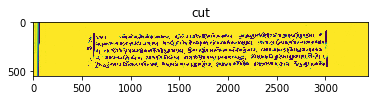

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/18-0.jpg !!!
[0, 681.3333333333334, 3436, 1202.6666666666667]


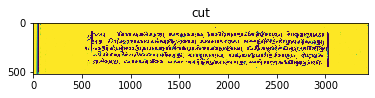

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/18-1.jpg !!!
[0, 1306.3333333333333, 3436, 1839.6666666666667]


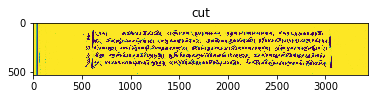

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/18-2.jpg !!!
[0, 1876.3333333333333, 3436, 2456.6666666666665]


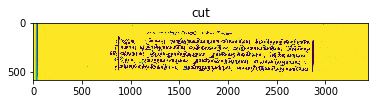

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/18-3.jpg !!!
19.jpg
(3439, 2597)
Processing 19


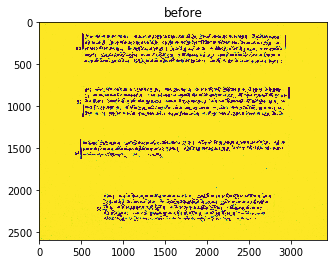

{4: 33, 1: 115, 2: 32, 3: 31}
threshold 3.493690497814916
[0, 127, 3439, 512]
[0, 756, 3439, 1141]
[0, 1384, 3439, 1621]
[0, 2024, 3439, 2387]
[0, 28.66666666666663, 3439, 578.6666666666666]


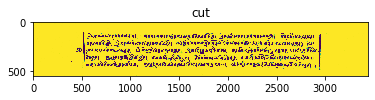

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/19-0.jpg !!!
[0, 689.3333333333334, 3439, 1207.6666666666667]


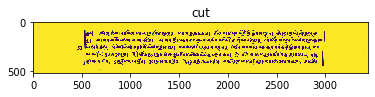

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/19-1.jpg !!!
[0, 1317.3333333333333, 3439, 1687.6666666666667]


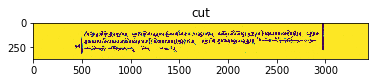

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/19-2.jpg !!!
[0, 1957.3333333333333, 3439, 2453.6666666666665]


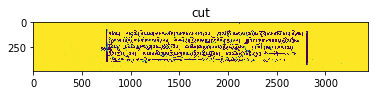

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/19-3.jpg !!!
20.jpg
(3402, 2553)
Processing 20


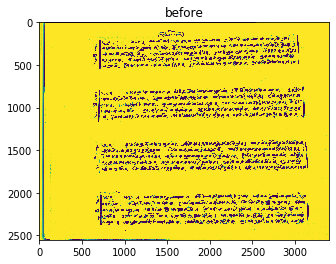

{1: 39, 2: 28, 3: 15, 4: 19}
threshold 3.492018779342722
[0, 110, 3402, 550]
[0, 752, 3402, 1151]
[0, 1371, 3402, 1762]
[0, 1983, 3402, 2391]
[0, 66.66666666666663, 3402, 616.6666666666666]


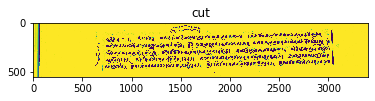

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/20-0.jpg !!!
[0, 685.3333333333334, 3402, 1217.6666666666667]


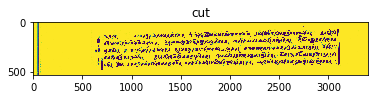

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/20-1.jpg !!!
[0, 1304.3333333333333, 3402, 1828.6666666666667]


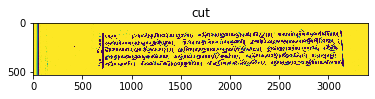

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/20-2.jpg !!!
[0, 1916.3333333333333, 3402, 2457.6666666666665]


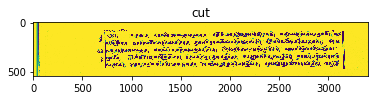

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/20-3.jpg !!!
21.jpg
(3485, 2658)
Processing 21


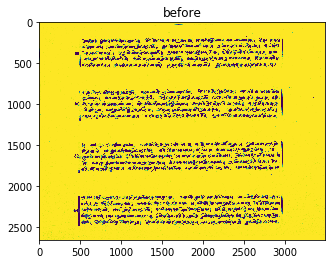

{1: 60, 3: 23, 4: 25, 2: 14}
threshold 2.4640410160801673
[0, 178, 3485, 579]
[0, 799, 3485, 1199]
[0, 1441, 3485, 1841]
[0, 2083, 3485, 2496]
[0, 95.66666666666663, 3485, 645.6666666666666]


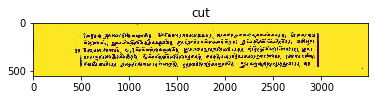

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/21-0.jpg !!!
[0, 732.3333333333334, 3485, 1265.6666666666667]


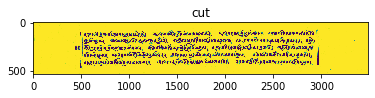

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/21-1.jpg !!!
[0, 1374.3333333333333, 3485, 1907.6666666666667]


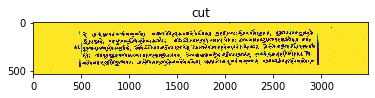

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/21-2.jpg !!!
[0, 2016.3333333333333, 3485, 2562.6666666666665]


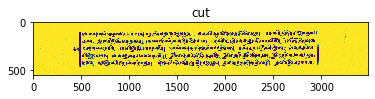

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/21-3.jpg !!!
22.jpg
(3597, 2595)
Processing 22


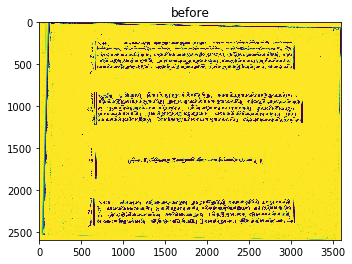

{4: 32, 1: 197, 2: 324, 3: 69}
threshold 4.381669027384325
[0, 209, 3597, 585]
[0, 819, 3597, 1212]
[0, 2093, 3597, 2424]
[0, 101.66666666666663, 3597, 651.6666666666666]


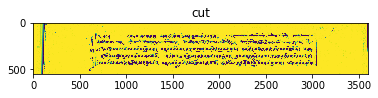

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/22-0.jpg !!!
[0, 752.3333333333334, 3597, 1278.6666666666667]


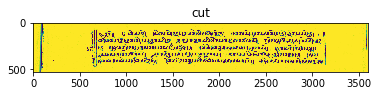

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/22-1.jpg !!!
[0, 2026.3333333333333, 3597, 2490.6666666666665]


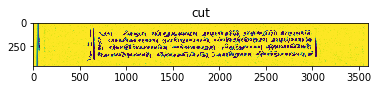

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/22-2.jpg !!!
23.jpg
(3440, 2595)
Processing 23


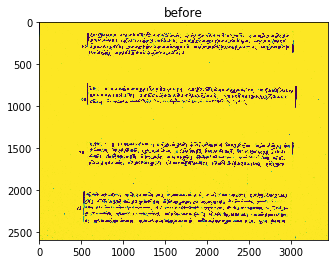

{1: 90, 2: 36, 3: 20, 4: 18}
threshold 4.6018395879323055
[0, 112, 3440, 408]
[0, 754, 3440, 989]
[0, 1412, 3440, 1734]
[0, 2013, 3440, 2419]
[0, 0, 3440, 474.6666666666667]


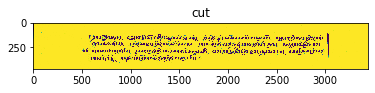

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/23-0.jpg !!!
[0, 687.3333333333334, 3440, 1055.6666666666667]


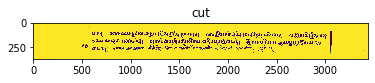

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/23-1.jpg !!!
[0, 1345.3333333333333, 3440, 1800.6666666666667]


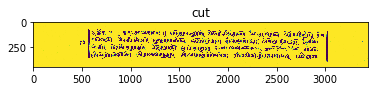

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/23-2.jpg !!!
[0, 1946.3333333333333, 3440, 2485.6666666666665]


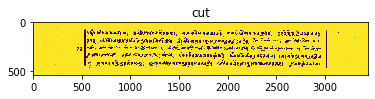

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/23-3.jpg !!!
24.jpg
(3567, 2550)
Processing 24


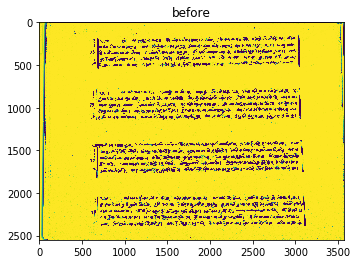

{1: 236, 2: 35, 3: 22, 4: 23}
threshold 3.4559031689632245
[0, 153, 3567, 544]
[0, 764, 3567, 1158]
[0, 1378, 3567, 1785]
[0, 2007, 3567, 2408]
[0, 60.66666666666663, 3567, 610.6666666666666]


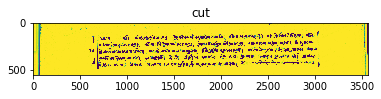

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/24-0.jpg !!!
[0, 697.3333333333334, 3567, 1224.6666666666667]


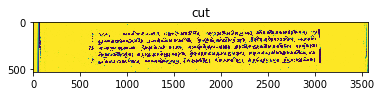

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/24-1.jpg !!!
[0, 1311.3333333333333, 3567, 1851.6666666666667]


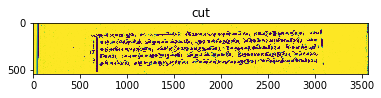

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/24-2.jpg !!!
[0, 1940.3333333333333, 3567, 2474.6666666666665]


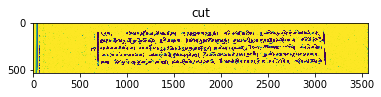

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/24-3.jpg !!!
25.jpg
(3436, 2600)
Processing 25


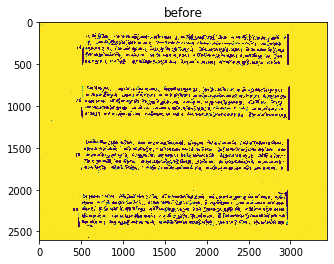

{1: 47, 2: 26, 3: 33, 4: 32}
threshold 2.5110946745562135
[0, 121, 3436, 533]
[0, 749, 3436, 1161]
[0, 1387, 3436, 1792]
[0, 2026, 3436, 2447]
[0, 49.66666666666663, 3436, 599.6666666666666]


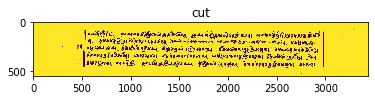

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/25-0.jpg !!!
[0, 682.3333333333334, 3436, 1227.6666666666667]


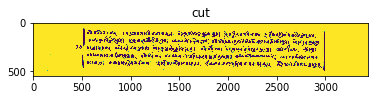

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/25-1.jpg !!!
[0, 1320.3333333333333, 3436, 1858.6666666666667]


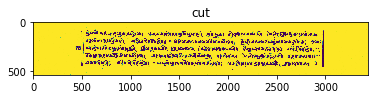

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/25-2.jpg !!!
[0, 1959.3333333333333, 3436, 2513.6666666666665]


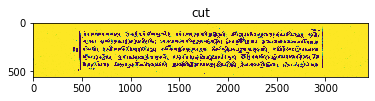

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/25-3.jpg !!!
26.jpg
(3495, 2644)
Processing 26


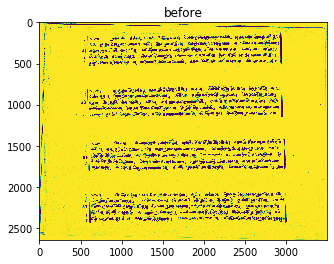

{1: 171, 3: 53, 2: 140, 4: 49}
threshold 4.43047619047619
[0, 139, 3495, 531]
[0, 766, 3495, 1163]
[0, 1410, 3495, 1811]
[0, 2050, 3495, 2441]
[0, 47.66666666666663, 3495, 597.6666666666666]


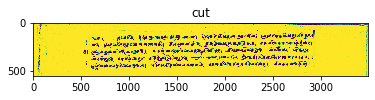

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/26-0.jpg !!!
[0, 699.3333333333334, 3495, 1229.6666666666667]


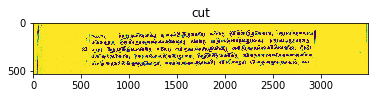

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/26-1.jpg !!!
[0, 1343.3333333333333, 3495, 1877.6666666666667]


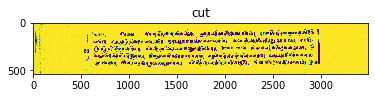

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/26-2.jpg !!!
[0, 1983.3333333333333, 3495, 2507.6666666666665]


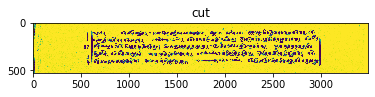

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/26-3.jpg !!!
27.jpg
(3433, 2597)
Processing 27


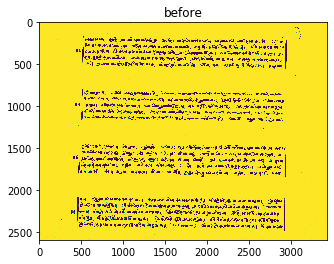

{1: 64, 2: 33, 3: 23, 4: 19}
threshold 4.489894666969447
[0, 172, 3433, 562]
[0, 807, 3433, 1198]
[0, 1443, 3433, 1842]
[0, 2073, 3433, 2477]
[0, 78.66666666666663, 3433, 628.6666666666666]


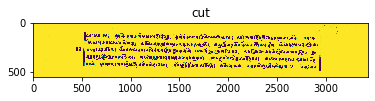

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/27-0.jpg !!!
[0, 740.3333333333334, 3433, 1264.6666666666667]


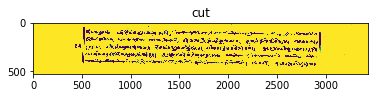

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/27-1.jpg !!!
[0, 1376.3333333333333, 3433, 1908.6666666666667]


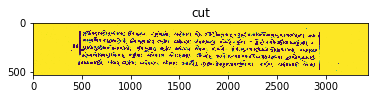

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/27-2.jpg !!!
[0, 2006.3333333333333, 3433, 2543.6666666666665]


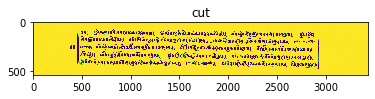

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/27-3.jpg !!!
28.jpg
(3491, 2604)
Processing 28


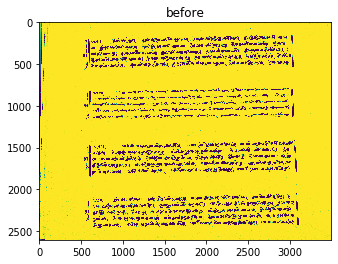

{1: 186, 2: 20, 3: 19, 4: 22}
threshold 3.510103000908328
[0, 144, 3491, 562]
[0, 772, 3491, 1170]
[0, 1407, 3491, 1828]
[0, 2044, 3491, 2467]
[0, 78.66666666666663, 3491, 628.6666666666666]


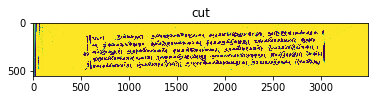

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/28-0.jpg !!!
[0, 705.3333333333334, 3491, 1236.6666666666667]


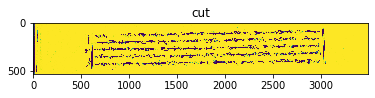

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/28-1.jpg !!!
[0, 1340.3333333333333, 3491, 1894.6666666666667]


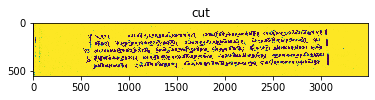

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/28-2.jpg !!!
[0, 1977.3333333333333, 3491, 2533.6666666666665]


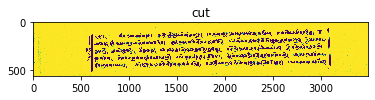

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/28-3.jpg !!!
29.jpg
(3433, 2595)
Processing 29


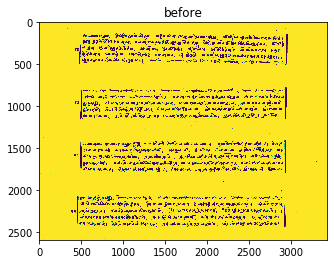

{2: 64, 3: 39, 1: 42, 4: 31}
threshold 4.526535550249992
[0, 124, 3433, 514]
[0, 778, 3433, 1168]
[0, 1405, 3433, 1800]
[0, 2052, 3433, 2449]
[0, 30.66666666666663, 3433, 580.6666666666666]


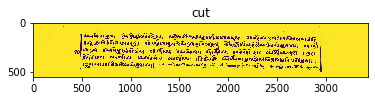

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/29-0.jpg !!!
[0, 711.3333333333334, 3433, 1234.6666666666667]


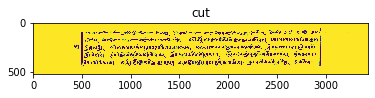

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/29-1.jpg !!!
[0, 1338.3333333333333, 3433, 1866.6666666666667]


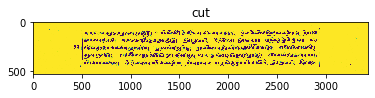

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/29-2.jpg !!!
[0, 1985.3333333333333, 3433, 2515.6666666666665]


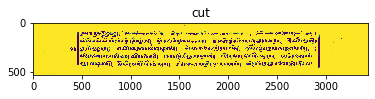

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/29-3.jpg !!!
30.jpg
(3541, 2595)
Processing 30


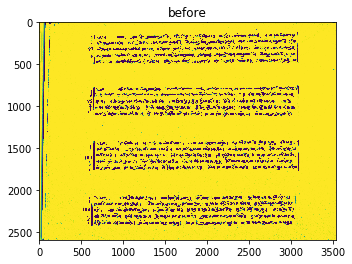

{3: 47, 2: 56, 1: 155, 4: 42}
threshold 4.484040524251993
[0, 120, 3541, 512]
[0, 751, 3541, 1140]
[0, 1394, 3541, 1780]
[0, 2044, 3541, 2442]
[0, 28.66666666666663, 3541, 578.6666666666666]


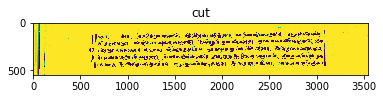

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/30-0.jpg !!!
[0, 684.3333333333334, 3541, 1206.6666666666667]


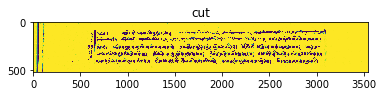

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/30-1.jpg !!!
[0, 1327.3333333333333, 3541, 1846.6666666666667]


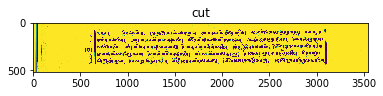

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/30-2.jpg !!!
[0, 1977.3333333333333, 3541, 2508.6666666666665]


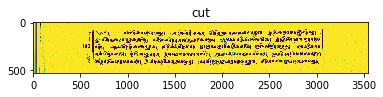

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/30-3.jpg !!!
31.jpg
(3431, 2593)
Processing 31


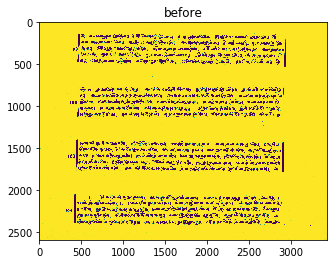

{1: 26, 3: 25, 4: 36, 2: 25}
threshold 3.4751776818332814
[0, 124, 3431, 520]
[0, 752, 3431, 1150]
[0, 1401, 3431, 1793]
[0, 2044, 3431, 2432]
[0, 36.66666666666663, 3431, 586.6666666666666]


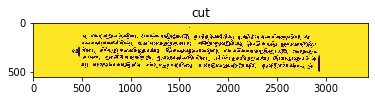

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/31-0.jpg !!!
[0, 685.3333333333334, 3431, 1216.6666666666667]


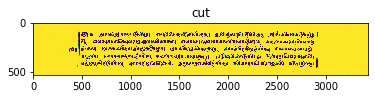

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/31-1.jpg !!!
[0, 1334.3333333333333, 3431, 1859.6666666666667]


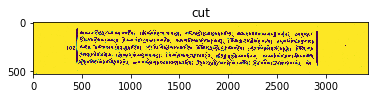

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/31-2.jpg !!!
[0, 1977.3333333333333, 3431, 2498.6666666666665]


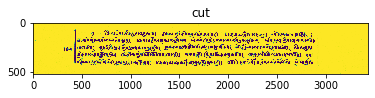

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/31-3.jpg !!!
32.jpg
(3532, 2608)
Processing 32


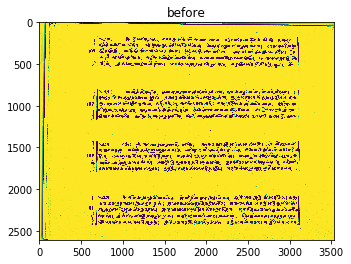

{4: 35, 1: 127, 3: 33, 2: 22}
threshold 2.54142322972657
[0, 161, 3532, 559]
[0, 784, 3532, 1180]
[0, 1411, 3532, 1810]
[0, 2045, 3532, 2453]
[0, 75.66666666666663, 3532, 625.6666666666666]


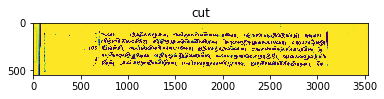

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/32-0.jpg !!!
[0, 717.3333333333334, 3532, 1246.6666666666667]


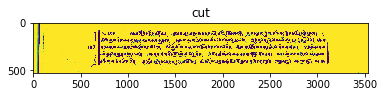

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/32-1.jpg !!!
[0, 1344.3333333333333, 3532, 1876.6666666666667]


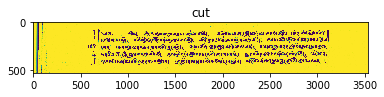

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/32-2.jpg !!!
[0, 1978.3333333333333, 3532, 2519.6666666666665]


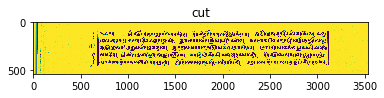

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/32-3.jpg !!!
33.jpg
(3426, 2595)
Processing 33


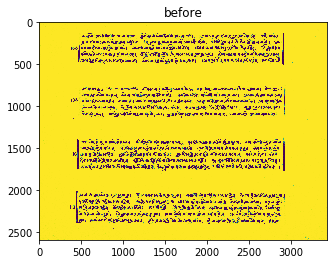

{2: 49, 4: 30, 3: 33, 1: 40}
threshold 4.494732756708805
[0, 119, 3426, 509]
[0, 753, 3426, 1145]
[0, 1377, 3426, 1775]
[0, 2019, 3426, 2416]
[0, 25.66666666666663, 3426, 575.6666666666666]


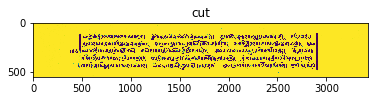

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/33-0.jpg !!!
[0, 686.3333333333334, 3426, 1211.6666666666667]


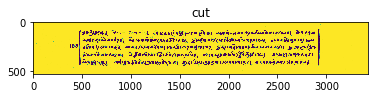

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/33-1.jpg !!!
[0, 1310.3333333333333, 3426, 1841.6666666666667]


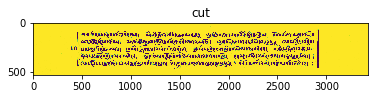

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/33-2.jpg !!!
[0, 1952.3333333333333, 3426, 2482.6666666666665]


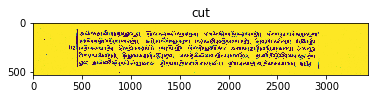

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/33-3.jpg !!!
34 .jpg
(3528, 2609)
Processing 34 


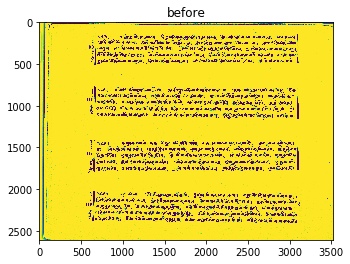

{2: 33, 1: 91, 3: 14, 4: 18}
threshold 3.4368220261077402
[0, 134, 3528, 515]
[0, 765, 3528, 1168]
[0, 1404, 3528, 1805]
[0, 2018, 3528, 2423]
[0, 31.66666666666663, 3528, 581.6666666666666]


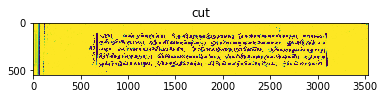

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/34 -0.jpg !!!
[0, 698.3333333333334, 3528, 1234.6666666666667]


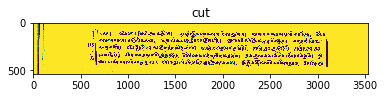

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/34 -1.jpg !!!
[0, 1337.3333333333333, 3528, 1871.6666666666667]


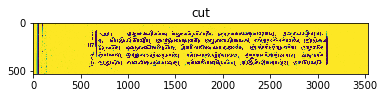

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/34 -2.jpg !!!
[0, 1951.3333333333333, 3528, 2489.6666666666665]


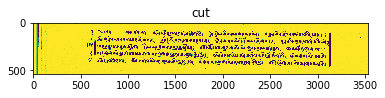

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/34 -3.jpg !!!
35.jpg
(3423, 2595)
Processing 35


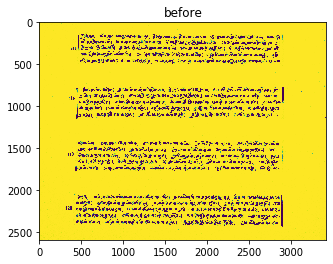

{1: 58, 2: 25, 3: 24, 4: 30}
threshold 3.6874930624930613
[0, 127, 3423, 515]
[0, 755, 3423, 1157]
[0, 1396, 3423, 1788]
[0, 2037, 3423, 2439]
[0, 31.66666666666663, 3423, 581.6666666666666]


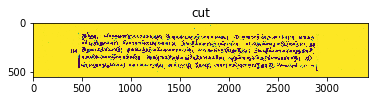

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/35-0.jpg !!!
[0, 688.3333333333334, 3423, 1223.6666666666667]


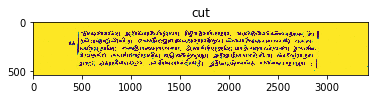

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/35-1.jpg !!!
[0, 1329.3333333333333, 3423, 1854.6666666666667]


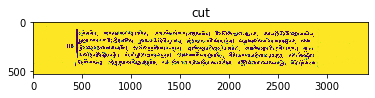

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/35-2.jpg !!!
[0, 1970.3333333333333, 3423, 2505.6666666666665]


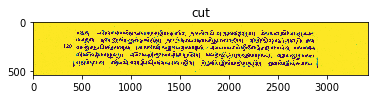

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/35-3.jpg !!!
36.jpg
(3541, 2593)
Processing 36


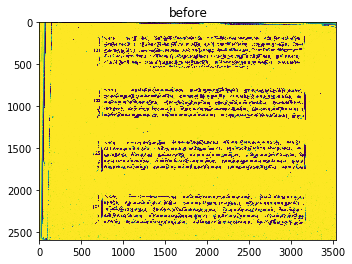

{2: 41, 1: 160, 4: 34, 3: 32}
threshold 3.6619673181672523
[0, 143, 3541, 566]
[0, 764, 3541, 1160]
[0, 1390, 3541, 1776]
[0, 2032, 3541, 2435]
[0, 82.66666666666663, 3541, 632.6666666666666]


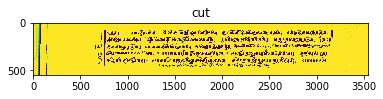

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/36-0.jpg !!!
[0, 697.3333333333334, 3541, 1226.6666666666667]


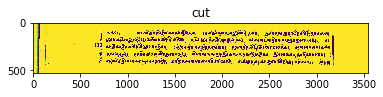

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/36-1.jpg !!!
[0, 1323.3333333333333, 3541, 1842.6666666666667]


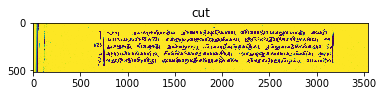

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/36-2.jpg !!!
[0, 1965.3333333333333, 3541, 2501.6666666666665]


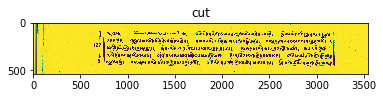

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/36-3.jpg !!!
37.jpg
(3399, 2591)
Processing 37


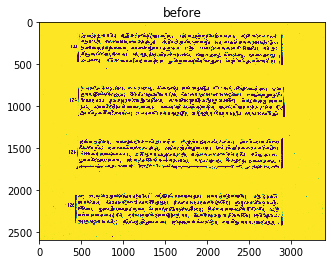

{1: 64, 2: 28, 3: 23, 4: 32}
threshold 3.468161186274939
[0, 114, 3399, 518]
[0, 741, 3399, 1140]
[0, 1372, 3399, 1762]
[0, 2017, 3399, 2432]
[0, 34.66666666666663, 3399, 584.6666666666666]


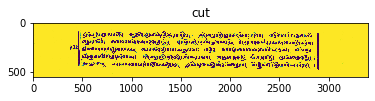

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/37-0.jpg !!!
[0, 674.3333333333334, 3399, 1206.6666666666667]


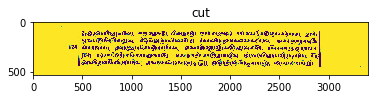

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/37-1.jpg !!!
[0, 1305.3333333333333, 3399, 1828.6666666666667]


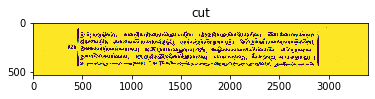

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/37-2.jpg !!!
[0, 1950.3333333333333, 3399, 2498.6666666666665]


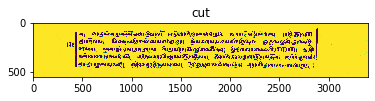

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/37-3.jpg !!!
38.jpg
(3527, 2612)
Processing 38


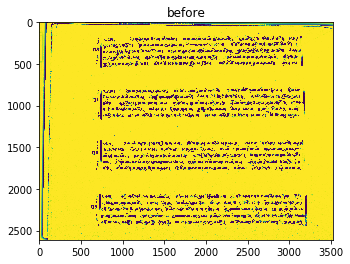

{4: 38, 2: 56, 1: 177, 3: 55}
threshold 4.3746972032591955
[0, 154, 3527, 547]
[0, 775, 3527, 1164]
[0, 1408, 3527, 1800]
[0, 2041, 3527, 2453]
[0, 63.66666666666663, 3527, 613.6666666666666]


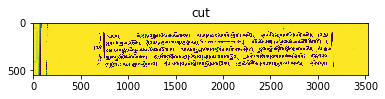

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/38-0.jpg !!!
[0, 708.3333333333334, 3527, 1230.6666666666667]


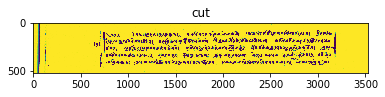

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/38-1.jpg !!!
[0, 1341.3333333333333, 3527, 1866.6666666666667]


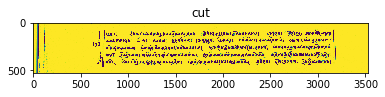

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/38-2.jpg !!!
[0, 1974.3333333333333, 3527, 2519.6666666666665]


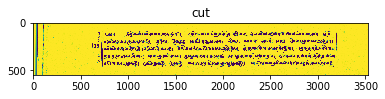

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/38-3.jpg !!!
39.jpg
(3402, 2595)
Processing 39


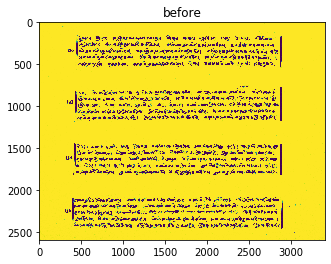

{1: 71, 2: 79, 4: 36, 3: 49}
threshold 4.5056449809970935
[0, 150, 3402, 550]
[0, 789, 3402, 1186]
[0, 1437, 3402, 1838]
[0, 2067, 3402, 2472]
[0, 66.66666666666663, 3402, 616.6666666666666]


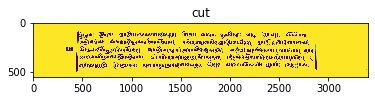

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/39-0.jpg !!!
[0, 722.3333333333334, 3402, 1252.6666666666667]


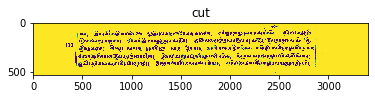

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/39-1.jpg !!!
[0, 1370.3333333333333, 3402, 1904.6666666666667]


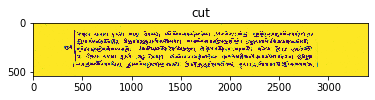

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/39-2.jpg !!!
[0, 2000.3333333333333, 3402, 2538.6666666666665]


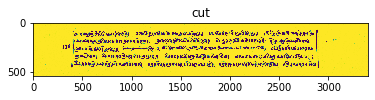

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/39-3.jpg !!!
40 (2).jpg
(3537, 2609)
Processing 40 (2)


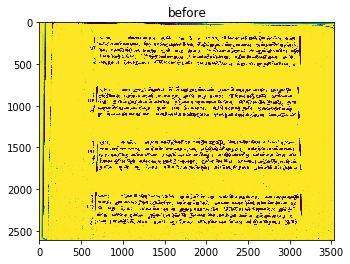

{1: 208, 3: 36, 4: 31, 2: 30}
threshold 2.435215484974869
[0, 146, 3537, 548]
[0, 758, 3537, 1164]
[0, 1389, 3537, 1796]
[0, 2036, 3537, 2449]
[0, 64.66666666666663, 3537, 614.6666666666666]


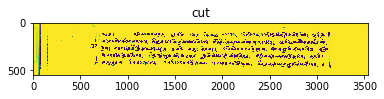

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/40 (2)-0.jpg !!!
[0, 691.3333333333334, 3537, 1230.6666666666667]


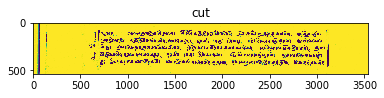

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/40 (2)-1.jpg !!!
[0, 1322.3333333333333, 3537, 1862.6666666666667]


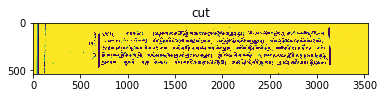

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/40 (2)-2.jpg !!!
[0, 1969.3333333333333, 3537, 2515.6666666666665]


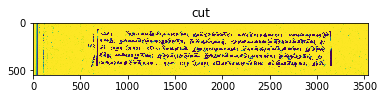

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/40 (2)-3.jpg !!!
41.jpg
(3397, 2595)
Processing 41


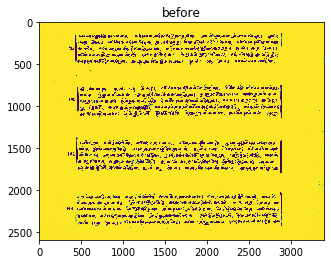

{1: 79, 3: 39, 4: 41, 2: 43}
threshold 3.4327536756156154
[0, 119, 3397, 519]
[0, 735, 3397, 1142]
[0, 1386, 3397, 1789]
[0, 2029, 3397, 2435]
[0, 35.66666666666663, 3397, 585.6666666666666]


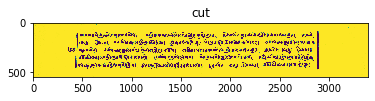

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/41-0.jpg !!!
[0, 668.3333333333334, 3397, 1208.6666666666667]


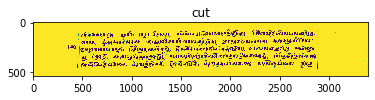

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/41-1.jpg !!!
[0, 1319.3333333333333, 3397, 1855.6666666666667]


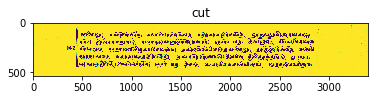

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/41-2.jpg !!!
[0, 1962.3333333333333, 3397, 2501.6666666666665]


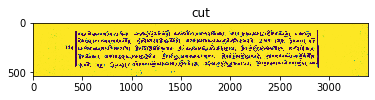

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/41-3.jpg !!!
42 (2).jpg
(3513, 2602)
Processing 42 (2)


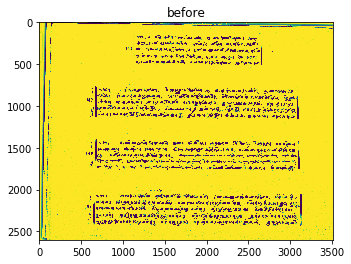

{2: 65, 1: 204, 3: 40, 4: 39}
threshold 4.477728866671641
[0, 148, 3513, 527]
[0, 769, 3513, 1165]
[0, 1399, 3513, 1785]
[0, 2027, 3513, 2445]
[0, 43.66666666666663, 3513, 593.6666666666666]


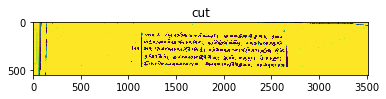

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/42 (2)-0.jpg !!!
[0, 702.3333333333334, 3513, 1231.6666666666667]


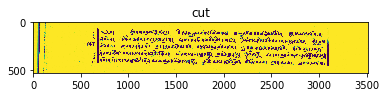

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/42 (2)-1.jpg !!!
[0, 1332.3333333333333, 3513, 1851.6666666666667]


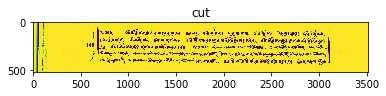

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/42 (2)-2.jpg !!!
[0, 1960.3333333333333, 3513, 2511.6666666666665]


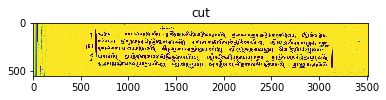

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/42 (2)-3.jpg !!!
43.jpg
(3403, 2590)
Processing 43


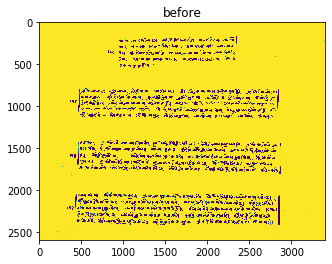

{2: 32, 1: 69, 4: 26, 3: 28}
threshold 4.506343639598754
[0, 174, 3403, 548]
[0, 776, 3403, 1160]
[0, 1394, 3403, 1798]
[0, 2019, 3403, 2424]
[0, 64.66666666666663, 3403, 614.6666666666666]


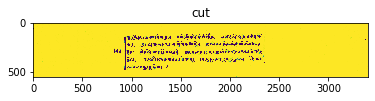

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/43-0.jpg !!!
[0, 709.3333333333334, 3403, 1226.6666666666667]


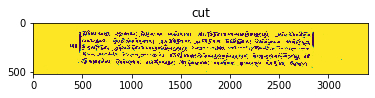

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/43-1.jpg !!!
[0, 1327.3333333333333, 3403, 1864.6666666666667]


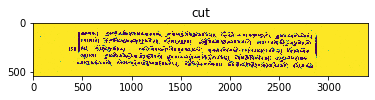

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/43-2.jpg !!!
[0, 1952.3333333333333, 3403, 2490.6666666666665]


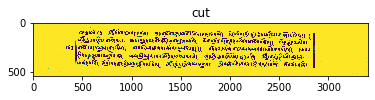

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/43-3.jpg !!!
44 (2).jpg
(3515, 2603)
Processing 44 (2)


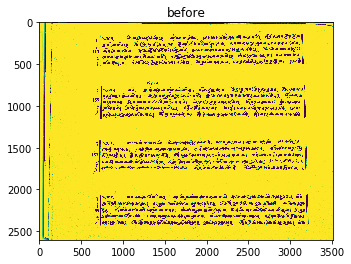

{2: 57, 1: 206, 4: 41, 3: 40}
threshold 3.4050242326332807
[0, 131, 3515, 533]
[0, 752, 3515, 1157]
[0, 1388, 3515, 1788]
[0, 2039, 3515, 2451]
[0, 49.66666666666663, 3515, 599.6666666666666]


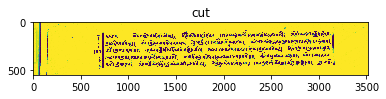

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/44 (2)-0.jpg !!!
[0, 685.3333333333334, 3515, 1223.6666666666667]


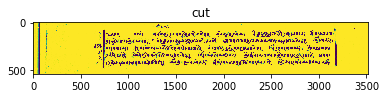

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/44 (2)-1.jpg !!!
[0, 1321.3333333333333, 3515, 1854.6666666666667]


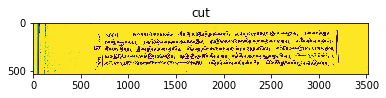

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/44 (2)-2.jpg !!!
[0, 1972.3333333333333, 3515, 2517.6666666666665]


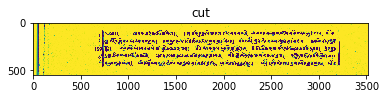

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/44 (2)-3.jpg !!!
45.jpg
(3445, 2655)
Processing 45


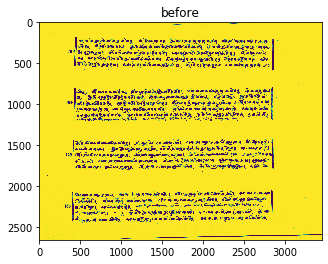

{1: 58, 2: 18, 3: 20, 4: 23}
threshold 2.4449586776859524
[0, 177, 3445, 579]
[0, 789, 3445, 1225]
[0, 1415, 3445, 1815]
[0, 2042, 3445, 2455]
[0, 95.66666666666663, 3445, 645.6666666666666]


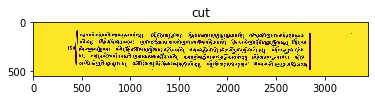

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/45-0.jpg !!!
[0, 722.3333333333334, 3445, 1291.6666666666667]


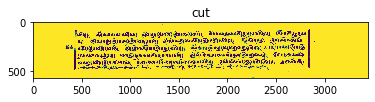

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/45-1.jpg !!!
[0, 1348.3333333333333, 3445, 1881.6666666666667]


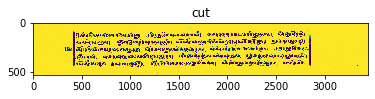

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/45-2.jpg !!!
[0, 1975.3333333333333, 3445, 2521.6666666666665]


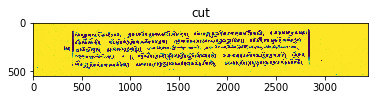

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/45-3.jpg !!!
46 (2).jpg
(3495, 2601)
Processing 46 (2)


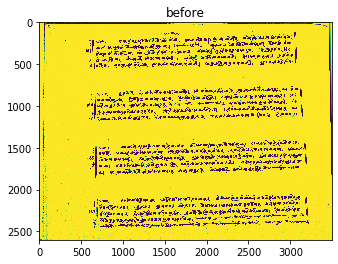

{2: 68, 1: 198, 4: 14, 3: 14}
threshold 4.378745644599306
[0, 123, 3495, 558]
[0, 766, 3495, 1190]
[0, 1401, 3495, 1831]
[0, 2046, 3495, 2470]
[0, 74.66666666666663, 3495, 624.6666666666666]


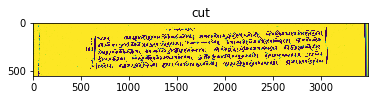

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/46 (2)-0.jpg !!!
[0, 699.3333333333334, 3495, 1256.6666666666667]


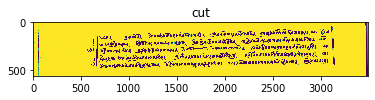

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/46 (2)-1.jpg !!!
[0, 1334.3333333333333, 3495, 1897.6666666666667]


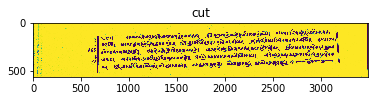

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/46 (2)-2.jpg !!!
[0, 1979.3333333333333, 3495, 2536.6666666666665]


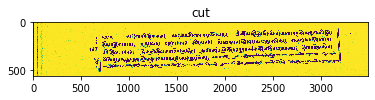

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/46 (2)-3.jpg !!!
47.jpg
(3400, 2589)
Processing 47


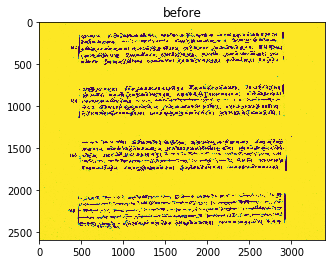

{1: 25, 2: 28, 3: 19, 4: 29}
threshold 3.5307311903920877
[0, 107, 3400, 514]
[0, 730, 3400, 1137]
[0, 1376, 3400, 1783]
[0, 2022, 3400, 2463]
[0, 30.66666666666663, 3400, 580.6666666666666]


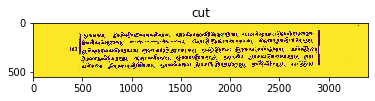

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/47-0.jpg !!!
[0, 663.3333333333334, 3400, 1203.6666666666667]


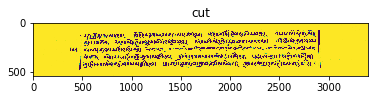

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/47-1.jpg !!!
[0, 1309.3333333333333, 3400, 1849.6666666666667]


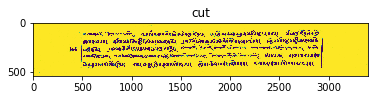

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/47-2.jpg !!!
[0, 1955.3333333333333, 3400, 2529.6666666666665]


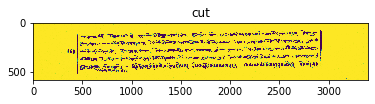

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/47-3.jpg !!!
48 (2).jpg
(3558, 2661)
Processing 48 (2)


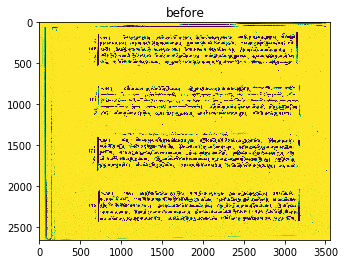

{2: 185, 1: 219, 3: 62, 4: 55}
threshold 4.474372791007591
[0, 139, 3558, 537]
[0, 765, 3558, 1165]
[0, 1334, 3558, 1804]
[0, 2044, 3558, 2453]
[0, 53.66666666666663, 3558, 603.6666666666666]


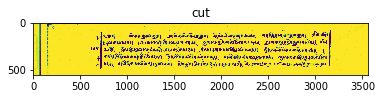

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/48 (2)-0.jpg !!!
[0, 698.3333333333334, 3558, 1231.6666666666667]


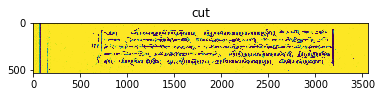

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/48 (2)-1.jpg !!!
[0, 1267.3333333333333, 3558, 1870.6666666666667]


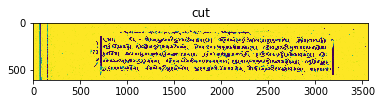

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/48 (2)-2.jpg !!!
[0, 1977.3333333333333, 3558, 2519.6666666666665]


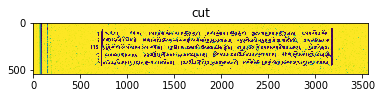

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/48 (2)-3.jpg !!!
49.jpg
(3400, 2587)
Processing 49


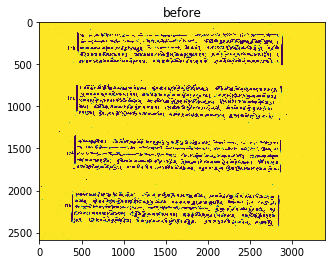

{1: 90, 2: 38, 3: 36, 4: 19}
threshold 4.4047509713882
[0, 115, 3400, 512]
[0, 729, 3400, 1158]
[0, 1372, 3400, 1783]
[0, 2004, 3400, 2424]
[0, 28.66666666666663, 3400, 578.6666666666666]


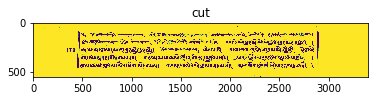

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/49-0.jpg !!!
[0, 662.3333333333334, 3400, 1224.6666666666667]


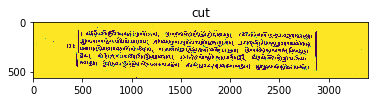

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/49-1.jpg !!!
[0, 1305.3333333333333, 3400, 1849.6666666666667]


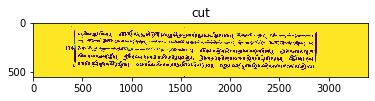

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/49-2.jpg !!!
[0, 1937.3333333333333, 3400, 2490.6666666666665]


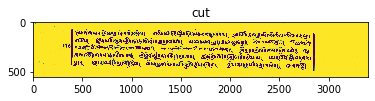

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/49-3.jpg !!!
5.jpg
(3456, 2626)
Processing 5


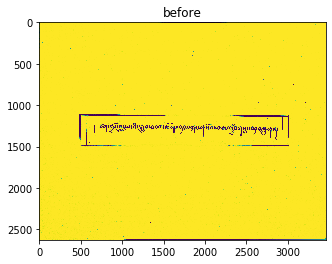

{1: 16, 3: 119, 4: 35, 2: 3}
threshold 2.133618796662271
[0, 1086, 3456, 1527]
[0, 1086, 3456, 1527]


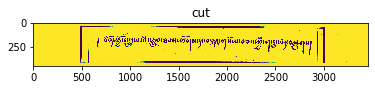

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/5-0.jpg !!!
5 Failed
50 (2).jpg
(3497, 2597)
Processing 50 (2)


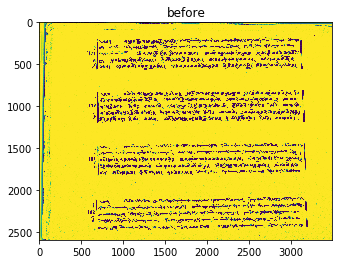

{2: 50, 1: 133, 3: 32, 4: 39}
threshold 3.6018849528761754
[0, 175, 3497, 579]
[0, 801, 3497, 1206]
[0, 1426, 3497, 1836]
[0, 2066, 3497, 2492]
[0, 95.66666666666663, 3497, 645.6666666666666]


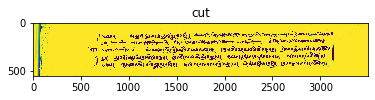

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/50 (2)-0.jpg !!!
[0, 734.3333333333334, 3497, 1272.6666666666667]


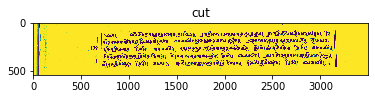

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/50 (2)-1.jpg !!!
[0, 1359.3333333333333, 3497, 1902.6666666666667]


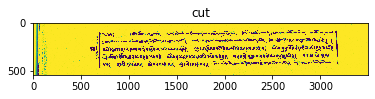

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/50 (2)-2.jpg !!!
[0, 1999.3333333333333, 3497, 2558.6666666666665]


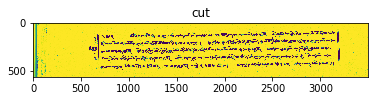

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/50 (2)-3.jpg !!!
51.jpg
(3400, 2587)
Processing 51


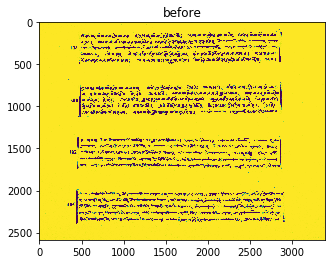

{1: 87, 2: 70, 3: 44, 4: 40}
threshold 4.526115771812082
[0, 109, 3400, 498]
[0, 728, 3400, 1116]
[0, 1361, 3400, 1749]
[0, 1997, 3400, 2387]
[0, 14.666666666666629, 3400, 564.6666666666666]


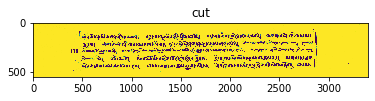

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/51-0.jpg !!!
[0, 661.3333333333334, 3400, 1182.6666666666667]


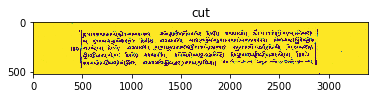

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/51-1.jpg !!!
[0, 1294.3333333333333, 3400, 1815.6666666666667]


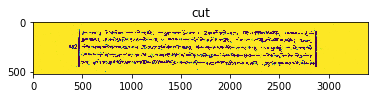

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/51-2.jpg !!!
[0, 1930.3333333333333, 3400, 2453.6666666666665]


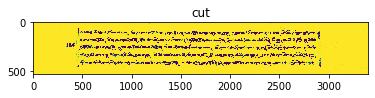

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/51-3.jpg !!!
52.jpg
(3479, 2606)
Processing 52


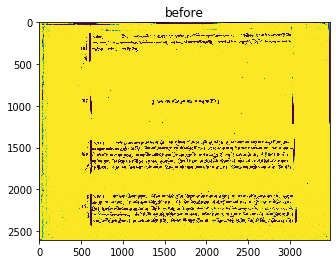

{3: 66, 1: 634, 2: 186, 4: 41}
threshold 4.537717570703004
[0, 110, 3479, 364]
[0, 1396, 3479, 1786]
[0, 2036, 3479, 2424]
[0, 0, 3479, 430.6666666666667]


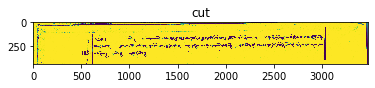

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/52-0.jpg !!!
[0, 1329.3333333333333, 3479, 1852.6666666666667]


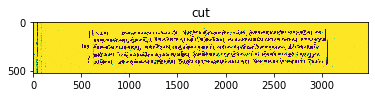

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/52-1.jpg !!!
[0, 1969.3333333333333, 3479, 2490.6666666666665]


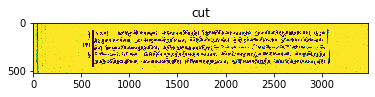

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/52-2.jpg !!!
53.jpg
(3396, 2584)
Processing 53


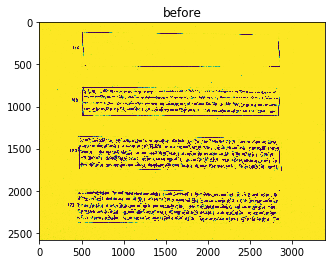

{1: 84, 2: 16, 3: 15, 4: 40}
threshold 3.449260752688173
[0, 748, 3396, 1139]
[0, 1334, 3396, 1785]
[0, 1966, 3396, 2412]
[0, 655.6666666666667, 3396, 1205.6666666666667]


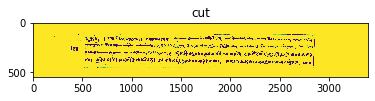

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/53-0.jpg !!!
[0, 1267.3333333333333, 3396, 1851.6666666666667]


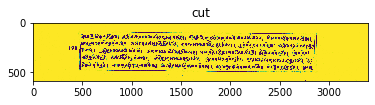

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/53-1.jpg !!!
[0, 1899.3333333333333, 3396, 2478.6666666666665]


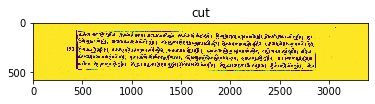

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/53-2.jpg !!!
54 .jpg
(3532, 2596)
Processing 54 


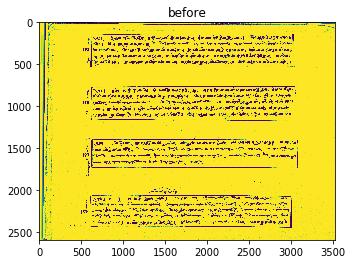

{2: 122, 1: 214, 3: 110, 4: 60}
threshold 4.473259425878322
[0, 111, 3532, 563]
[0, 739, 3532, 1201]
[0, 1369, 3532, 1764]
[0, 1993, 3532, 2470]
[0, 79.66666666666663, 3532, 629.6666666666666]


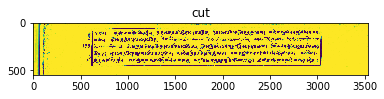

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/54 -0.jpg !!!
[0, 672.3333333333334, 3532, 1267.6666666666667]


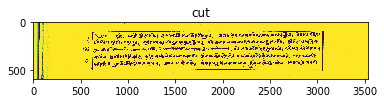

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/54 -1.jpg !!!
[0, 1302.3333333333333, 3532, 1830.6666666666667]


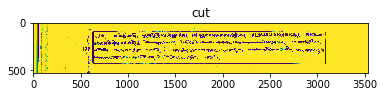

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/54 -2.jpg !!!
[0, 1926.3333333333333, 3532, 2536.6666666666665]


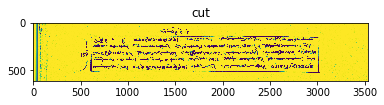

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/54 -3.jpg !!!
55.jpg
(3419, 2585)
Processing 55


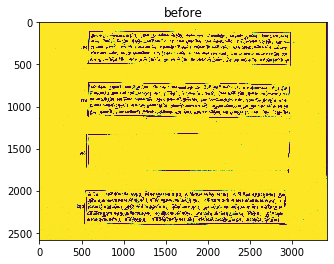

{2: 37, 1: 409, 3: 33, 4: 28}
threshold 4.48612632782356
[0, 84, 3419, 528]
[0, 693, 3419, 1163]
[0, 1963, 3419, 2429]
[0, 44.66666666666663, 3419, 594.6666666666666]


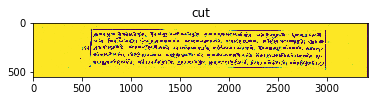

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/55-0.jpg !!!
[0, 626.3333333333334, 3419, 1229.6666666666667]


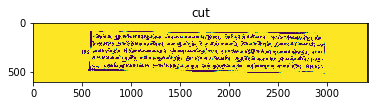

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/55-1.jpg !!!
[0, 1896.3333333333333, 3419, 2495.6666666666665]


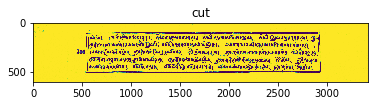

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/55-2.jpg !!!
56.jpg
(3532, 2607)
Processing 56


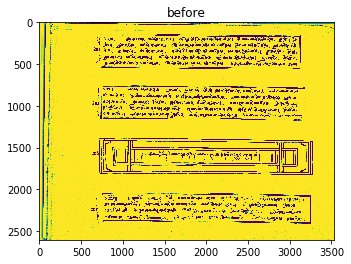

{1: 173, 3: 14, 2: 15, 4: 17}
threshold 3.5454002937936133
[0, 114, 3532, 591]
[0, 734, 3532, 1197]
[0, 1364, 3532, 1853]
[0, 2017, 3532, 2433]
[0, 114, 3532, 686.3333333333334]


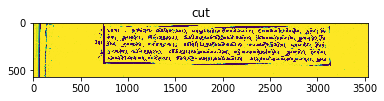

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/56-0.jpg !!!
[0, 638.6666666666666, 3532, 1292.3333333333333]


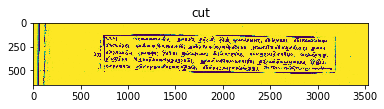

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/56-1.jpg !!!
[0, 1268.6666666666667, 3532, 1948.3333333333333]


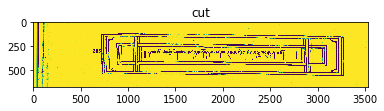

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/56-2.jpg !!!
[0, 1921.6666666666667, 3532, 2528.3333333333335]


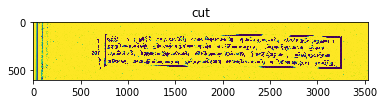

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/56-3.jpg !!!
57.jpg
(3412, 2581)
Processing 57


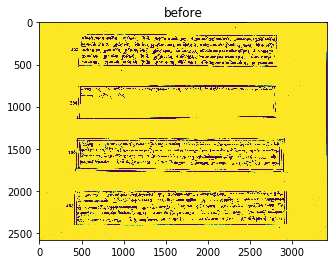

{1: 201, 4: 37, 3: 34, 2: 27}
threshold 2.452366805307981
[0, 115, 3412, 555]
[0, 722, 3412, 909]
[0, 1350, 3412, 1808]
[0, 1972, 3412, 2434]
[0, 71.66666666666663, 3412, 621.6666666666666]


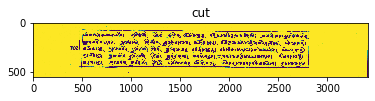

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/57-0.jpg !!!
[0, 655.3333333333334, 3412, 975.6666666666666]


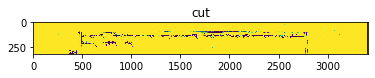

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/57-1.jpg !!!
[0, 1283.3333333333333, 3412, 1874.6666666666667]


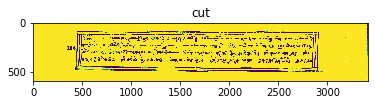

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/57-2.jpg !!!
[0, 1905.3333333333333, 3412, 2500.6666666666665]


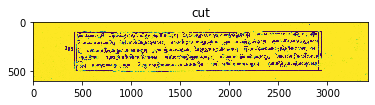

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/57-3.jpg !!!
58.jpg
(3574, 2668)
Processing 58


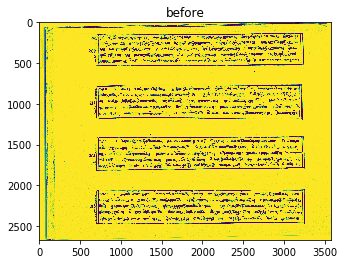

{1: 118, 3: 81, 4: 77, 2: 131}
threshold 4.464250714409242
[0, 112, 3574, 564]
[0, 740, 3574, 1213]
[0, 1376, 3574, 1841]
[0, 2025, 3574, 2501]
[0, 80.66666666666663, 3574, 630.6666666666666]


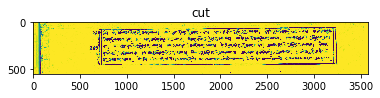

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/58-0.jpg !!!
[0, 673.3333333333334, 3574, 1279.6666666666667]


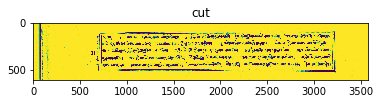

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/58-1.jpg !!!
[0, 1309.3333333333333, 3574, 1907.6666666666667]


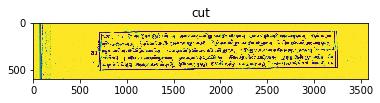

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/58-2.jpg !!!
[0, 1958.3333333333333, 3574, 2567.6666666666665]


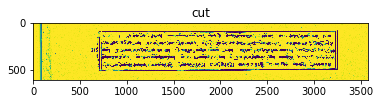

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/58-3.jpg !!!
59.jpg
(3411, 2580)
Processing 59


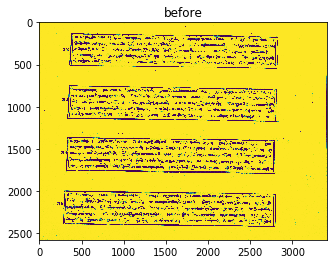

{2: 2, 1: 19, 3: 4, 4: 2}
threshold 2.5613507188231353
[0, 111, 3411, 574]
[0, 728, 3411, 1202]
[0, 1339, 3411, 1819]
[0, 1972, 3411, 2447]
[0, 111, 3411, 665.3333333333334]


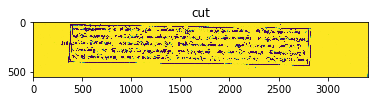

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/59-0.jpg !!!
[0, 636.6666666666666, 3411, 1293.3333333333333]


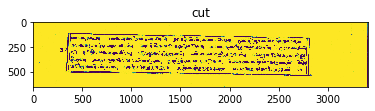

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/59-1.jpg !!!
[0, 1247.6666666666667, 3411, 1910.3333333333333]


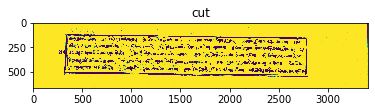

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/59-2.jpg !!!
[0, 1880.6666666666667, 3411, 2538.3333333333335]


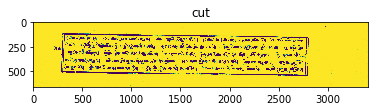

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/59-3.jpg !!!
6.jpg
(3513, 2514)
Processing 6


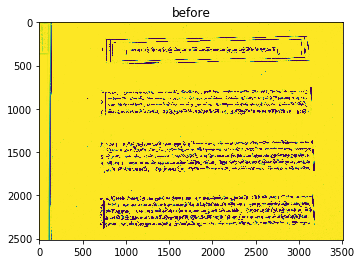

{1: 103, 2: 35, 3: 104, 4: 38}
threshold 2.6354718026880968
[0, 140, 3513, 505]
[0, 760, 3513, 1085]
[0, 1350, 3513, 1744]
[0, 1977, 3513, 2378]
[0, 21.66666666666663, 3513, 571.6666666666666]


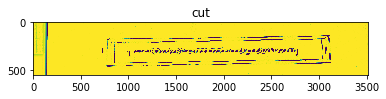

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/6-0.jpg !!!
[0, 693.3333333333334, 3513, 1151.6666666666667]


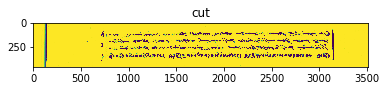

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/6-1.jpg !!!
[0, 1283.3333333333333, 3513, 1810.6666666666667]


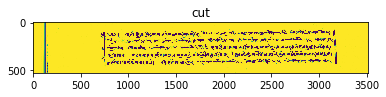

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/6-2.jpg !!!
[0, 1910.3333333333333, 3513, 2444.6666666666665]


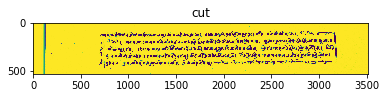

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/6-3.jpg !!!
60.jpg
(3530, 2608)
Processing 60


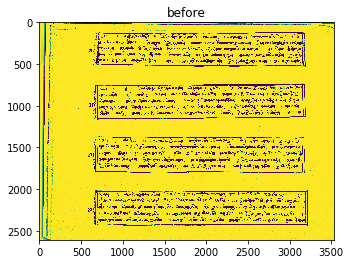

{2: 41, 1: 140, 3: 52, 4: 28}
threshold 4.554317868626554
[0, 97, 3530, 558]
[0, 717, 3530, 1188]
[0, 1347, 3530, 1830]
[0, 1991, 3530, 2462]
[0, 74.66666666666663, 3530, 624.6666666666666]


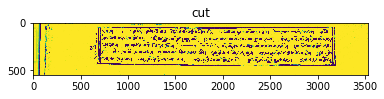

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/60-0.jpg !!!
[0, 650.3333333333334, 3530, 1254.6666666666667]


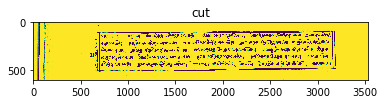

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/60-1.jpg !!!
[0, 1280.3333333333333, 3530, 1896.6666666666667]


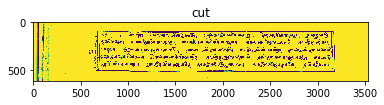

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/60-2.jpg !!!
[0, 1924.3333333333333, 3530, 2528.6666666666665]


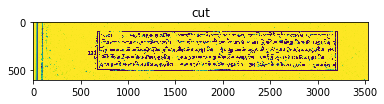

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/60-3.jpg !!!
61.jpg
(3396, 2577)
Processing 61


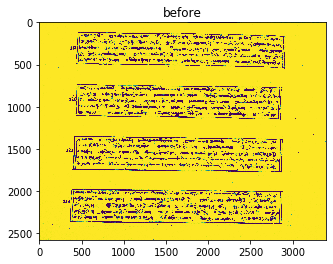

{4: 7, 1: 12, 2: 2, 3: 4}
threshold 2.048219086021504
[0, 92, 3396, 561]
[0, 712, 3396, 1172]
[0, 1323, 3396, 1799]
[0, 1949, 3396, 2411]
[0, 77.66666666666663, 3396, 627.6666666666666]


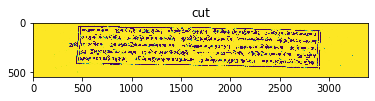

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/61-0.jpg !!!
[0, 645.3333333333334, 3396, 1238.6666666666667]


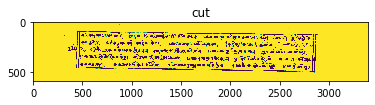

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/61-1.jpg !!!
[0, 1256.3333333333333, 3396, 1865.6666666666667]


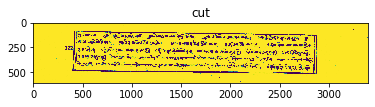

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/61-2.jpg !!!
[0, 1882.3333333333333, 3396, 2477.6666666666665]


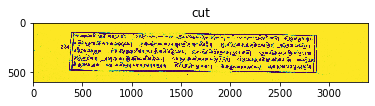

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/61-3.jpg !!!
62.jpg
(3437, 2601)
Processing 62


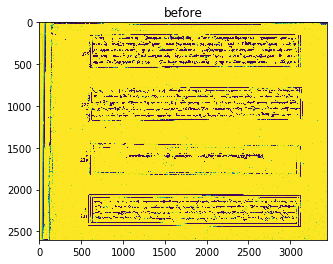

{1: 161, 2: 108, 4: 56, 3: 128}
threshold 4.466901841943273
[0, 118, 3437, 572]
[0, 754, 3437, 1206]
[0, 1426, 3437, 1682]
[0, 2027, 3437, 2469]
[0, 88.66666666666663, 3437, 638.6666666666666]


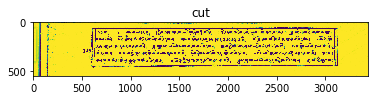

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/62-0.jpg !!!
[0, 687.3333333333334, 3437, 1272.6666666666667]


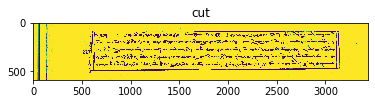

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/62-1.jpg !!!
[0, 1359.3333333333333, 3437, 1748.6666666666667]


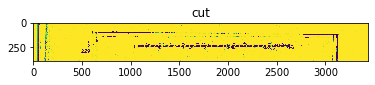

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/62-2.jpg !!!
[0, 1960.3333333333333, 3437, 2535.6666666666665]


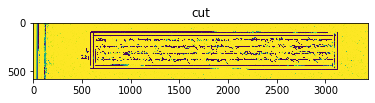

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/62-3.jpg !!!
63.jpg
(3392, 2575)
Processing 63


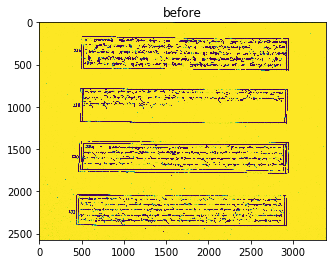

{4: 23, 3: 151, 1: 17, 2: 5}
threshold 2.603768506056525
[0, 143, 3392, 598]
[0, 757, 3392, 1222]
[0, 1378, 3392, 1815]
[0, 2010, 3392, 2439]
[0, 114.66666666666663, 3392, 664.6666666666666]


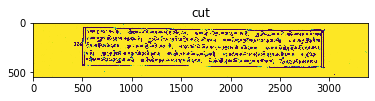

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/63-0.jpg !!!
[0, 690.3333333333334, 3392, 1288.6666666666667]


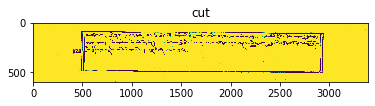

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/63-1.jpg !!!
[0, 1311.3333333333333, 3392, 1881.6666666666667]


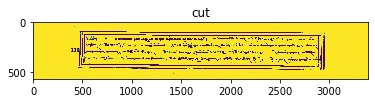

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/63-2.jpg !!!
[0, 1943.3333333333333, 3392, 2505.6666666666665]


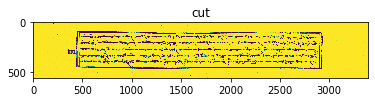

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/63-3.jpg !!!
64.jpg
(3529, 2614)
Processing 64


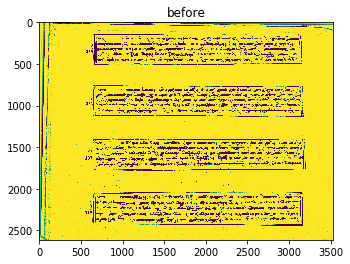

{4: 27, 1: 209, 3: 54, 2: 66}
threshold 4.452628569386369
[0, 119, 3529, 538]
[0, 736, 3529, 1161]
[0, 1371, 3529, 1808]
[0, 2007, 3529, 2467]
[0, 54.66666666666663, 3529, 604.6666666666666]


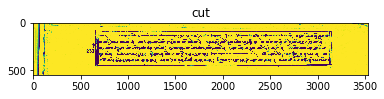

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/64-0.jpg !!!
[0, 669.3333333333334, 3529, 1227.6666666666667]


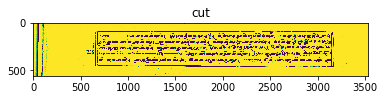

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/64-1.jpg !!!
[0, 1304.3333333333333, 3529, 1874.6666666666667]


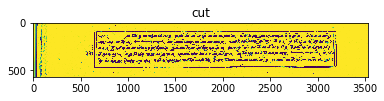

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/64-2.jpg !!!
[0, 1940.3333333333333, 3529, 2533.6666666666665]


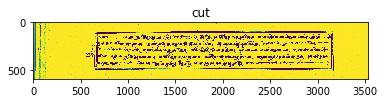

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/64-3.jpg !!!
65.jpg
(3393, 2576)
Processing 65


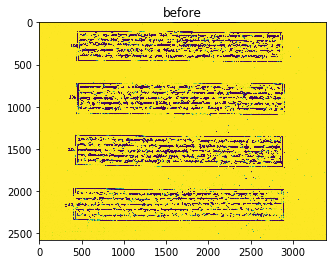

{1: 36, 3: 21, 2: 38, 4: 16}
threshold 4.456945845946855
[0, 79, 3393, 494]
[0, 693, 3393, 1121]
[0, 1310, 3393, 1738]
[0, 1941, 3393, 2380]
[0, 10.666666666666629, 3393, 560.6666666666666]


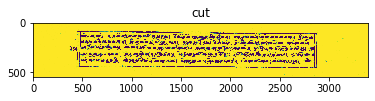

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/65-0.jpg !!!
[0, 626.3333333333334, 3393, 1187.6666666666667]


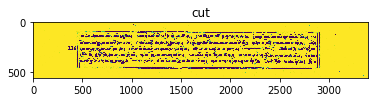

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/65-1.jpg !!!
[0, 1243.3333333333333, 3393, 1804.6666666666667]


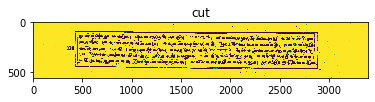

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/65-2.jpg !!!
[0, 1874.3333333333333, 3393, 2446.6666666666665]


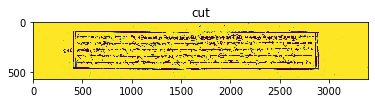

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/65-3.jpg !!!
66.jpg
(3405, 2623)
Processing 66


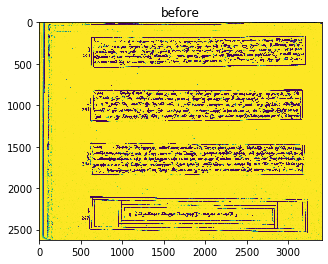

{3: 5, 1: 103, 2: 27, 4: 21}
threshold 3.36877721943049
[0, 144, 3405, 575]
[0, 787, 3405, 1223]
[0, 1428, 3405, 1873]
[0, 2077, 3405, 2553]
[0, 91.66666666666663, 3405, 641.6666666666666]


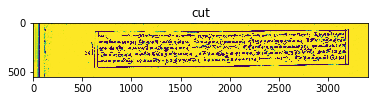

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/66-0.jpg !!!
[0, 720.3333333333334, 3405, 1289.6666666666667]


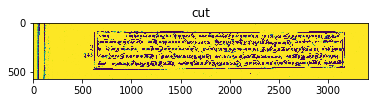

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/66-1.jpg !!!
[0, 1361.3333333333333, 3405, 1939.6666666666667]


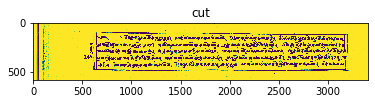

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/66-2.jpg !!!
[0, 2010.3333333333333, 3405, 2619.6666666666665]


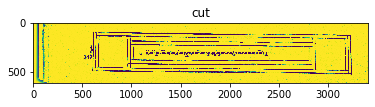

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/66-3.jpg !!!
67.jpg
(3627, 2574)
Processing 67


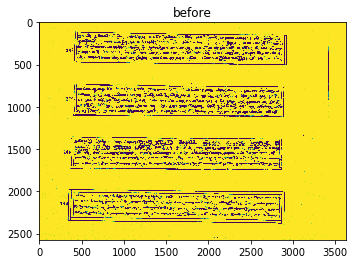

{1: 11, 3: 10, 4: 18, 2: 14}
threshold 3.497318366074211
[0, 96, 3627, 531]
[0, 711, 3627, 1142]
[0, 1332, 3627, 1771]
[0, 1952, 3627, 2400]
[0, 47.66666666666663, 3627, 597.6666666666666]


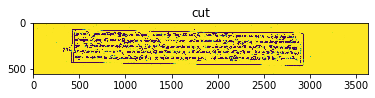

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/67-0.jpg !!!
[0, 644.3333333333334, 3627, 1208.6666666666667]


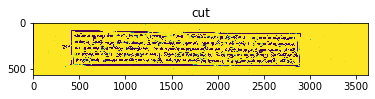

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/67-1.jpg !!!
[0, 1265.3333333333333, 3627, 1837.6666666666667]


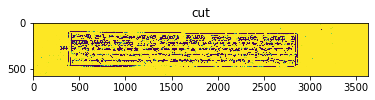

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/67-2.jpg !!!
[0, 1885.3333333333333, 3627, 2466.6666666666665]


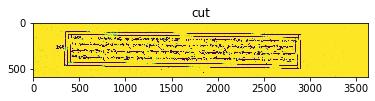

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/67-3.jpg !!!
68.jpg
(3523, 2605)
Processing 68


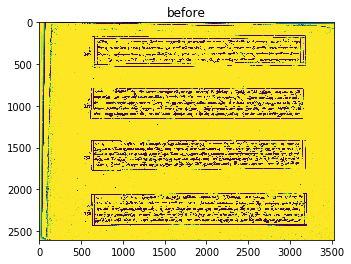

{4: 21, 3: 42, 2: 40, 1: 153}
threshold 4.363227598483806
[0, 131, 3523, 565]
[0, 760, 3523, 1190]
[0, 1386, 3523, 1799]
[0, 2018, 3523, 2459]
[0, 81.66666666666663, 3523, 631.6666666666666]


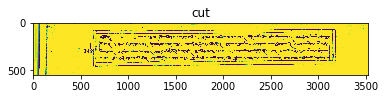

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/68-0.jpg !!!
[0, 693.3333333333334, 3523, 1256.6666666666667]


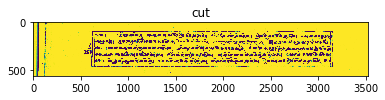

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/68-1.jpg !!!
[0, 1319.3333333333333, 3523, 1865.6666666666667]


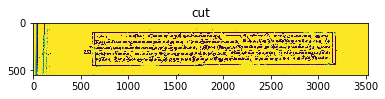

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/68-2.jpg !!!
[0, 1951.3333333333333, 3523, 2525.6666666666665]


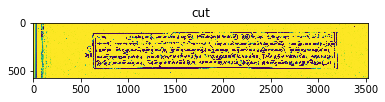

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/68-3.jpg !!!
69.jpg
(3411, 2571)
Processing 69


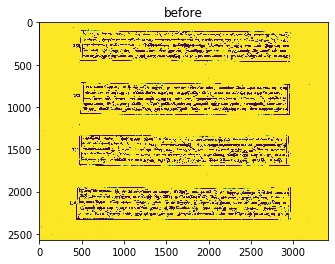

{1: 11, 4: 9, 3: 17, 2: 30}
threshold 4.642928786359075
[0, 79, 3411, 493]
[0, 693, 3411, 1123]
[0, 1309, 3411, 1727]
[0, 1924, 3411, 2363]
[0, 9.666666666666629, 3411, 559.6666666666666]


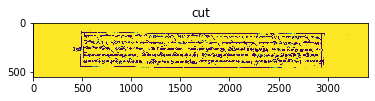

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/69-0.jpg !!!
[0, 626.3333333333334, 3411, 1189.6666666666667]


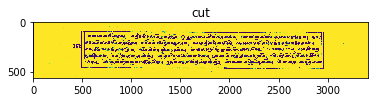

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/69-1.jpg !!!
[0, 1242.3333333333333, 3411, 1793.6666666666667]


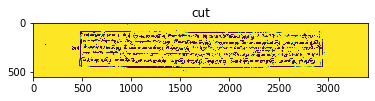

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/69-2.jpg !!!
[0, 1857.3333333333333, 3411, 2429.6666666666665]


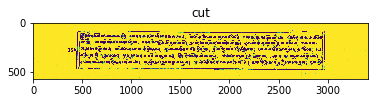

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/69-3.jpg !!!
7.jpg
(3505, 2659)
Processing 7


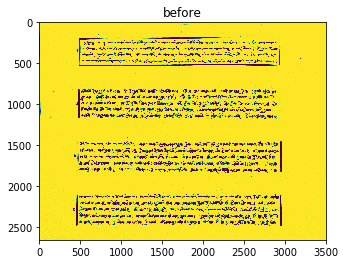

{1: 26, 3: 64, 2: 66, 4: 48}
threshold 1.5757137514025676
[0, 155, 3505, 562]
[0, 793, 3505, 1202]
[0, 1438, 3505, 1858]
[0, 2079, 3505, 2503]
[0, 78.66666666666663, 3505, 628.6666666666666]


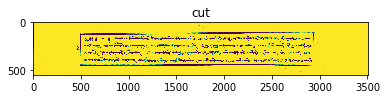

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/7-0.jpg !!!
[0, 726.3333333333334, 3505, 1268.6666666666667]


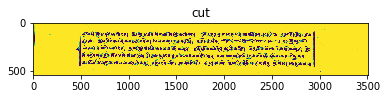

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/7-1.jpg !!!
[0, 1371.3333333333333, 3505, 1924.6666666666667]


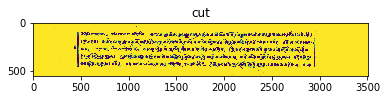

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/7-2.jpg !!!
[0, 2012.3333333333333, 3505, 2569.6666666666665]


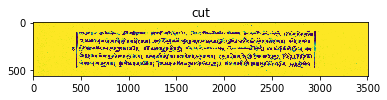

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/7-3.jpg !!!
70.jpg
(3523, 2614)
Processing 70


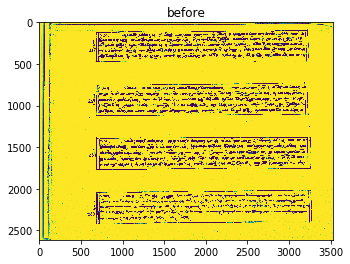

{3: 15, 1: 160, 2: 33, 4: 15}
threshold 3.5557417552905823
[0, 74, 3523, 501]
[0, 707, 3523, 1150]
[0, 1352, 3523, 1798]
[0, 1992, 3523, 2444]
[0, 17.66666666666663, 3523, 567.6666666666666]


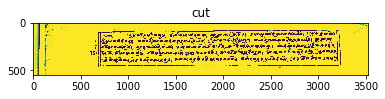

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/70-0.jpg !!!
[0, 640.3333333333334, 3523, 1216.6666666666667]


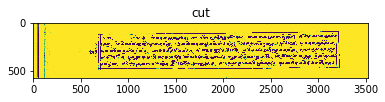

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/70-1.jpg !!!
[0, 1285.3333333333333, 3523, 1864.6666666666667]


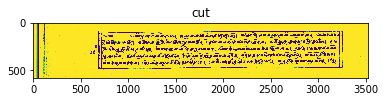

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/70-2.jpg !!!
[0, 1925.3333333333333, 3523, 2510.6666666666665]


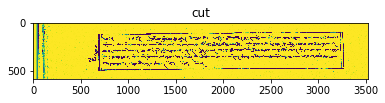

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/70-3.jpg !!!
71.jpg
(3412, 2570)
Processing 71


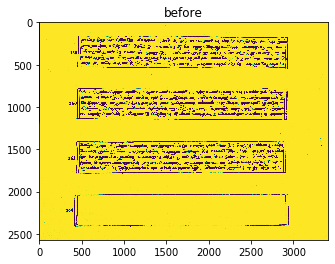

{1: 11, 4: 13, 3: 98, 2: 223}
threshold 1.2565021876519196
[0, 137, 3412, 571]
[0, 754, 3412, 1182]
[0, 1378, 3412, 1814]
[0, 2000, 3412, 2437]
[0, 87.66666666666663, 3412, 637.6666666666666]


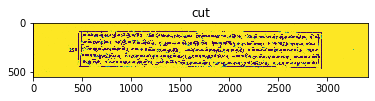

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/71-0.jpg !!!
[0, 687.3333333333334, 3412, 1248.6666666666667]


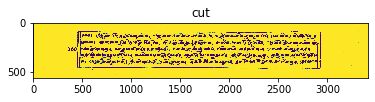

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/71-1.jpg !!!
[0, 1311.3333333333333, 3412, 1880.6666666666667]


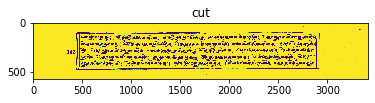

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/71-2.jpg !!!
[0, 1933.3333333333333, 3412, 2503.6666666666665]


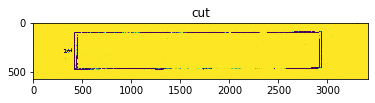

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/71-3.jpg !!!
72.jpg
(3470, 2608)
Processing 72


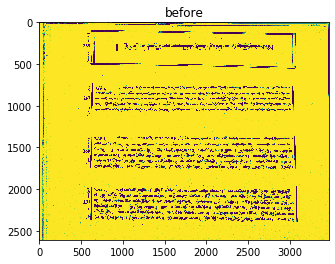

{2: 86, 1: 289, 4: 219, 3: 60}
threshold 3.5032076502732252
[0, 30, 3470, 576]
[0, 740, 3470, 1092]
[0, 1347, 3470, 1782]
[0, 1965, 3470, 2402]
[0, 30, 3470, 642.6666666666666]


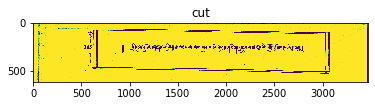

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/72-0.jpg !!!
[0, 673.3333333333334, 3470, 1158.6666666666667]


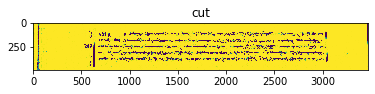

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/72-1.jpg !!!
[0, 1280.3333333333333, 3470, 1848.6666666666667]


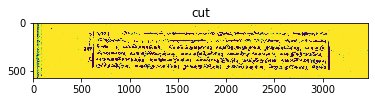

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/72-2.jpg !!!
[0, 1898.3333333333333, 3470, 2468.6666666666665]


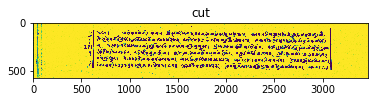

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/72-3.jpg !!!
73.jpg
(3394, 2573)
Processing 73


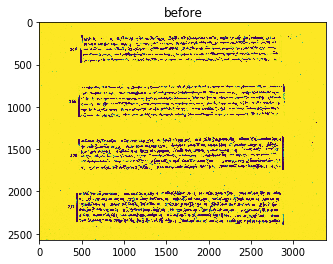

{1: 44, 2: 38, 3: 31, 4: 32}
threshold 3.5913400004338674
[0, 143, 3394, 489]
[0, 727, 3394, 1139]
[0, 1341, 3394, 1760]
[0, 1975, 3394, 2398]
[0, 5.666666666666629, 3394, 555.6666666666666]


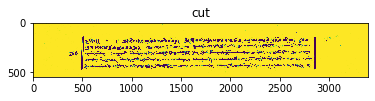

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/73-0.jpg !!!
[0, 660.3333333333334, 3394, 1205.6666666666667]


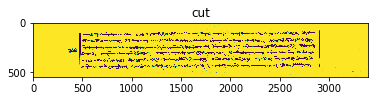

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/73-1.jpg !!!
[0, 1274.3333333333333, 3394, 1826.6666666666667]


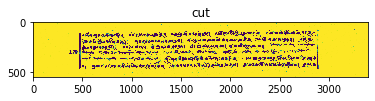

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/73-2.jpg !!!
[0, 1908.3333333333333, 3394, 2464.6666666666665]


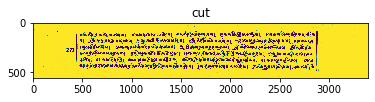

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/73-3.jpg !!!
74 (2).jpg
(3522, 2610)
Processing 74 (2)


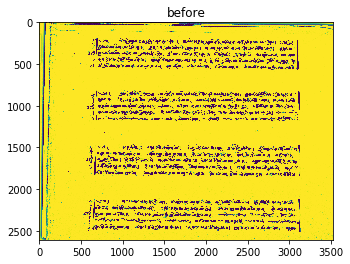

{1: 134, 2: 47, 3: 26, 4: 29}
threshold 3.4984129345831487
[0, 186, 3522, 585]
[0, 810, 3522, 1203]
[0, 1454, 3522, 1866]
[0, 2105, 3522, 2515]
[0, 101.66666666666663, 3522, 651.6666666666666]


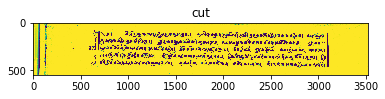

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/74 (2)-0.jpg !!!
[0, 743.3333333333334, 3522, 1269.6666666666667]


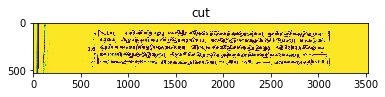

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/74 (2)-1.jpg !!!
[0, 1387.3333333333333, 3522, 1932.6666666666667]


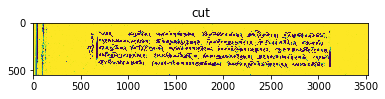

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/74 (2)-2.jpg !!!
[0, 2038.3333333333333, 3522, 2581.6666666666665]


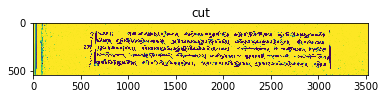

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/74 (2)-3.jpg !!!
75.jpg
(3393, 2568)
Processing 75


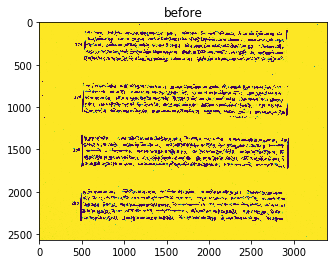

{1: 40, 2: 39, 3: 59, 4: 33}
threshold 4.606835254665729
[0, 87, 3393, 485]
[0, 713, 3393, 1121]
[0, 1330, 3393, 1725]
[0, 1958, 3393, 2360]
[0, 1.6666666666666288, 3393, 551.6666666666666]


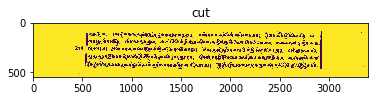

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/75-0.jpg !!!
[0, 646.3333333333334, 3393, 1187.6666666666667]


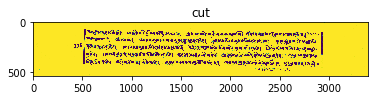

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/75-1.jpg !!!
[0, 1263.3333333333333, 3393, 1791.6666666666667]


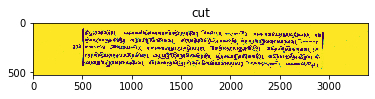

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/75-2.jpg !!!
[0, 1891.3333333333333, 3393, 2426.6666666666665]


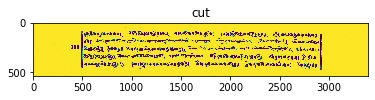

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/75-3.jpg !!!
76 (2).jpg
(3529, 2617)
Processing 76 (2)


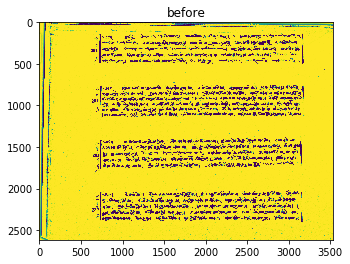

{4: 26, 2: 61, 1: 268, 3: 35}
threshold 4.551414008956627
[0, 126, 3529, 510]
[0, 742, 3529, 1154]
[0, 1378, 3529, 1770]
[0, 2015, 3529, 2407]
[0, 26.66666666666663, 3529, 576.6666666666666]


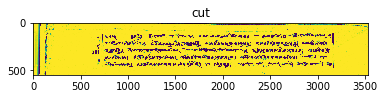

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/76 (2)-0.jpg !!!
[0, 675.3333333333334, 3529, 1220.6666666666667]


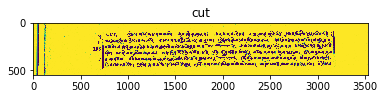

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/76 (2)-1.jpg !!!
[0, 1311.3333333333333, 3529, 1836.6666666666667]


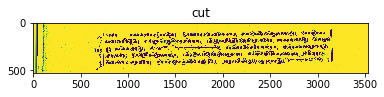

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/76 (2)-2.jpg !!!
[0, 1948.3333333333333, 3529, 2473.6666666666665]


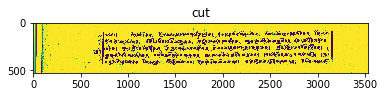

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/76 (2)-3.jpg !!!
77.jpg
(3420, 2569)
Processing 77


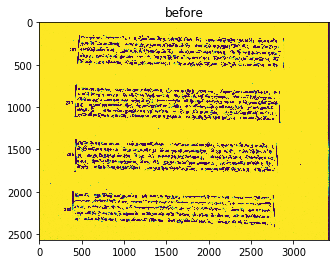

{3: 12, 1: 110, 2: 16, 4: 7}
threshold 4.39461904761905
[0, 147, 3420, 545]
[0, 757, 3420, 1175]
[0, 1394, 3420, 1782]
[0, 2003, 3420, 2402]
[0, 61.66666666666663, 3420, 611.6666666666666]


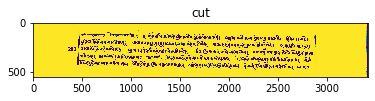

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/77-0.jpg !!!
[0, 690.3333333333334, 3420, 1241.6666666666667]


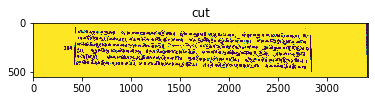

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/77-1.jpg !!!
[0, 1327.3333333333333, 3420, 1848.6666666666667]


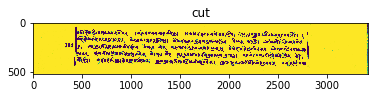

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/77-2.jpg !!!
[0, 1936.3333333333333, 3420, 2468.6666666666665]


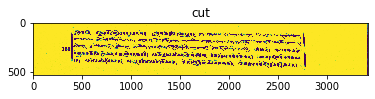

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/77-3.jpg !!!
78 (2).jpg
(3466, 2615)
Processing 78 (2)


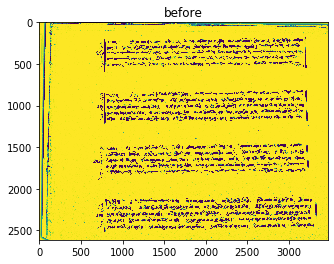

{2: 131, 1: 225, 3: 23, 4: 12}
threshold 4.474146421536439
[0, 180, 3466, 549]
[0, 809, 3466, 1206]
[0, 1443, 3466, 1840]
[0, 2086, 3466, 2507]
[0, 65.66666666666663, 3466, 615.6666666666666]


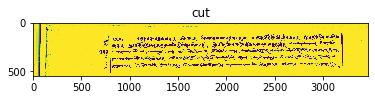

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/78 (2)-0.jpg !!!
[0, 742.3333333333334, 3466, 1272.6666666666667]


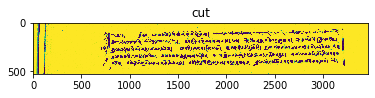

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/78 (2)-1.jpg !!!
[0, 1376.3333333333333, 3466, 1906.6666666666667]


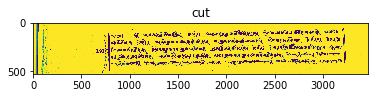

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/78 (2)-2.jpg !!!
[0, 2019.3333333333333, 3466, 2573.6666666666665]


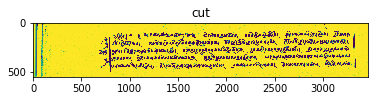

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/78 (2)-3.jpg !!!
79.jpg
(3397, 2563)
Processing 79


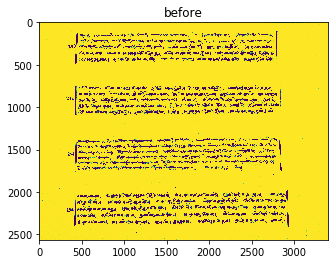

{2: 45, 1: 99, 3: 32, 4: 29}
threshold 4.369904903107735
[0, 111, 3397, 485]
[0, 732, 3397, 1104]
[0, 1345, 3397, 1759]
[0, 1987, 3397, 2397]
[0, 1.6666666666666288, 3397, 551.6666666666666]


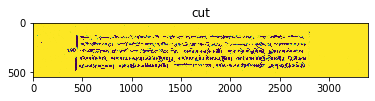

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/79-0.jpg !!!
[0, 665.3333333333334, 3397, 1170.6666666666667]


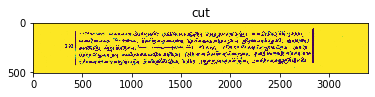

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/79-1.jpg !!!
[0, 1278.3333333333333, 3397, 1825.6666666666667]


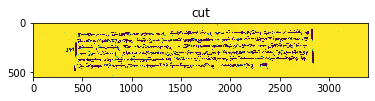

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/79-2.jpg !!!
[0, 1920.3333333333333, 3397, 2463.6666666666665]


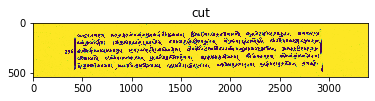

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/79-3.jpg !!!
8.jpg
(3355, 2518)
Processing 8


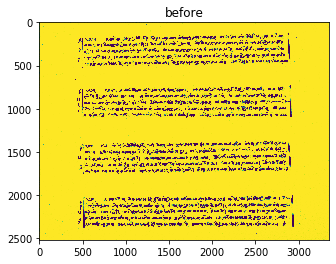

{4: 26, 2: 30, 1: 41, 3: 40}
threshold 4.406460490106143
[0, 125, 3355, 520]
[0, 734, 3355, 1117]
[0, 1364, 3355, 1761]
[0, 1995, 3355, 2384]
[0, 36.66666666666663, 3355, 586.6666666666666]


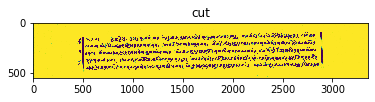

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/8-0.jpg !!!
[0, 667.3333333333334, 3355, 1183.6666666666667]


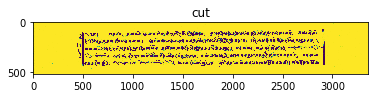

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/8-1.jpg !!!
[0, 1297.3333333333333, 3355, 1827.6666666666667]


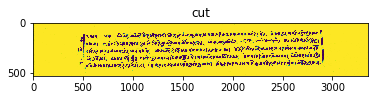

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/8-2.jpg !!!
[0, 1928.3333333333333, 3355, 2450.6666666666665]


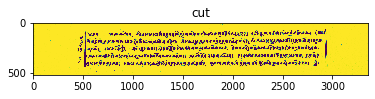

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/8-3.jpg !!!
80 (2).jpg
(3508, 2624)
Processing 80 (2)


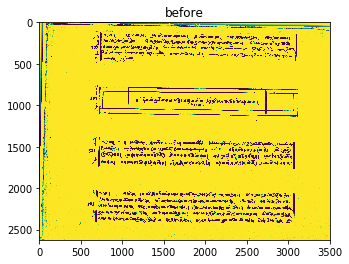

{3: 33, 1: 196, 2: 63, 4: 31}
threshold 4.551050894200236
[0, 121, 3508, 475]
[0, 759, 3508, 1157]
[0, 1409, 3508, 1749]
[0, 2026, 3508, 2437]
[0, 0, 3508, 541.6666666666666]


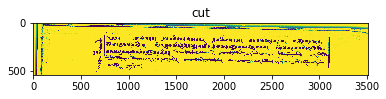

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/80 (2)-0.jpg !!!
[0, 692.3333333333334, 3508, 1223.6666666666667]


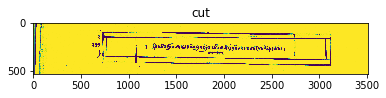

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/80 (2)-1.jpg !!!
[0, 1342.3333333333333, 3508, 1815.6666666666667]


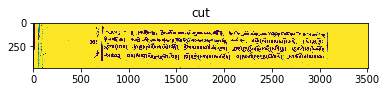

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/80 (2)-2.jpg !!!
[0, 1959.3333333333333, 3508, 2503.6666666666665]


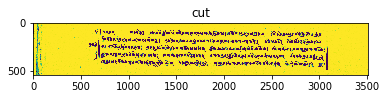

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/80 (2)-3.jpg !!!
81.jpg
(3397, 2557)
Processing 81


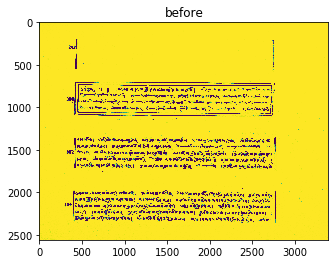

{1: 319, 2: 54, 3: 38, 4: 22}
threshold 4.453751488685986
[0, 678, 3397, 1131]
[0, 1340, 3397, 1740]
[0, 1964, 3397, 2359]
[0, 647.6666666666667, 3397, 1197.6666666666667]


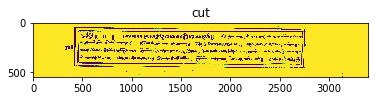

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/81-0.jpg !!!
[0, 1273.3333333333333, 3397, 1806.6666666666667]


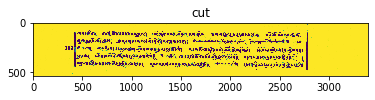

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/81-1.jpg !!!
[0, 1897.3333333333333, 3397, 2425.6666666666665]


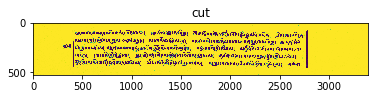

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/81-2.jpg !!!
82 (2).jpg
(3525, 2624)
Processing 82 (2)


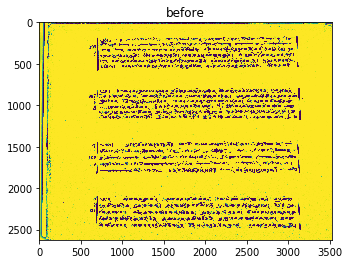

{2: 101, 1: 157, 3: 45, 4: 34}
threshold 4.5042246850431
[0, 162, 3525, 576]
[0, 784, 3525, 1189]
[0, 1425, 3525, 1834]
[0, 2079, 3525, 2503]
[0, 92.66666666666663, 3525, 642.6666666666666]


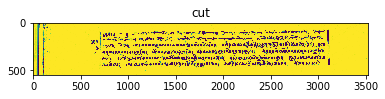

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/82 (2)-0.jpg !!!
[0, 717.3333333333334, 3525, 1255.6666666666667]


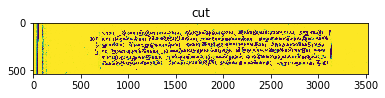

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/82 (2)-1.jpg !!!
[0, 1358.3333333333333, 3525, 1900.6666666666667]


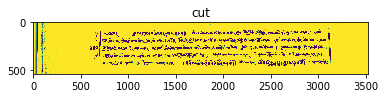

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/82 (2)-2.jpg !!!
[0, 2012.3333333333333, 3525, 2569.6666666666665]


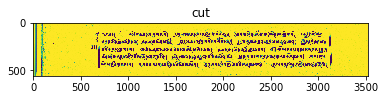

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/82 (2)-3.jpg !!!
83.jpg
(3397, 2562)
Processing 83


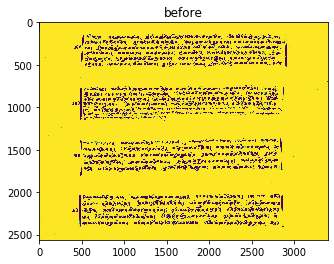

{1: 28, 2: 18, 3: 17, 4: 10}
threshold 4.543265031911321
[0, 125, 3397, 540]
[0, 739, 3397, 1154]
[0, 1357, 3397, 1768]
[0, 2009, 3397, 2410]
[0, 56.66666666666663, 3397, 606.6666666666666]


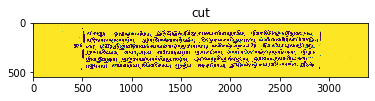

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/83-0.jpg !!!
[0, 672.3333333333334, 3397, 1220.6666666666667]


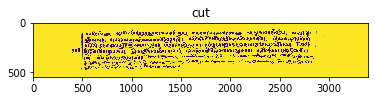

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/83-1.jpg !!!
[0, 1290.3333333333333, 3397, 1834.6666666666667]


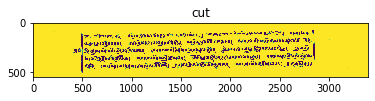

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/83-2.jpg !!!
[0, 1942.3333333333333, 3397, 2476.6666666666665]


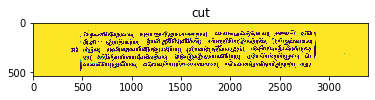

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/83-3.jpg !!!
84 (2).jpg
(3522, 2610)
Processing 84 (2)


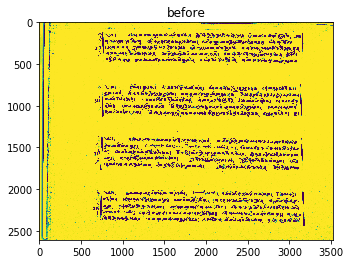

{2: 55, 1: 209, 4: 17, 3: 25}
threshold 4.402927902302122
[0, 108, 3522, 507]
[0, 738, 3522, 1147]
[0, 1366, 3522, 1784]
[0, 2002, 3522, 2423]
[0, 23.66666666666663, 3522, 573.6666666666666]


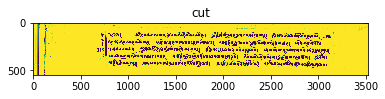

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/84 (2)-0.jpg !!!
[0, 671.3333333333334, 3522, 1213.6666666666667]


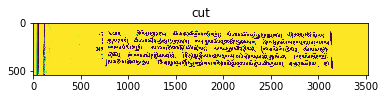

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/84 (2)-1.jpg !!!
[0, 1299.3333333333333, 3522, 1850.6666666666667]


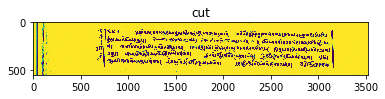

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/84 (2)-2.jpg !!!
[0, 1935.3333333333333, 3522, 2489.6666666666665]


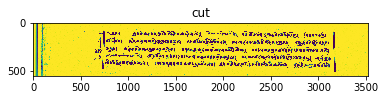

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/84 (2)-3.jpg !!!
85.jpg
(3420, 2566)
Processing 85


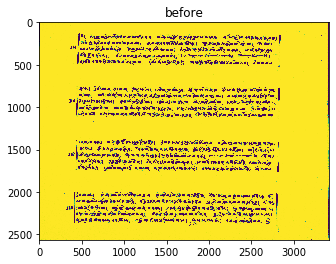

{4: 35, 1: 51, 3: 23, 2: 25}
threshold 3.4775217391304363
[0, 126, 3420, 523]
[0, 744, 3420, 1140]
[0, 1368, 3420, 1773]
[0, 1987, 3420, 2392]
[0, 39.66666666666663, 3420, 589.6666666666666]


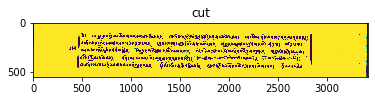

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/85-0.jpg !!!
[0, 677.3333333333334, 3420, 1206.6666666666667]


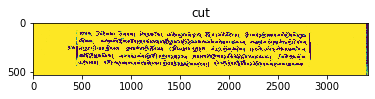

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/85-1.jpg !!!
[0, 1301.3333333333333, 3420, 1839.6666666666667]


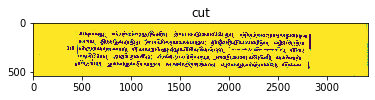

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/85-2.jpg !!!
[0, 1920.3333333333333, 3420, 2458.6666666666665]


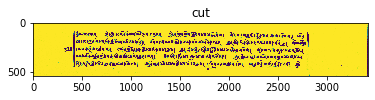

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/85-3.jpg !!!
86 (2).jpg
(3534, 2697)
Processing 86 (2)


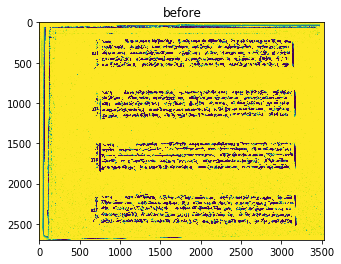

{1: 221, 3: 37, 2: 99, 4: 26}
threshold 4.599426905785287
[0, 191, 3534, 578]
[0, 825, 3534, 1206]
[0, 1470, 3534, 1847]
[0, 2117, 3534, 2519]
[0, 94.66666666666663, 3534, 644.6666666666666]


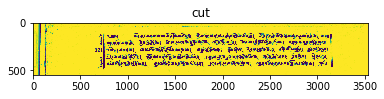

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/86 (2)-0.jpg !!!
[0, 758.3333333333334, 3534, 1272.6666666666667]


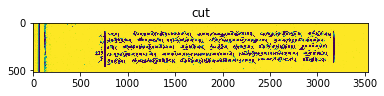

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/86 (2)-1.jpg !!!
[0, 1403.3333333333333, 3534, 1913.6666666666667]


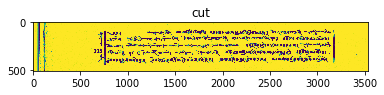

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/86 (2)-2.jpg !!!
[0, 2050.3333333333335, 3534, 2585.6666666666665]


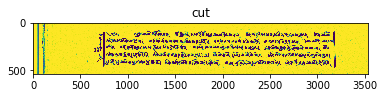

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/86 (2)-3.jpg !!!
87.jpg
(3418, 2561)
Processing 87


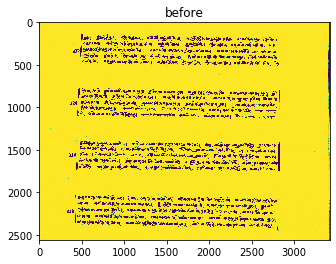

{1: 56, 2: 22, 3: 14, 4: 12}
threshold 4.598927062486102
[0, 142, 3418, 526]
[0, 771, 3418, 1144]
[0, 1389, 3418, 1763]
[0, 2025, 3418, 2425]
[0, 42.66666666666663, 3418, 592.6666666666666]


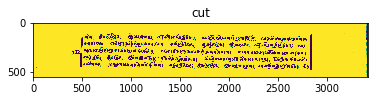

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/87-0.jpg !!!
[0, 704.3333333333334, 3418, 1210.6666666666667]


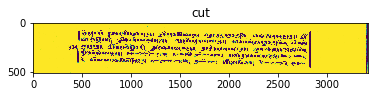

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/87-1.jpg !!!
[0, 1322.3333333333333, 3418, 1829.6666666666667]


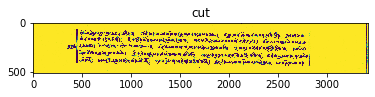

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/87-2.jpg !!!
[0, 1958.3333333333333, 3418, 2491.6666666666665]


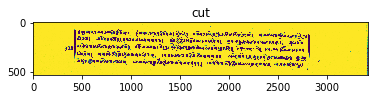

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/87-3.jpg !!!
88 (2).jpg
(3523, 2622)
Processing 88 (2)


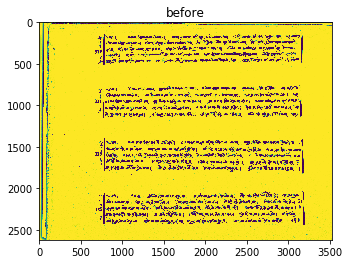

{4: 40, 2: 62, 1: 255, 3: 59}
threshold 4.519497260715435
[0, 132, 3523, 510]
[0, 756, 3523, 1161]
[0, 1404, 3523, 1810]
[0, 2039, 3523, 2448]
[0, 26.66666666666663, 3523, 576.6666666666666]


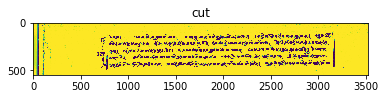

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/88 (2)-0.jpg !!!
[0, 689.3333333333334, 3523, 1227.6666666666667]


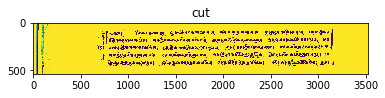

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/88 (2)-1.jpg !!!
[0, 1337.3333333333333, 3523, 1876.6666666666667]


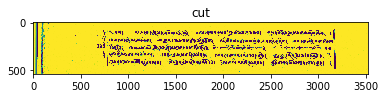

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/88 (2)-2.jpg !!!
[0, 1972.3333333333333, 3523, 2514.6666666666665]


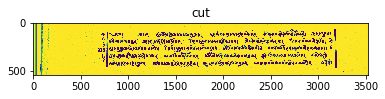

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/88 (2)-3.jpg !!!
89.jpg
(3426, 2559)
Processing 89


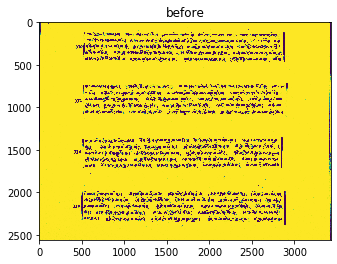

{1: 77, 2: 51, 3: 41, 4: 31}
threshold 4.480834030863006
[0, 106, 3426, 480]
[0, 713, 3426, 1103]
[0, 1344, 3426, 1729]
[0, 1968, 3426, 2364]
[0, 0, 3426, 546.6666666666666]


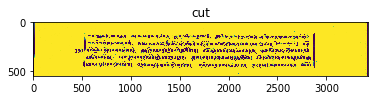

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/89-0.jpg !!!
[0, 646.3333333333334, 3426, 1169.6666666666667]


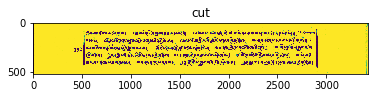

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/89-1.jpg !!!
[0, 1277.3333333333333, 3426, 1795.6666666666667]


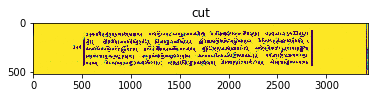

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/89-2.jpg !!!
[0, 1901.3333333333333, 3426, 2430.6666666666665]


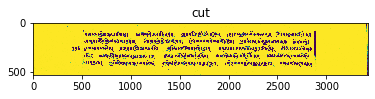

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/89-3.jpg !!!
9.jpg
(3502, 2661)
Processing 9


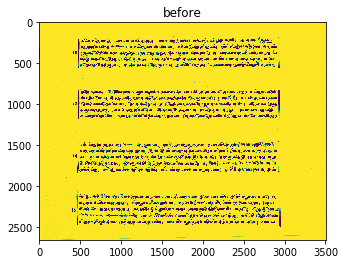

{1: 59, 2: 143, 3: 70, 4: 30}
threshold 4.5001189703655635
[0, 184, 3502, 573]
[0, 810, 3502, 1195]
[0, 1453, 3502, 1851]
[0, 2086, 3502, 2492]
[0, 89.66666666666663, 3502, 639.6666666666666]


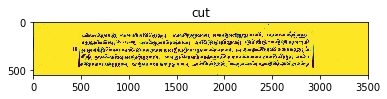

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/9-0.jpg !!!
[0, 743.3333333333334, 3502, 1261.6666666666667]


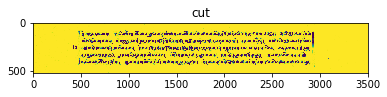

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/9-1.jpg !!!
[0, 1386.3333333333333, 3502, 1917.6666666666667]


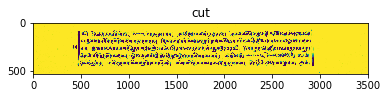

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/9-2.jpg !!!
[0, 2019.3333333333333, 3502, 2558.6666666666665]


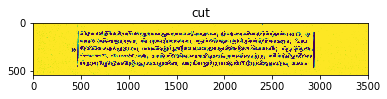

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/9-3.jpg !!!
90 (2).jpg
(3501, 2685)
Processing 90 (2)


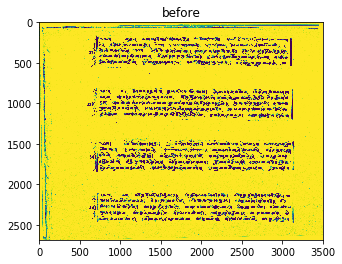

{1: 294, 2: 224, 3: 54, 4: 29}
threshold 4.589072065719819
[0, 164, 3501, 555]
[0, 805, 3501, 1199]
[0, 1445, 3501, 1854]
[0, 2085, 3501, 2477]
[0, 71.66666666666663, 3501, 621.6666666666666]


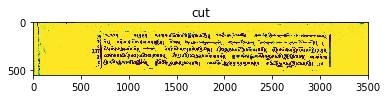

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/90 (2)-0.jpg !!!
[0, 738.3333333333334, 3501, 1265.6666666666667]


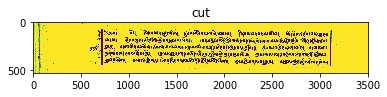

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/90 (2)-1.jpg !!!
[0, 1378.3333333333333, 3501, 1920.6666666666667]


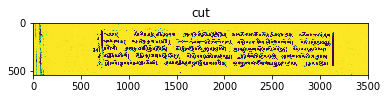

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/90 (2)-2.jpg !!!
[0, 2018.3333333333333, 3501, 2543.6666666666665]


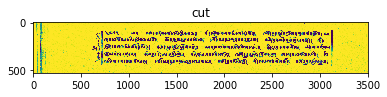

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/90 (2)-3.jpg !!!
91.jpg
(3381, 2596)
Processing 91


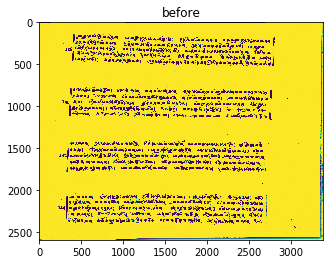

{1: 23, 2: 30, 3: 26, 4: 15}
threshold 4.502375323651919
[0, 138, 3381, 534]
[0, 769, 3381, 1160]
[0, 1403, 3381, 1795]
[0, 2034, 3381, 2417]
[0, 50.66666666666663, 3381, 600.6666666666666]


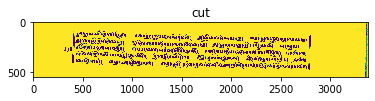

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/91-0.jpg !!!
[0, 702.3333333333334, 3381, 1226.6666666666667]


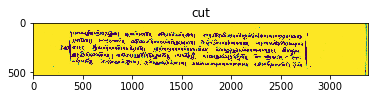

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/91-1.jpg !!!
[0, 1336.3333333333333, 3381, 1861.6666666666667]


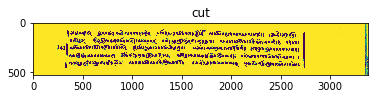

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/91-2.jpg !!!
[0, 1967.3333333333333, 3381, 2483.6666666666665]


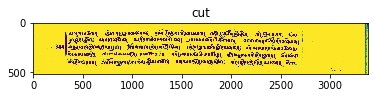

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/91-3.jpg !!!
92.jpg
(3451, 2620)
Processing 92


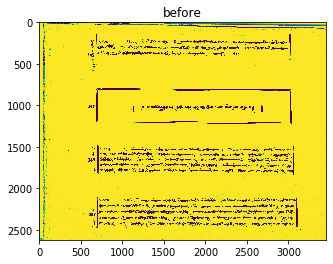

{3: 86, 2: 179, 1: 445, 4: 35}
threshold 4.408389498986663
[0, 191, 3451, 429]
[0, 1489, 3451, 1830]
[0, 2097, 3451, 2473]
[0, 0, 3451, 495.6666666666667]


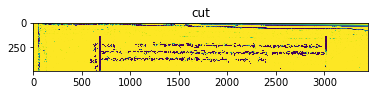

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/92-0.jpg !!!
[0, 1422.3333333333333, 3451, 1896.6666666666667]


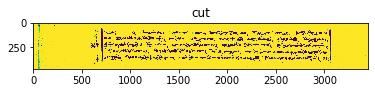

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/92-1.jpg !!!
[0, 2030.3333333333333, 3451, 2539.6666666666665]


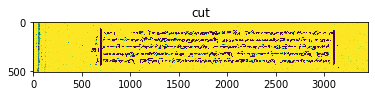

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/92-2.jpg !!!
93.jpg
(3445, 2575)
Processing 93


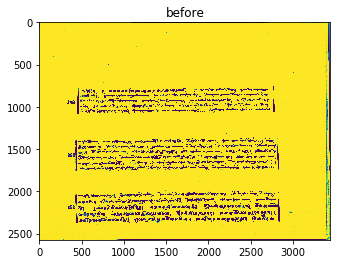

{4: 10, 1: 35, 2: 17, 3: 9}
threshold 3.4371717171717204
[0, 761, 3445, 1090]
[0, 1357, 3445, 1770]
[0, 1985, 3445, 2387]
[0, 606.6666666666667, 3445, 1156.6666666666667]


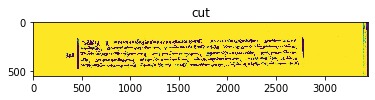

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/93-0.jpg !!!
[0, 1290.3333333333333, 3445, 1836.6666666666667]


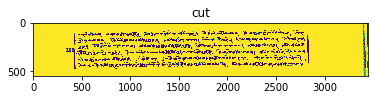

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/93-1.jpg !!!
[0, 1918.3333333333333, 3445, 2453.6666666666665]


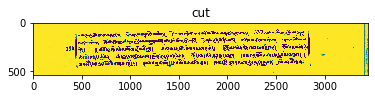

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/93-2.jpg !!!
94 (2).jpg
(3520, 2627)
Processing 94 (2)


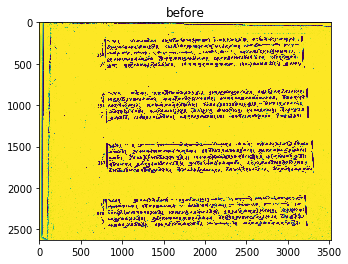

{2: 48, 1: 194, 3: 21, 4: 20}
threshold 4.662935483870969
[0, 167, 3520, 567]
[0, 797, 3520, 1196]
[0, 1426, 3520, 1832]
[0, 2085, 3520, 2491]
[0, 83.66666666666663, 3520, 633.6666666666666]


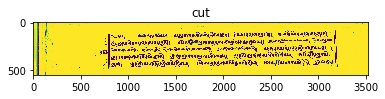

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/94 (2)-0.jpg !!!
[0, 730.3333333333334, 3520, 1262.6666666666667]


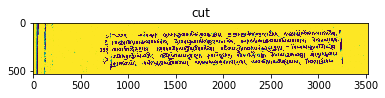

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/94 (2)-1.jpg !!!
[0, 1359.3333333333333, 3520, 1898.6666666666667]


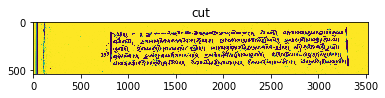

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/94 (2)-2.jpg !!!
[0, 2018.3333333333333, 3520, 2557.6666666666665]


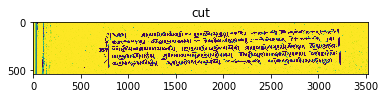

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/94 (2)-3.jpg !!!
95.jpg
(3400, 2620)
Processing 95


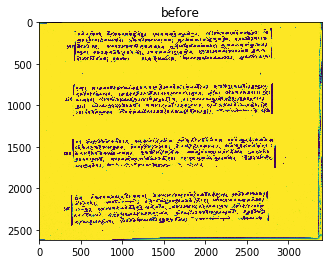

{4: 22, 2: 25, 1: 54, 3: 23}
threshold 4.495012202562536
[0, 87, 3400, 485]
[0, 731, 3400, 1126]
[0, 1372, 3400, 1766]
[0, 2026, 3400, 2439]
[0, 1.6666666666666288, 3400, 551.6666666666666]


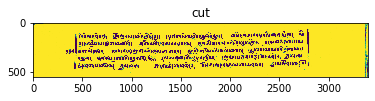

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/95-0.jpg !!!
[0, 664.3333333333334, 3400, 1192.6666666666667]


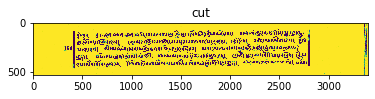

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/95-1.jpg !!!
[0, 1305.3333333333333, 3400, 1832.6666666666667]


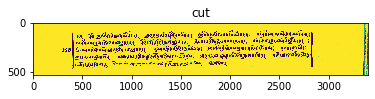

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/95-2.jpg !!!
[0, 1959.3333333333333, 3400, 2505.6666666666665]


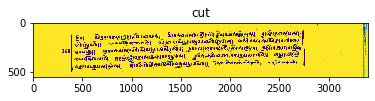

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/95-3.jpg !!!
96 (2).jpg
(3522, 2630)
Processing 96 (2)


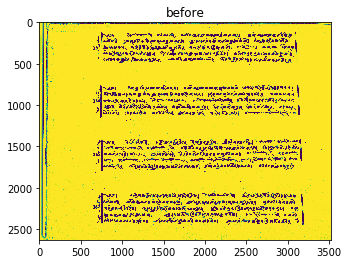

{2: 57, 1: 269, 3: 16, 4: 32}
threshold 3.573259187620886
[0, 107, 3522, 507]
[0, 744, 3522, 1149]
[0, 1393, 3522, 1800]
[0, 2039, 3522, 2458]
[0, 23.66666666666663, 3522, 573.6666666666666]


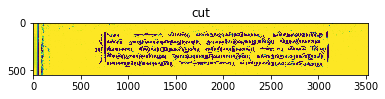

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/96 (2)-0.jpg !!!
[0, 677.3333333333334, 3522, 1215.6666666666667]


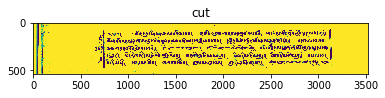

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/96 (2)-1.jpg !!!
[0, 1326.3333333333333, 3522, 1866.6666666666667]


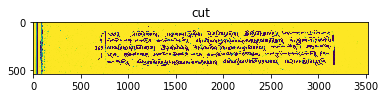

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/96 (2)-2.jpg !!!
[0, 1972.3333333333333, 3522, 2524.6666666666665]


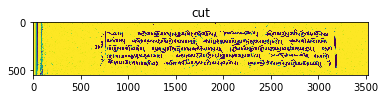

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/96 (2)-3.jpg !!!
98 (2).jpg
(3522, 2609)
Processing 98 (2)


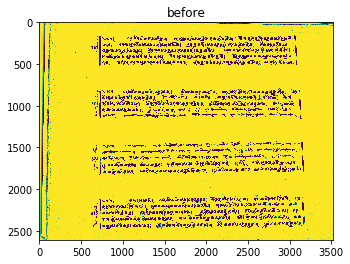

{2: 29, 1: 159, 3: 23, 4: 26}
threshold 3.4675384744764948
[0, 146, 3522, 535]
[0, 786, 3522, 1162]
[0, 1421, 3522, 1835]
[0, 2067, 3522, 2490]
[0, 51.66666666666663, 3522, 601.6666666666666]


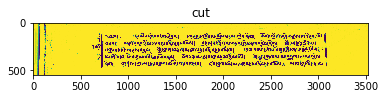

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/98 (2)-0.jpg !!!
[0, 719.3333333333334, 3522, 1228.6666666666667]


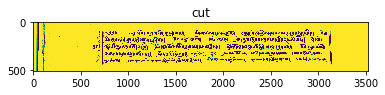

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/98 (2)-1.jpg !!!
[0, 1354.3333333333333, 3522, 1901.6666666666667]


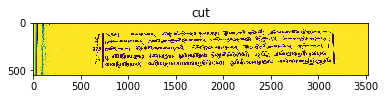

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/98 (2)-2.jpg !!!
[0, 2000.3333333333333, 3522, 2556.6666666666665]


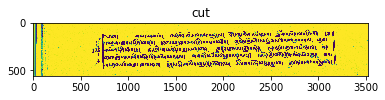

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/98 (2)-3.jpg !!!
99(2).jpg
(3409, 2592)
Processing 99(2)


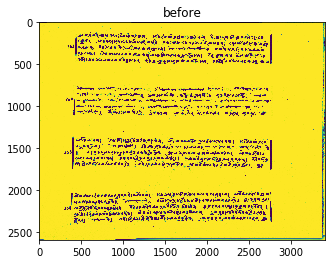

{1: 46, 2: 57, 3: 28, 4: 24}
threshold 4.558074049291849
[0, 120, 3409, 513]
[0, 754, 3409, 1128]
[0, 1365, 3409, 1746]
[0, 2003, 3409, 2397]
[0, 29.66666666666663, 3409, 579.6666666666666]


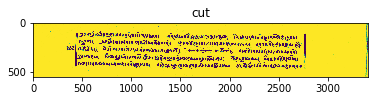

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/99(2)-0.jpg !!!
[0, 687.3333333333334, 3409, 1194.6666666666667]


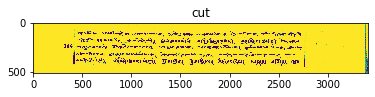

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/99(2)-1.jpg !!!
[0, 1298.3333333333333, 3409, 1812.6666666666667]


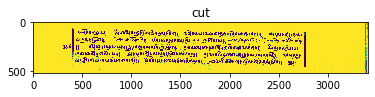

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/99(2)-2.jpg !!!
[0, 1936.3333333333333, 3409, 2463.6666666666665]


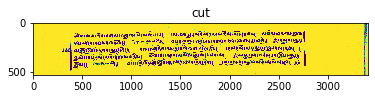

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/99(2)-3.jpg !!!
99.jpg
(3449, 2561)
Processing 99


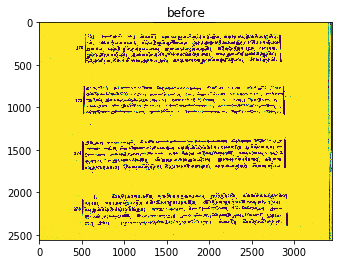

{2: 52, 1: 14, 4: 30, 3: 37}
threshold 1.6291326699052036
[0, 116, 3449, 507]
[0, 727, 3449, 1102]
[0, 1354, 3449, 1759]
[0, 1987, 3449, 2414]
[0, 23.66666666666663, 3449, 573.6666666666666]


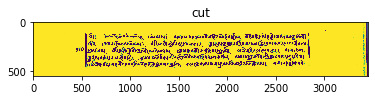

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/99-0.jpg !!!
[0, 660.3333333333334, 3449, 1168.6666666666667]


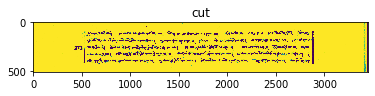

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/99-1.jpg !!!
[0, 1287.3333333333333, 3449, 1825.6666666666667]


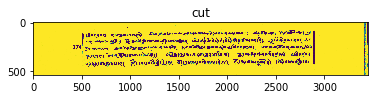

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/99-2.jpg !!!
[0, 1920.3333333333333, 3449, 2480.6666666666665]


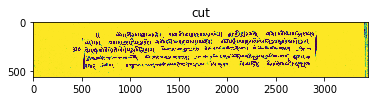

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/99-3.jpg !!!
Copy of 1.jpg
(3503, 2656)
Processing Copy of 1


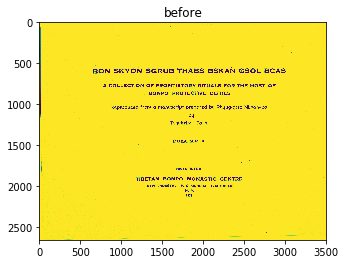

{1: 55, 3: 43, 2: 78, 4: 7}
threshold 4.280153839025071
[0, 730, 3503, 909]
[0, 1868, 3503, 2036]
[0, 425.66666666666663, 3503, 975.6666666666666]


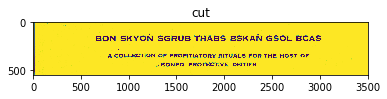

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/Copy of 1-0.jpg !!!
[0, 1801.3333333333333, 3503, 2102.6666666666665]


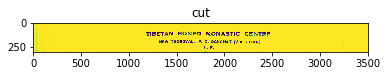

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/Copy of 1-1.jpg !!!
Copy of 1 Failed
Copy of 2.jpg
(3557, 2580)
Processing Copy of 2


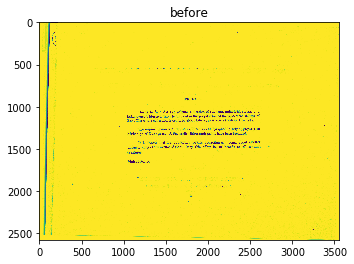

{1: 80, 2: 81, 4: 33, 3: 29}
threshold 3.566739582073802
[0, 1028, 3557, 1204]
[0, 1028, 3557, 1204]


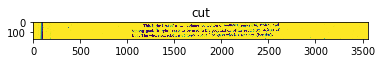

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/Copy of 2-0.jpg !!!
Copy of 2 Failed
Copy of 3.jpg
(3489, 2665)
Processing Copy of 3


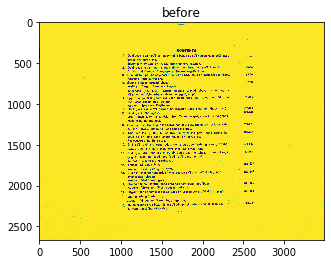

{2: 86, 4: 84, 3: 68, 1: 89}
threshold 3.4960947233243265
[0, 322, 3489, 2315]
[0, 322, 3489, 2315]


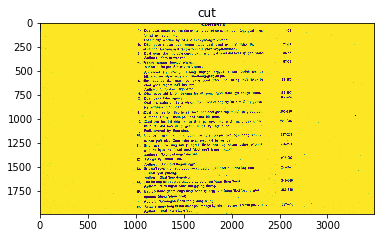

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/Copy of 3-0.jpg !!!
Copy of 3 Failed
Copy of 4.jpg
(3512, 2500)
Processing Copy of 4


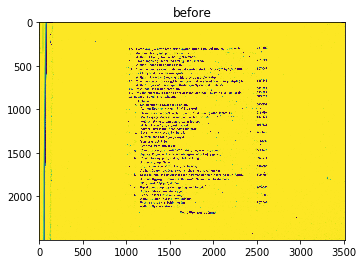

{2: 78, 3: 71, 4: 91, 1: 77}
threshold 3.5395659858243906
[0, 272, 3512, 894]
[0, 914, 3512, 2146]
[0, 272, 3512, 907.3333333333334]


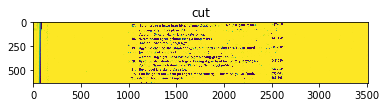

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/Copy of 4-0.jpg !!!
[0, 900.6666666666666, 3512, 2159.3333333333335]


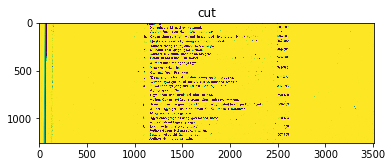

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/Copy of 4-1.jpg !!!
Copy of 4 Failed


In [0]:
# for all images in the image list, call crop()
# image_list = ["image00072 .jpg"]
for image_name in image_list:
  print(image_name)
  im = Image.open(image_name)
  print(im.size)
  crop(im, image_name[:-4], False)

In [0]:
print(failed_list)

['5', 'Copy of 1', 'Copy of 2', 'Copy of 3', 'Copy of 4']


['133.jpg', '22.jpg', '52.jpg', '92.jpg', '103.jpg', '126 (2).jpg', '132 (2).jpg']
133.jpg
(3399, 2570)
Processing 133


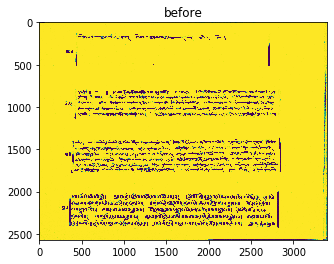

{2: 128, 1: 239, 3: 35, 4: 23}
[0, 136, 3399, 519]
[0, 778, 3399, 1134]
[0, 1369, 3399, 1777]
[0, 2008, 3399, 2418]
[0, 35.66666666666663, 3399, 585.6666666666666]


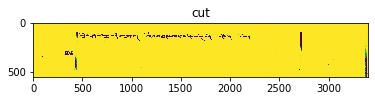

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/133-0.jpg !!!
[0, 711.3333333333334, 3399, 1200.6666666666667]


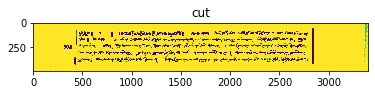

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/133-1.jpg !!!
[0, 1302.3333333333333, 3399, 1843.6666666666667]


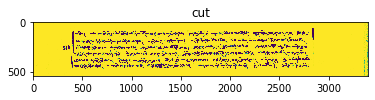

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/133-2.jpg !!!
[0, 1941.3333333333333, 3399, 2484.6666666666665]


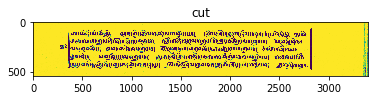

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/133-3.jpg !!!
22.jpg
(3597, 2595)
Processing 22


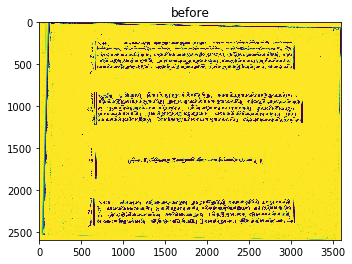

{4: 32, 1: 197, 2: 324, 3: 69}
[0, 215, 3597, 588]
[0, 831, 3597, 1224]
[0, 1484, 3597, 1867]
[0, 2091, 3597, 2590]
[0, 104.66666666666663, 3597, 654.6666666666666]


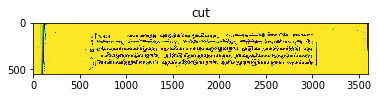

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/22-0.jpg !!!
[0, 764.3333333333334, 3597, 1290.6666666666667]


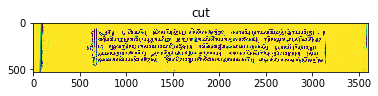

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/22-1.jpg !!!
[0, 1417.3333333333333, 3597, 1933.6666666666667]


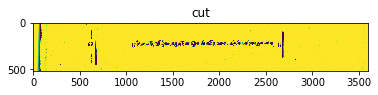

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/22-2.jpg !!!
[0, 2024.3333333333333, 3597, 2594.0]


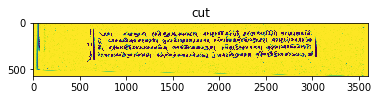

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/22-3.jpg !!!
52.jpg
(3479, 2606)
Processing 52


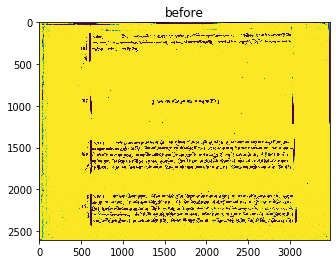

{3: 66, 1: 634, 2: 186, 4: 41}
[0, 56, 3479, 469]
[0, 735, 3479, 1160]
[0, 1396, 3479, 1798]
[0, 2043, 3479, 2480]
[0, 0, 3479, 535.6666666666666]


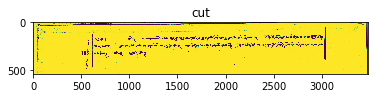

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/52-0.jpg !!!
[0, 668.3333333333334, 3479, 1226.6666666666667]


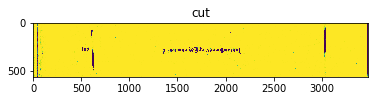

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/52-1.jpg !!!
[0, 1329.3333333333333, 3479, 1864.6666666666667]


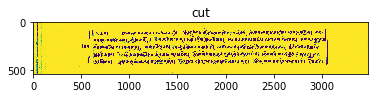

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/52-2.jpg !!!
[0, 1976.3333333333333, 3479, 2546.6666666666665]


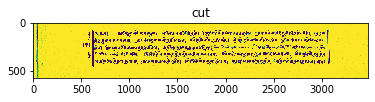

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/52-3.jpg !!!
92.jpg
(3451, 2620)
Processing 92


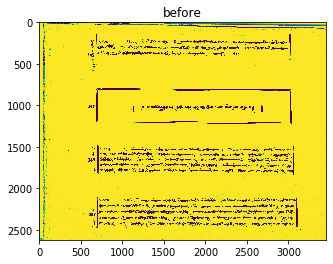

{3: 86, 2: 179, 1: 445, 4: 35}
[0, 139, 3451, 521]
[0, 792, 3451, 1231]
[0, 1488, 3451, 1835]
[0, 2096, 3451, 2476]
[0, 37.66666666666663, 3451, 587.6666666666666]


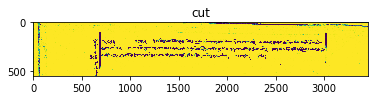

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/92-0.jpg !!!
[0, 725.3333333333334, 3451, 1297.6666666666667]


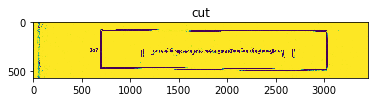

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/92-1.jpg !!!
[0, 1421.3333333333333, 3451, 1901.6666666666667]


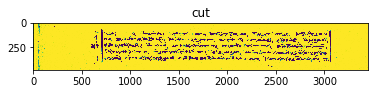

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/92-2.jpg !!!
[0, 2029.3333333333333, 3451, 2542.6666666666665]


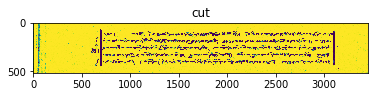

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/92-3.jpg !!!
103.jpg
(3411, 2603)
Processing 103


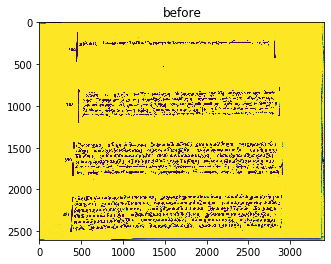

{4: 13, 2: 119, 1: 261, 3: 14}
[0, 112, 3411, 435]
[0, 775, 3411, 1177]
[0, 1426, 3411, 1840]
[0, 2057, 3411, 2507]
[0, 0, 3411, 501.6666666666667]


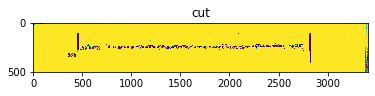

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/103-0.jpg !!!
[0, 708.3333333333334, 3411, 1243.6666666666667]


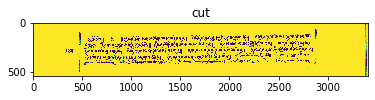

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/103-1.jpg !!!
[0, 1359.3333333333333, 3411, 1906.6666666666667]


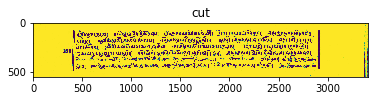

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/103-2.jpg !!!
[0, 1990.3333333333333, 3411, 2573.6666666666665]


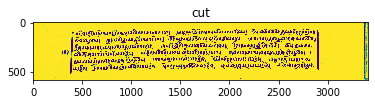

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/103-3.jpg !!!
126 (2).jpg
(3451, 2646)
Processing 126 (2)


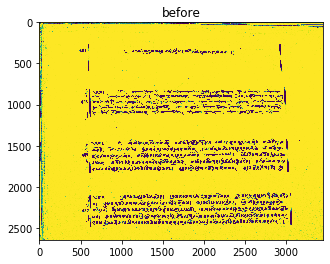

{3: 32, 1: 327, 2: 215, 4: 23}
[0, 271, 3451, 603]
[0, 794, 3451, 1158]
[0, 1416, 3451, 1835]
[0, 2068, 3451, 2500]
[0, 119.66666666666663, 3451, 669.6666666666666]


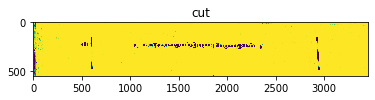

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/126 (2)-0.jpg !!!
[0, 727.3333333333334, 3451, 1224.6666666666667]


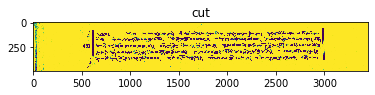

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/126 (2)-1.jpg !!!
[0, 1349.3333333333333, 3451, 1901.6666666666667]


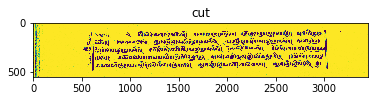

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/126 (2)-2.jpg !!!
[0, 2001.3333333333333, 3451, 2566.6666666666665]


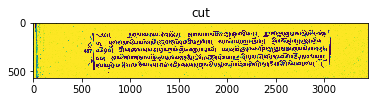

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/126 (2)-3.jpg !!!
132 (2).jpg
(3508, 2649)
Processing 132 (2)


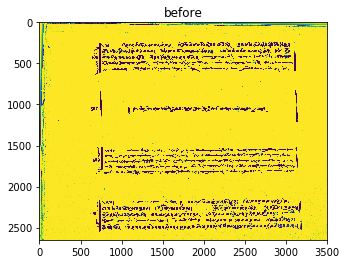

{2: 315, 1: 218, 3: 47, 4: 27}
[0, 235, 3508, 618]
[0, 834, 3508, 1225]
[0, 1523, 3508, 1871]
[0, 2122, 3508, 2644]
[0, 134.66666666666663, 3508, 684.6666666666666]


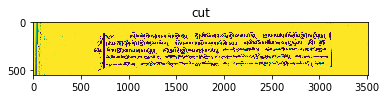

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/132 (2)-0.jpg !!!
[0, 767.3333333333334, 3508, 1291.6666666666667]


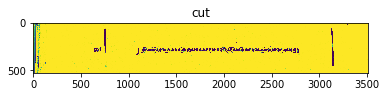

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/132 (2)-1.jpg !!!
[0, 1456.3333333333333, 3508, 1937.6666666666667]


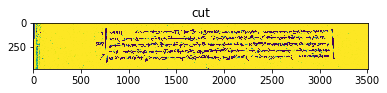

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/132 (2)-2.jpg !!!
[0, 2055.3333333333335, 3508, 2648.0]


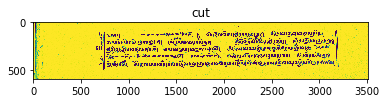

Saved Image as ../../Tibetan-Cropped/Bon-Skyon-Vol-1/132 (2)-3.jpg !!!


In [0]:
threshold = 1
rows = 3
failed_list = ["133.jpg", "22.jpg", "52.jpg", "92.jpg","103.jpg", "126 (2).jpg", "132 (2).jpg"]
print(failed_list)
for image_name in failed_list:
  print(image_name)
  im = Image.open(image_name)
  print(im.size)
  crop(im, image_name[:-4], threshold)